In [1]:
import numpy as np
import matplotlib.pyplot as plt
import sklearn.metrics as metrics
import tensorflow as tf
from tensorflow.keras import backend as K

from SupervisedAD_methods import *

## Data

In [2]:
ratio = 0.75
data = generate_data(100, ratio=ratio, seed=0)

data.shape

(100, 3)

In [3]:
data_test = generate_data(100, ratio=ratio, fake_r=0.5, seed=100)

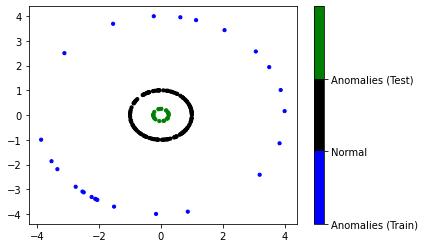

In [4]:
X = data[:, :-1]
y = data[:, -1]
x_test = data_test[:, :-1]
y_test = data_test[:, -1]

# for plotting: visualise 2 different OOD classes
y_test_transform = np.abs((y_test-1))+1

import matplotlib
x_plot = np.vstack((X, x_test))
colours = ["blue", "black", "green"]
plt.scatter(x_plot[:, 0], x_plot[:, 1], c=np.hstack((y, y_test_transform)),
            cmap=matplotlib.colors.ListedColormap(colours), s=10)
cb = plt.colorbar()
loc = np.arange(0, 2, 2/float(len(colours)))
cb.set_ticks(loc)
cb.set_ticklabels(["Anomalies (Train)", "Normal", "Anomalies (Test)"])
plt.show()

In [5]:
lim = 2.25
grid = int(lim*100*2)
a = np.linspace(-lim, lim, grid)
xv, yv = np.meshgrid(a, a)
data_viz = np.hstack((xv.reshape(-1, 1), yv.reshape(-1, 1)))

radius_sq = (data_viz ** 2).sum(axis=1)
radius2 = (np.abs(radius_sq - 4) < 1e-1).reshape(grid, grid)
radius1 = (np.abs(radius_sq - 1) < 5e-2).reshape(grid, grid)
radius05 = (np.abs(radius_sq - 0.25) < 3e-2).reshape(grid, grid)

xv.shape, data_viz.shape

((450, 450), (202500, 2))

# Training Neural Networks with 2 Hidden Layers

## Halfspace Separation

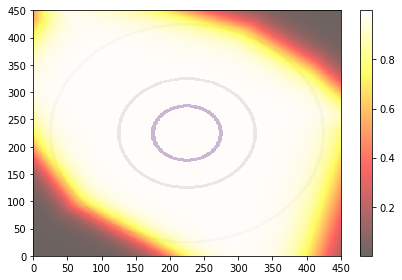

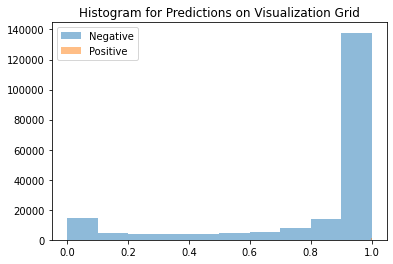

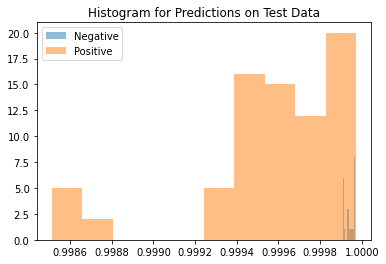

Average Difference between Positive and Negative Class: -0.0003693103790283203


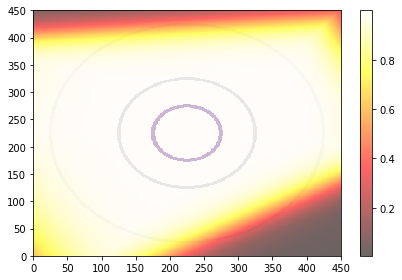

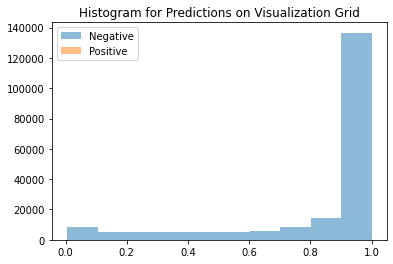

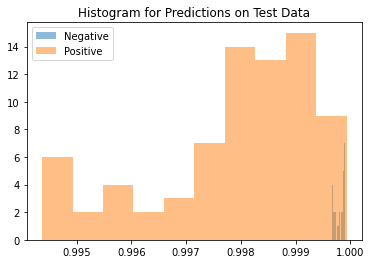

Average Difference between Positive and Negative Class: -0.0019017457962036133


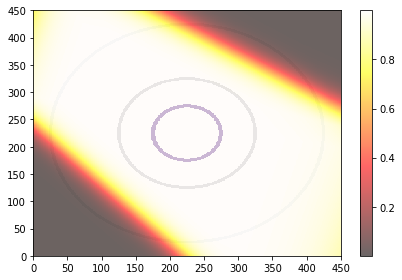

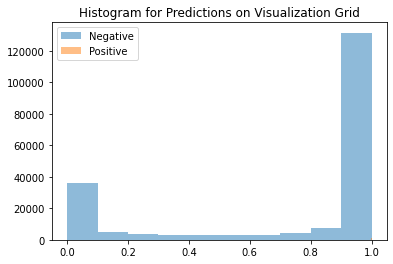

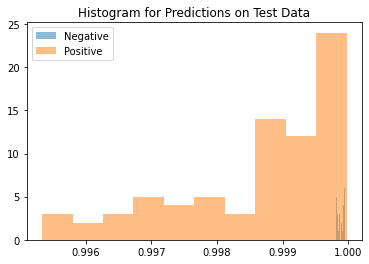

Average Difference between Positive and Negative Class: -0.0012295842170715332


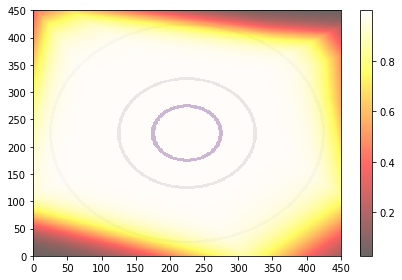

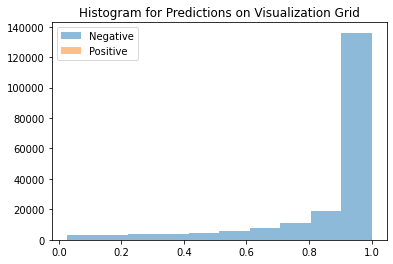

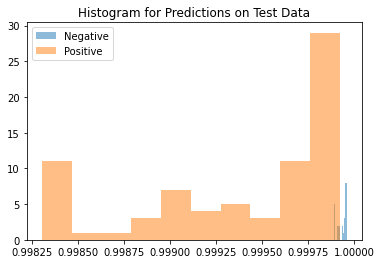

Average Difference between Positive and Negative Class: -0.0005434155464172363


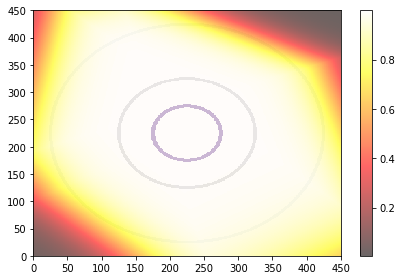

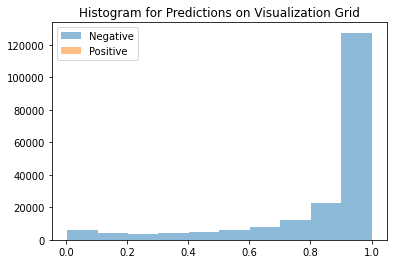

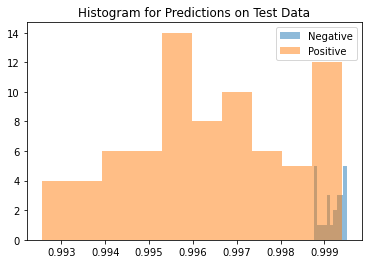

Average Difference between Positive and Negative Class: -0.002767622470855713


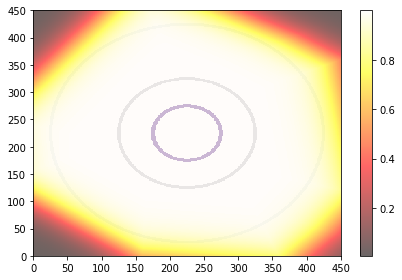

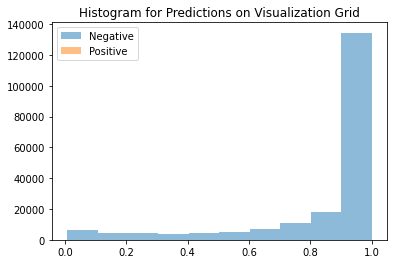

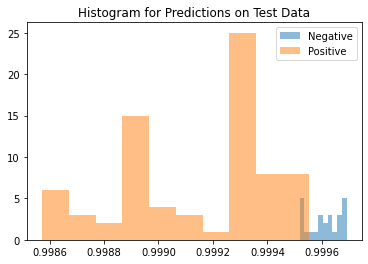

Average Difference between Positive and Negative Class: -0.00047284364700317383


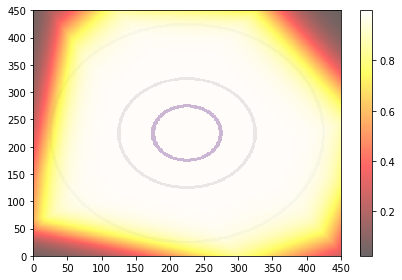

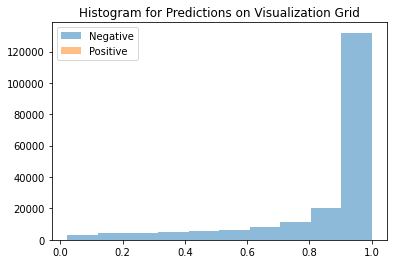

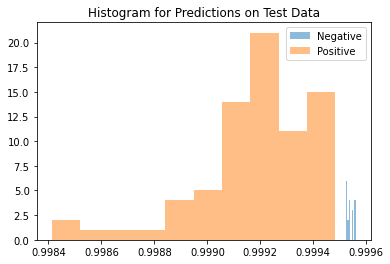

Average Difference between Positive and Negative Class: -0.0003660917282104492


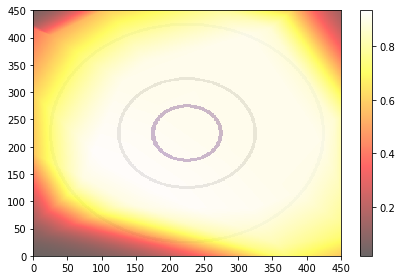

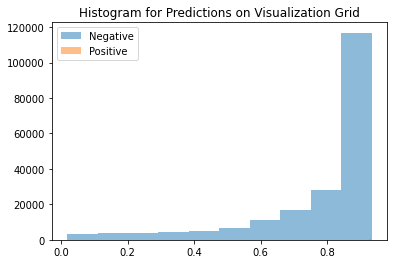

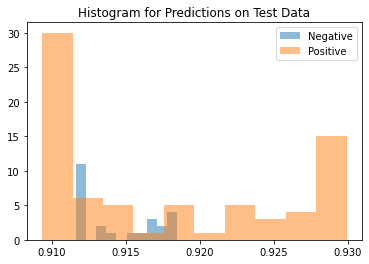

Average Difference between Positive and Negative Class: 0.0032092928886413574


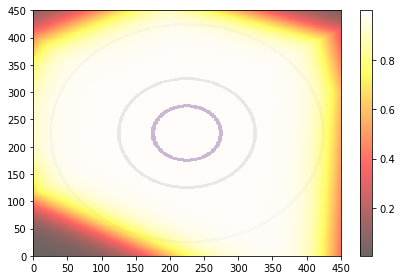

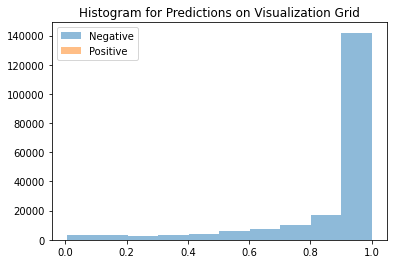

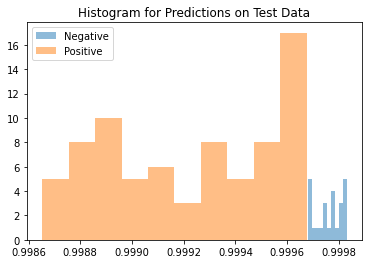

Average Difference between Positive and Negative Class: -0.0005403757095336914


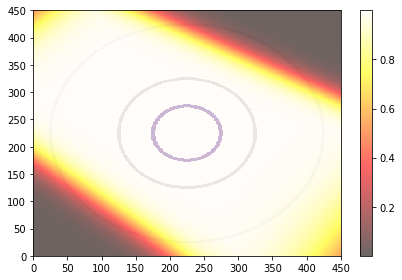

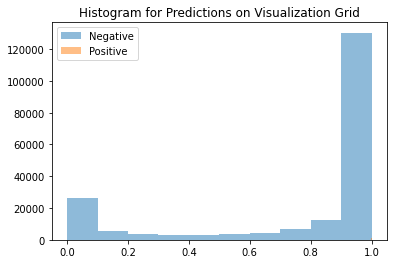

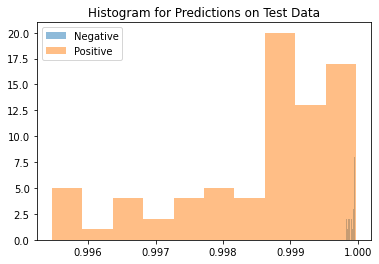

Average Difference between Positive and Negative Class: -0.001316368579864502


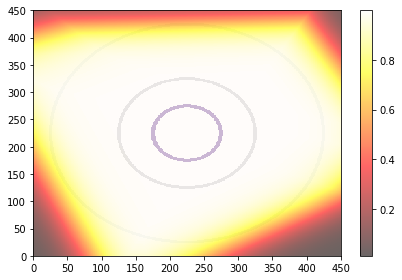

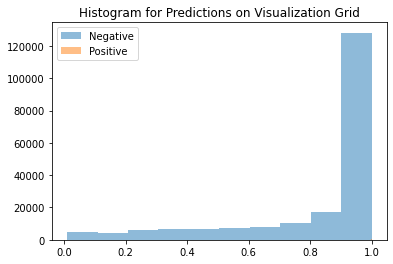

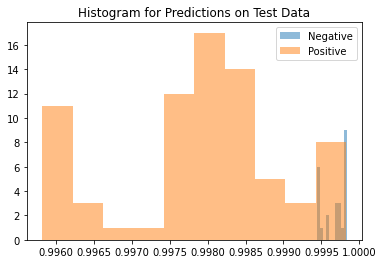

Average Difference between Positive and Negative Class: -0.0017597675323486328


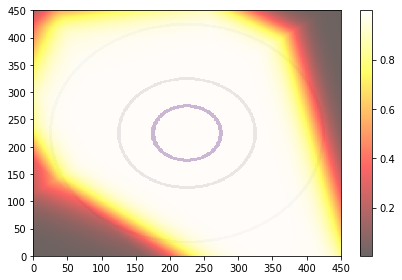

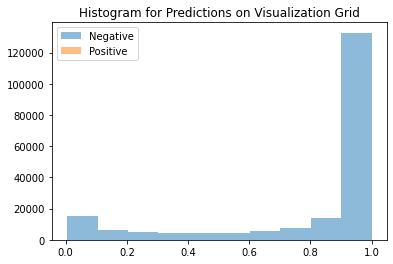

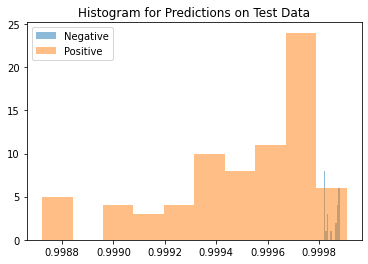

Average Difference between Positive and Negative Class: -0.0003514885902404785


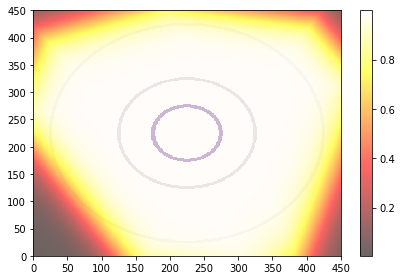

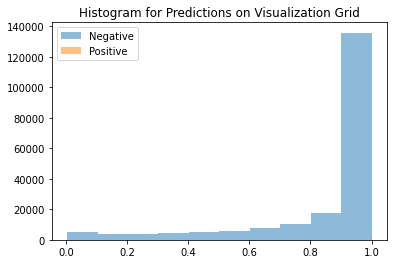

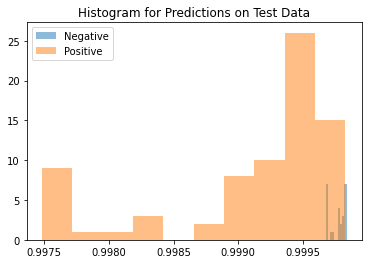

Average Difference between Positive and Negative Class: -0.0006700754165649414


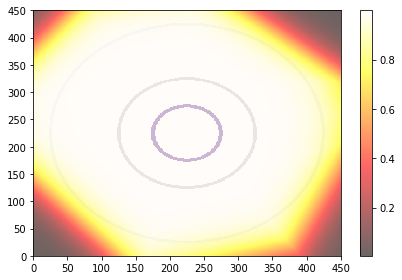

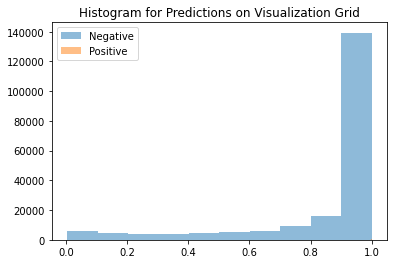

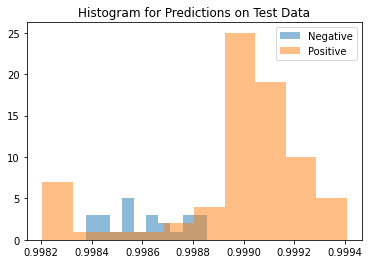

Average Difference between Positive and Negative Class: 0.00036132335662841797


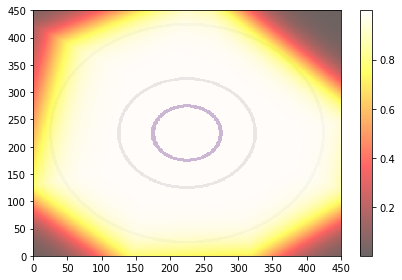

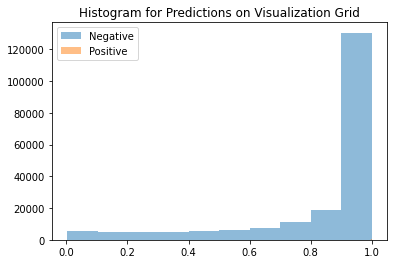

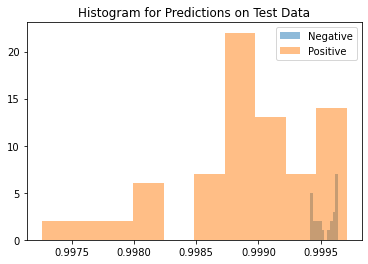

Average Difference between Positive and Negative Class: -0.0006394386291503906


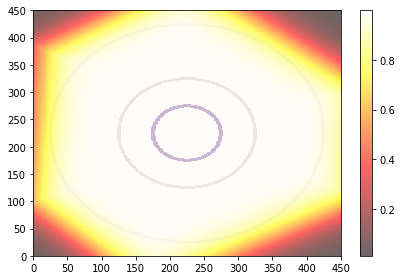

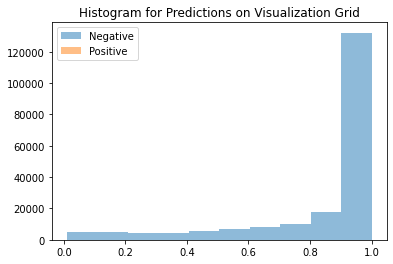

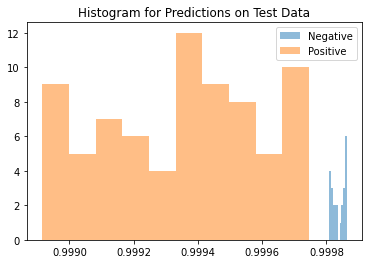

Average Difference between Positive and Negative Class: -0.0004915595054626465


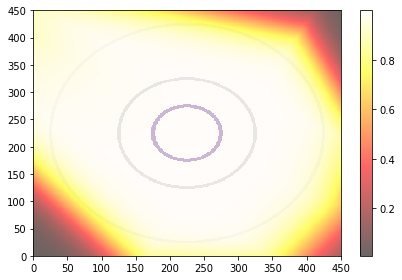

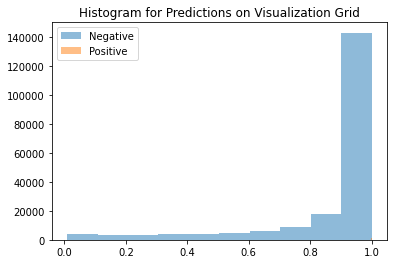

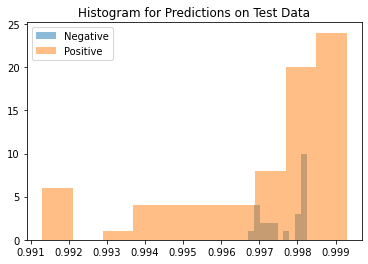

Average Difference between Positive and Negative Class: -0.0005549192428588867


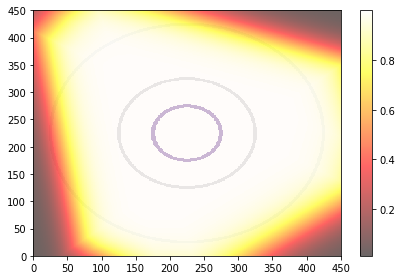

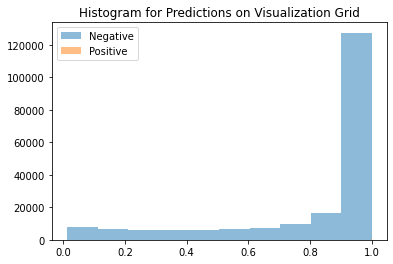

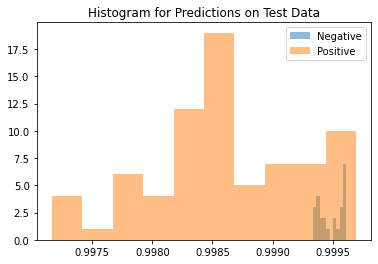

Average Difference between Positive and Negative Class: -0.0008658766746520996


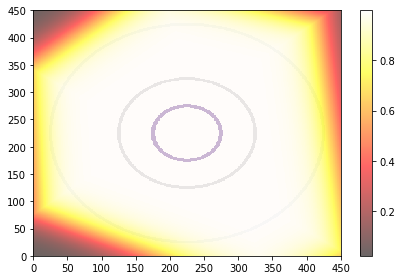

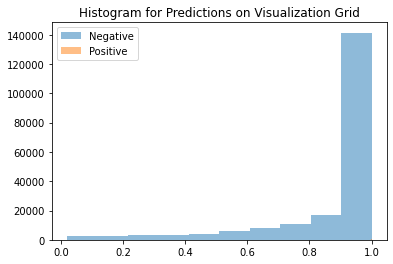

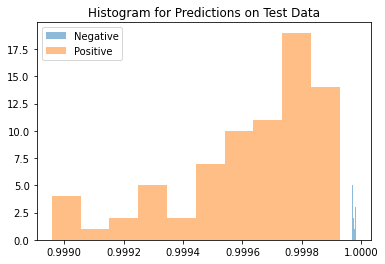

Average Difference between Positive and Negative Class: -0.000347137451171875


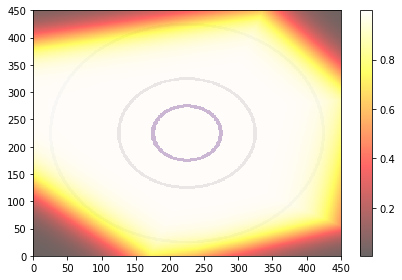

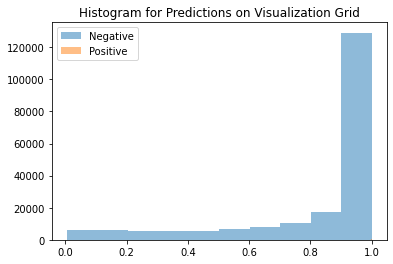

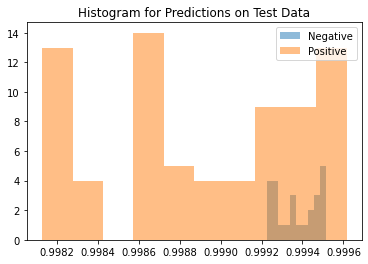

Average Difference between Positive and Negative Class: -0.0004661679267883301
AUPR (Train): 1.0+-7.850462293418876e-17
AUPR (Test): 0.6227941518854865+-0.12086578812425831
Average Distance between Means: -0.0006041586166247725+-0.0011056145885959268


([1.0,
  1.0,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  1.0,
  1.0,
  1.0,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.9999999999999999],
 [0.5852216419599557,
  0.5736511378253902,
  0.6360428161285898,
  0.5422146060949236,
  0.5580888533693449,
  0.5381551596662352,
  0.5378602200379622,
  0.8422177686551834,
  0.5378602200379622,
  0.6298089287089635,
  0.5459477349363018,
  0.5702488939928538,
  0.5439776668015749,
  0.9658083377138256,
  0.6201204603818118,
  0.5378573626401468,
  0.8609870743425014,
  0.6077852212625865,
  0.537856304917768,
  0.6841726282358465],
 [-0.00036931038,
  -0.0019017458,
  -0.0012295842,
  -0.00054341555,
  -0.0027676225,
  -0.00047284365,
  -0.00036609173,
  0.003209293,
  -0.0005403757,
  -0.0013163686,
  -0.0017597675,
  -0.0003514886,
  -0.0006700754,
  0.00036132336,
  -0.00063943863,
  -0.000491

In [6]:
# HS2
separation = "HS"
bumped = ""
sigma = 0.5
hidden_layers = 2
train = False    # train sigma. if NA, then False

verbose = 0      # can change this to 0 to suppress verbosity during training
plot = False
shuffle = False
val_split = 0.1

auprs_train = []
auprs_test = []
diff_means = []

# Train and Evaluate the Model
for i in range(20):
    
    # Create the model
    tf.keras.utils.set_random_seed(i)
    model = create_model(separation, activation=bumped, hidden_layers=hidden_layers,
                 sigma=sigma, train=train, loss='binary_crossentropy',
                 seed=i)
    
    # Train the model
    aupr_train, aupr_test, diff_mean = train_eval(model, X, y, x_test, y_test, 
               train=train, verbose=verbose, shuffle=shuffle, plot=plot,
               val_split=val_split, callbacks=[early_stopping], seed=i, diff=True)
    
    auprs_train.append(aupr_train)
    auprs_test.append(aupr_test)
    diff_means.append(diff_mean)
    
print(f"AUPR (Train): {np.mean(auprs_train)}+-{np.std(auprs_train)}")
print(f"AUPR (Test): {np.mean(auprs_test)}+-{np.std(auprs_test)}")
print(f"Average Distance between Means: {np.mean(diff_means)}+-{np.std(diff_means)}")
auprs_train, auprs_test, diff_means

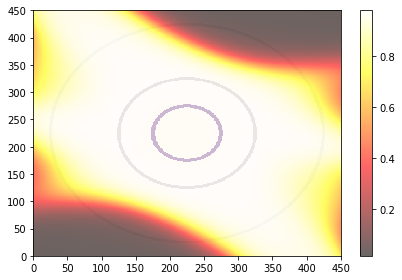

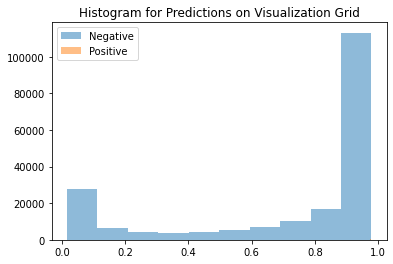

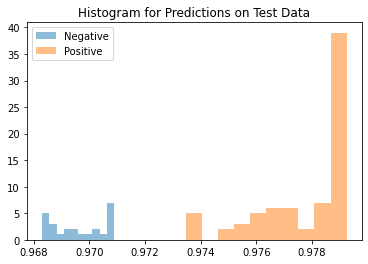

Average Difference between Positive and Negative Class: 0.008167445659637451


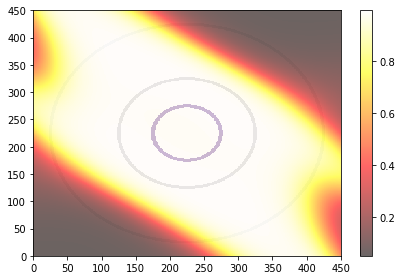

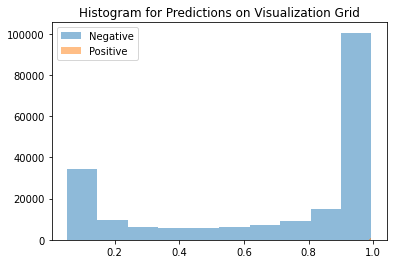

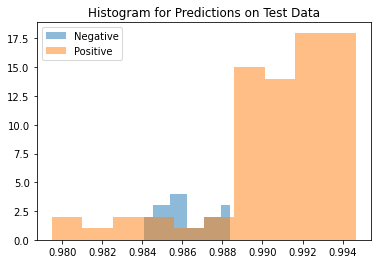

Average Difference between Positive and Negative Class: 0.004636704921722412


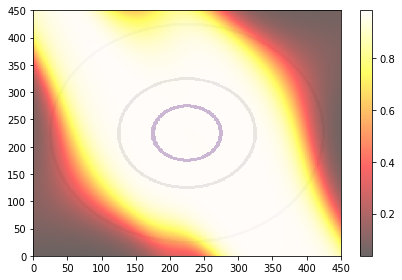

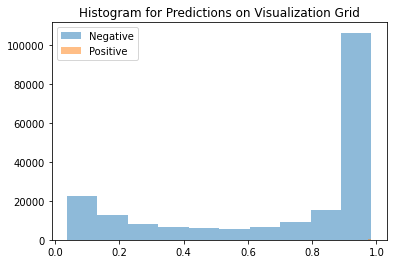

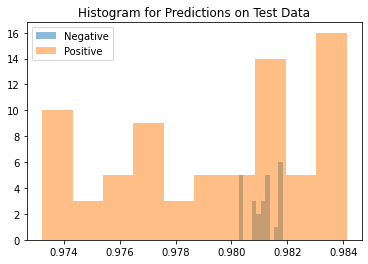

Average Difference between Positive and Negative Class: -0.0016250014305114746


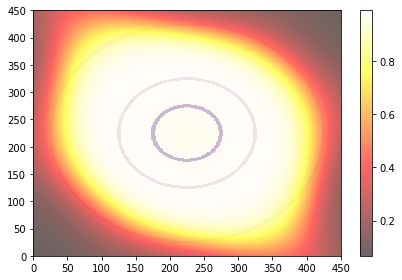

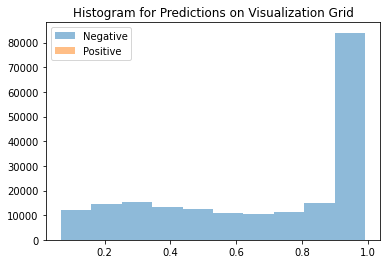

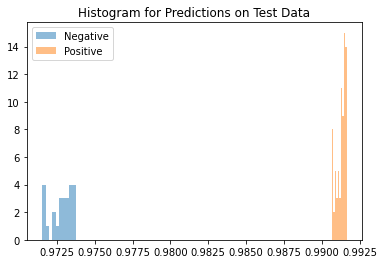

Average Difference between Positive and Negative Class: 0.01847165822982788


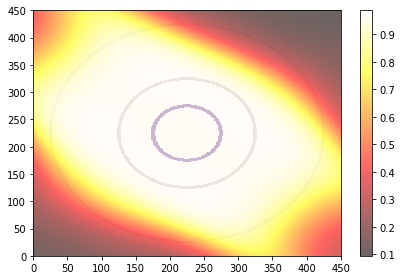

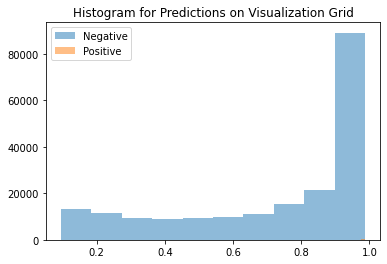

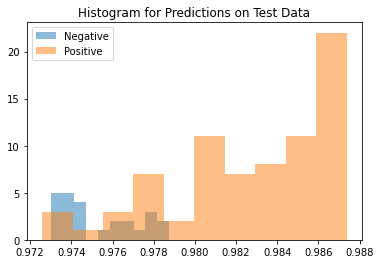

Average Difference between Positive and Negative Class: 0.0073334574699401855


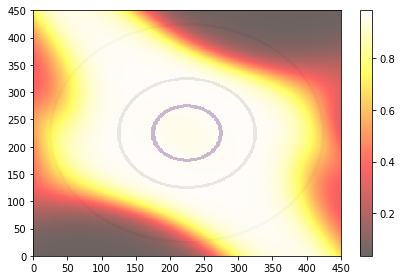

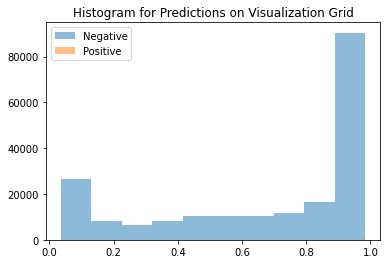

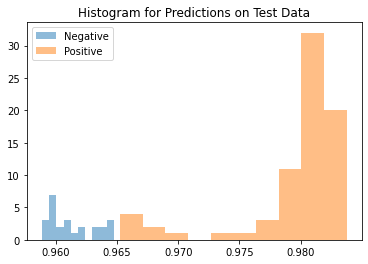

Average Difference between Positive and Negative Class: 0.018357515335083008


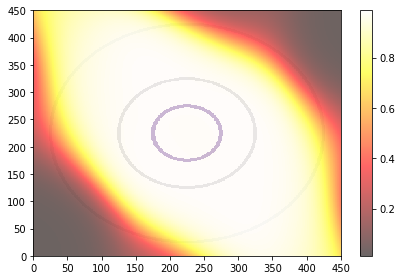

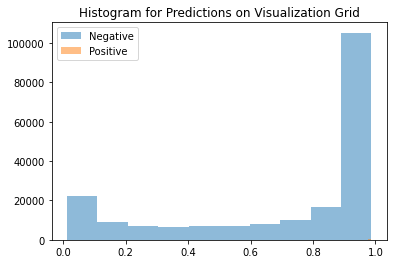

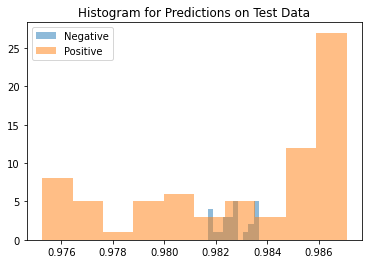

Average Difference between Positive and Negative Class: 0.00014466047286987305


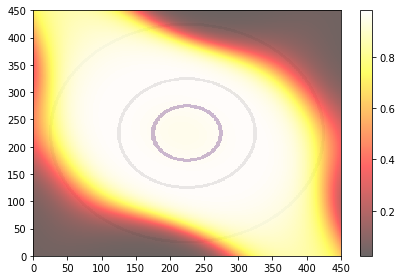

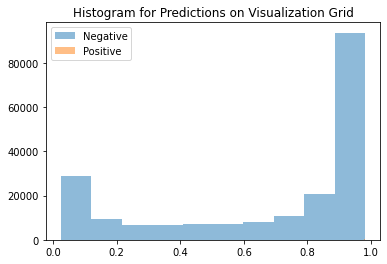

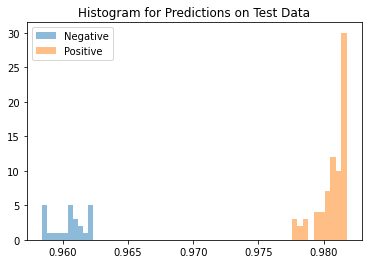

Average Difference between Positive and Negative Class: 0.02020341157913208


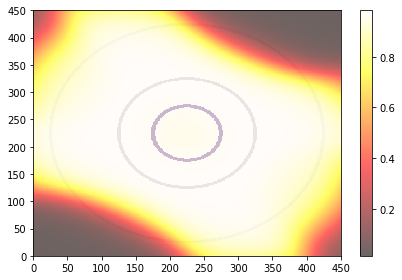

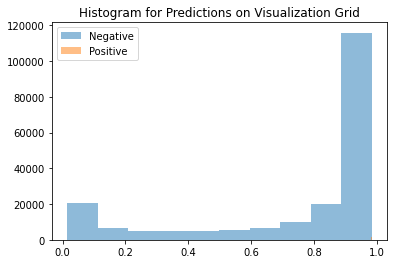

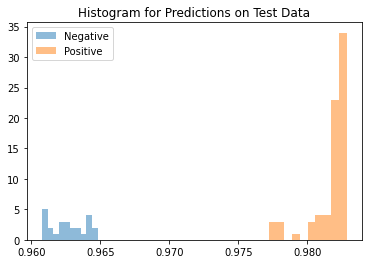

Average Difference between Positive and Negative Class: 0.019089162349700928


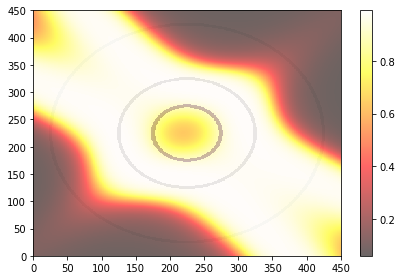

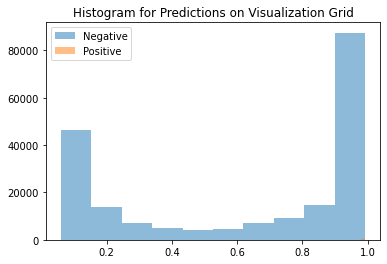

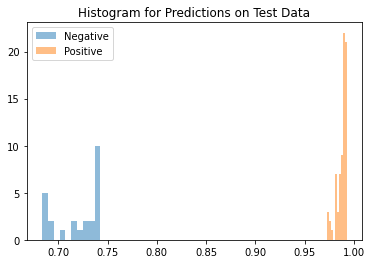

Average Difference between Positive and Negative Class: 0.2676911950111389


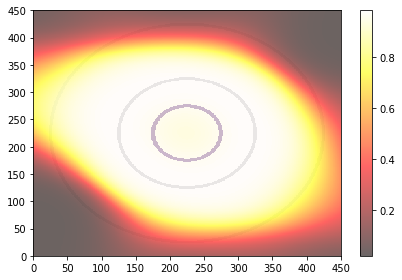

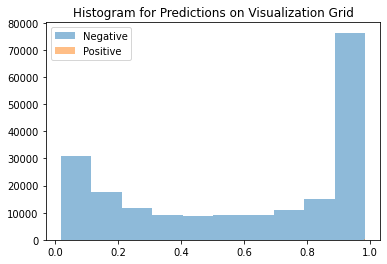

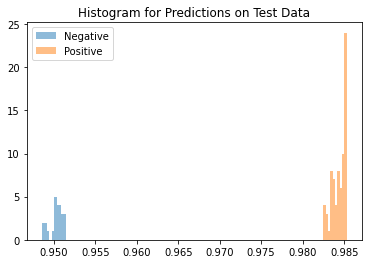

Average Difference between Positive and Negative Class: 0.03401750326156616


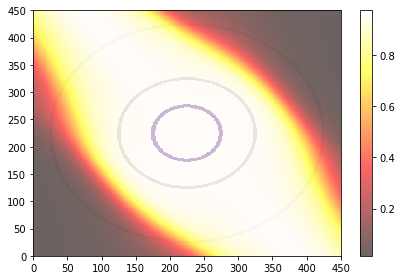

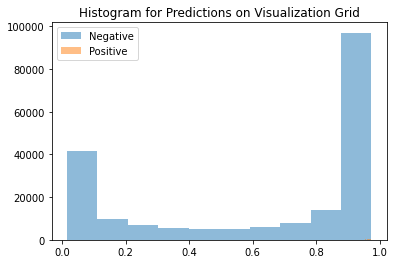

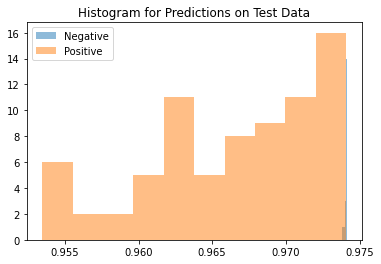

Average Difference between Positive and Negative Class: -0.0075640082359313965


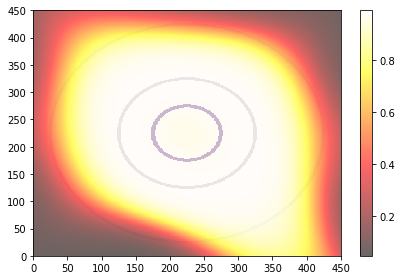

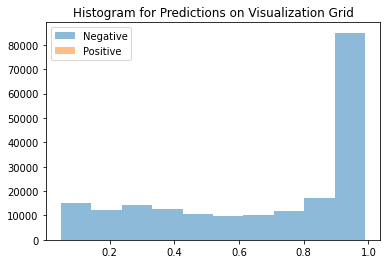

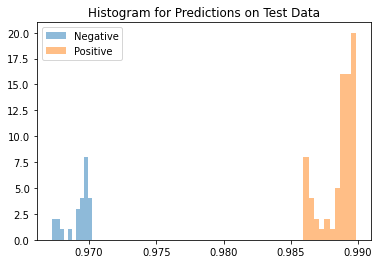

Average Difference between Positive and Negative Class: 0.01941359043121338


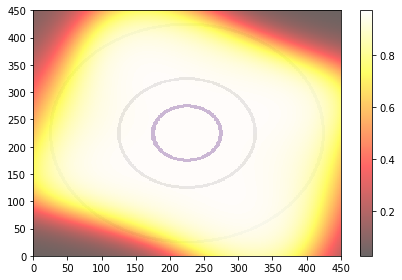

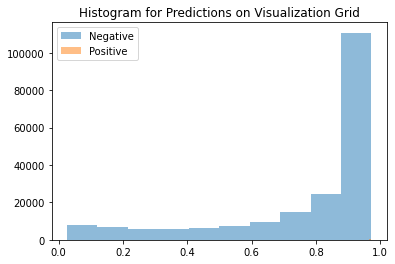

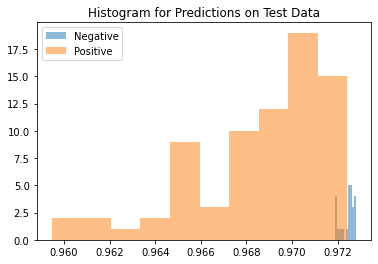

Average Difference between Positive and Negative Class: -0.0038364529609680176


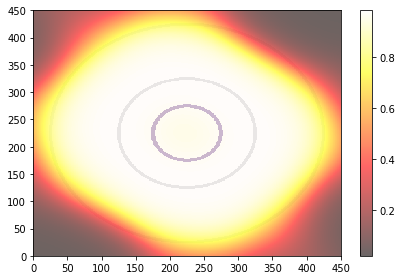

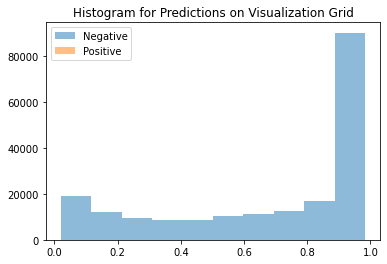

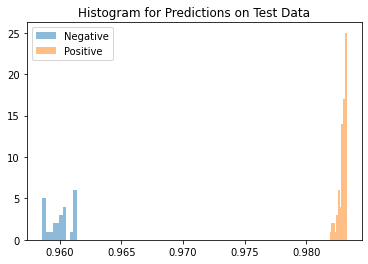

Average Difference between Positive and Negative Class: 0.02289271354675293


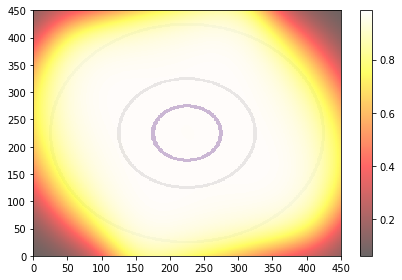

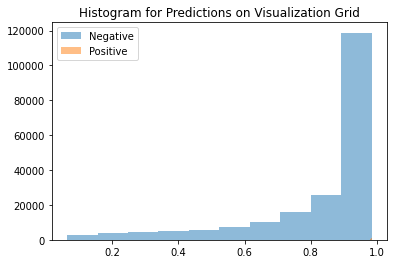

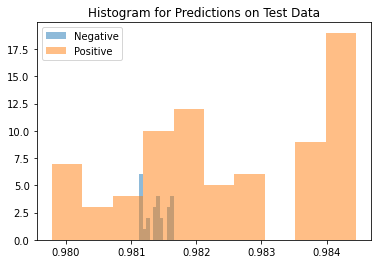

Average Difference between Positive and Negative Class: 0.0011180639266967773


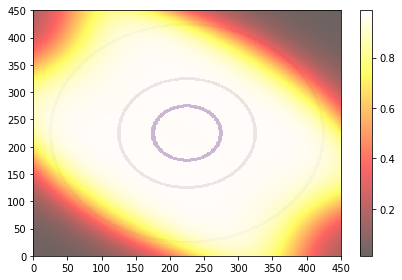

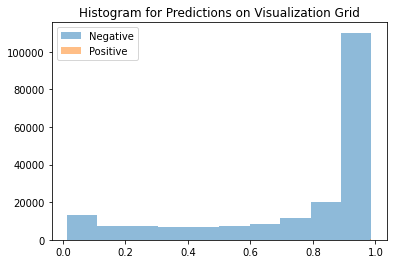

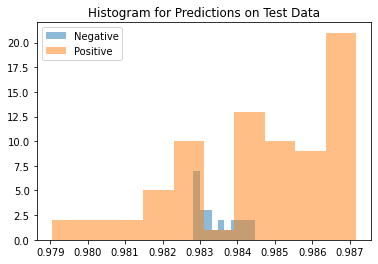

Average Difference between Positive and Negative Class: 0.0011647343635559082


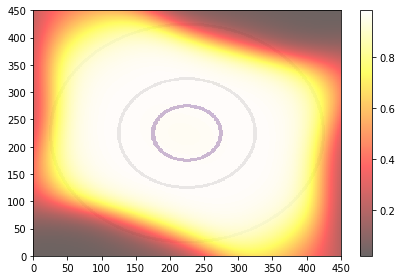

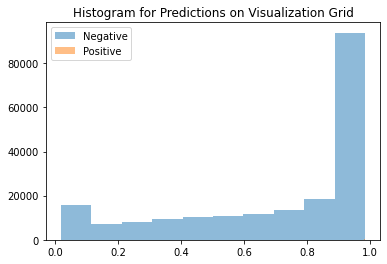

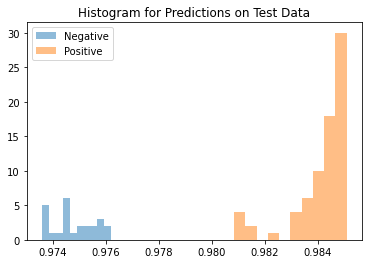

Average Difference between Positive and Negative Class: 0.009330928325653076


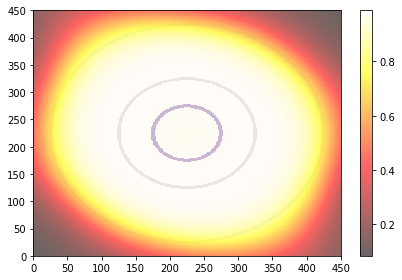

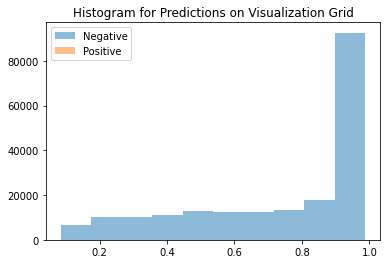

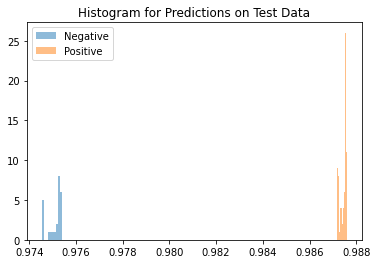

Average Difference between Positive and Negative Class: 0.012327373027801514


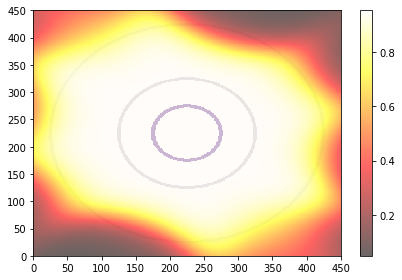

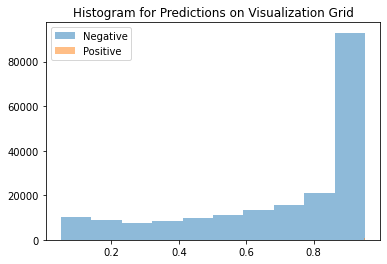

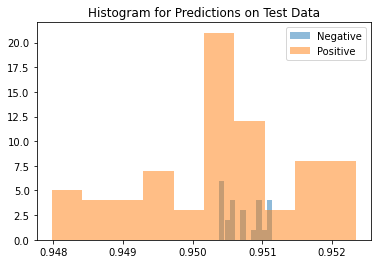

Average Difference between Positive and Negative Class: -0.0003097653388977051
AUPR (Train): 1.0+-1.0235750533041807e-16
AUPR (Test): 0.9170674196596738+-0.14162116809609734
Average Distance between Means: 0.022551244124770164+-0.057207800447940826


([0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.9999999999999999],
 [0.9999999999999999,
  0.9737781437653907,
  0.8104656034130279,
  0.9999999999999999,
  0.9792090818019289,
  0.9999999999999999,
  0.8789921800049402,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.5411740158193717,
  0.9999999999999999,
  0.5400564695616532,
  1.0,
  0.9344373974780693,
  0.9139491791101209,
  0.9999999999999999,
  1.0,
  0.7692863222389718],
 [0.008167446,
  0.004636705,
  -0.0016250014,
  0.018471658,
  0.0073334575,
  0.018357515,
  0.00014466047,
  0.020203412,
  0.019089162,
  0.2676912,
  0.034017503,
  -0.0075640082,
  0.01941359,
  -0.003836453,
  0.0228

In [7]:
# HS2b
separation = "HS"
bumped = "b"
sigma = 0.5
hidden_layers = 2
train = False    # train sigma. if NA, then False

verbose = 0      # can change this to 0 to suppress verbosity during training
plot = False
shuffle = False
val_split = 0.1

auprs_train = []
auprs_test = []
diff_means = []

# Train and Evaluate the Model
for i in range(20):
    
    # Create the model
    tf.keras.utils.set_random_seed(i)
    model = create_model(separation, activation=bumped, hidden_layers=hidden_layers,
                 sigma=sigma, train=train, loss='binary_crossentropy',
                 seed=i)
    
    # Train the model
    aupr_train, aupr_test, diff_mean = train_eval(model, X, y, x_test, y_test, 
               train=train, verbose=verbose, shuffle=shuffle, plot=plot,
               val_split=val_split, callbacks=[early_stopping], seed=i, diff=True)
    
    auprs_train.append(aupr_train)
    auprs_test.append(aupr_test)
    diff_means.append(diff_mean)
    
print(f"AUPR (Train): {np.mean(auprs_train)}+-{np.std(auprs_train)}")
print(f"AUPR (Test): {np.mean(auprs_test)}+-{np.std(auprs_test)}")
print(f"Average Distance between Means: {np.mean(diff_means)}+-{np.std(diff_means)}")
auprs_train, auprs_test, diff_means

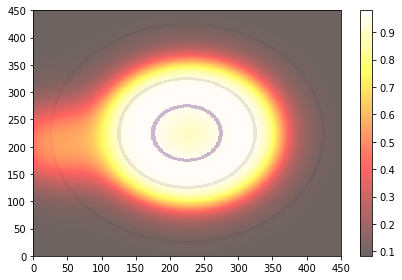

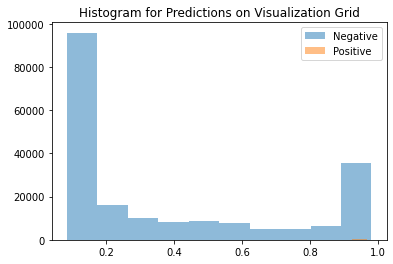

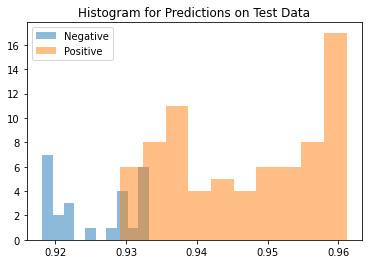

Average Difference between Positive and Negative Class: 0.02156352996826172


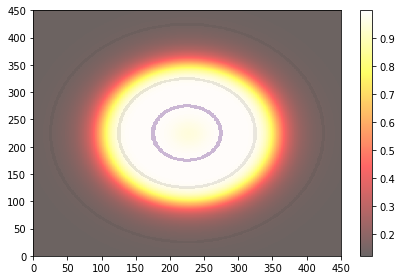

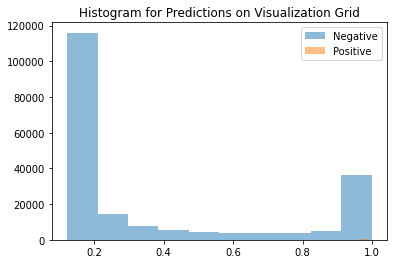

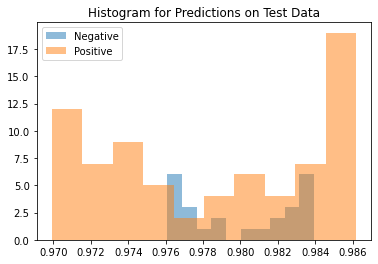

Average Difference between Positive and Negative Class: -0.0014693737030029297


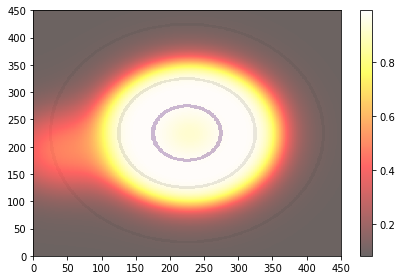

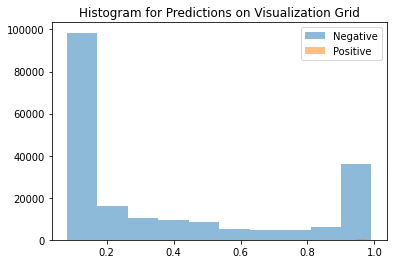

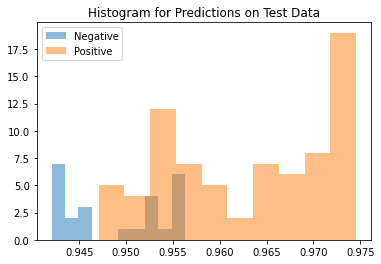

Average Difference between Positive and Negative Class: 0.014116048812866211


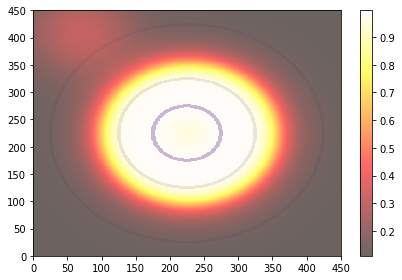

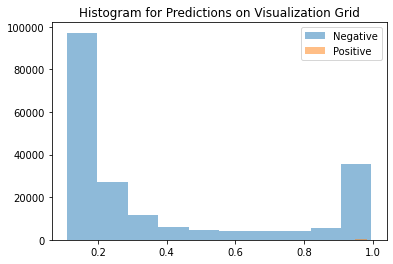

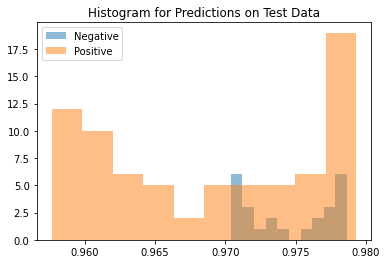

Average Difference between Positive and Negative Class: -0.005530714988708496


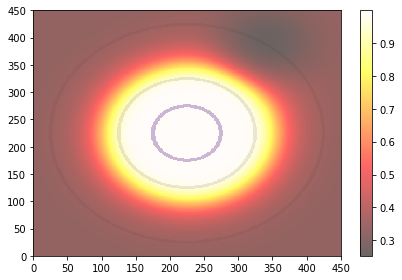

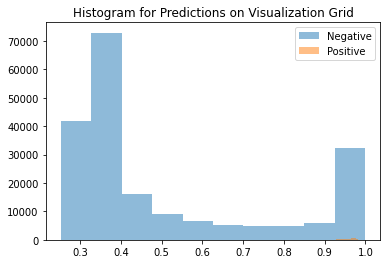

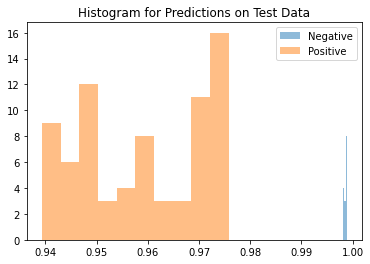

Average Difference between Positive and Negative Class: -0.039476215839385986


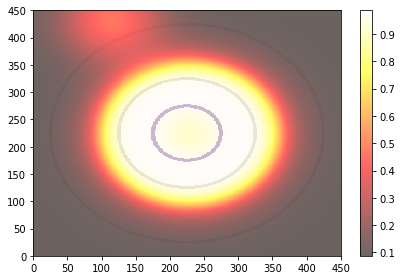

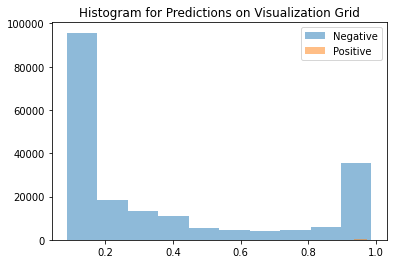

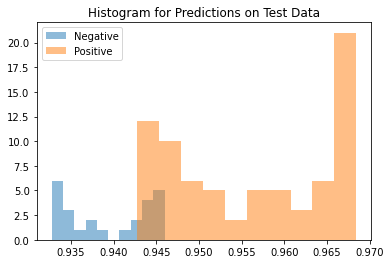

Average Difference between Positive and Negative Class: 0.017004847526550293


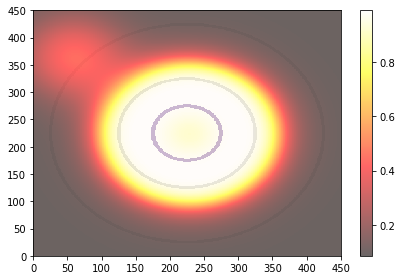

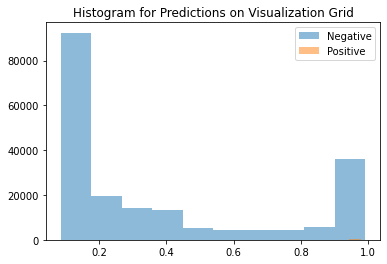

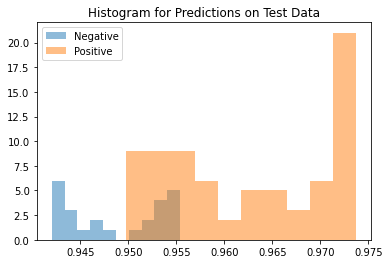

Average Difference between Positive and Negative Class: 0.013903260231018066


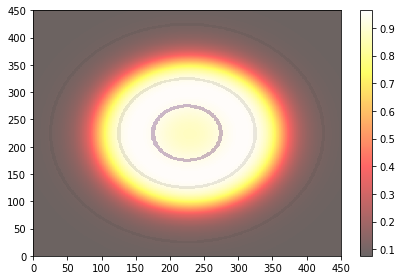

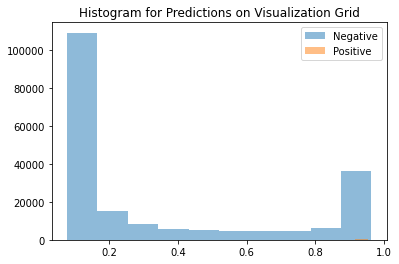

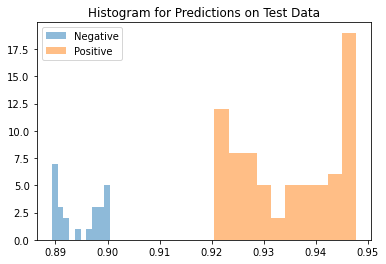

Average Difference between Positive and Negative Class: 0.04021275043487549


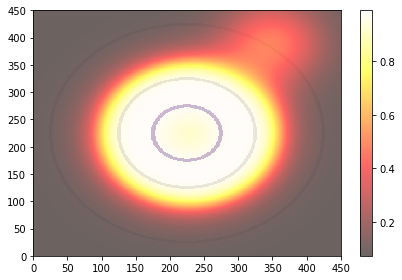

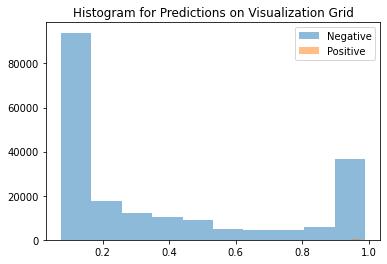

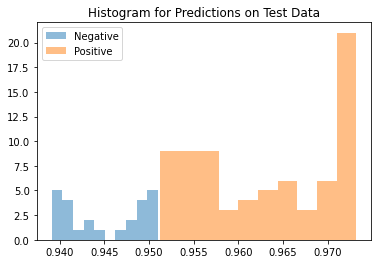

Average Difference between Positive and Negative Class: 0.018028199672698975


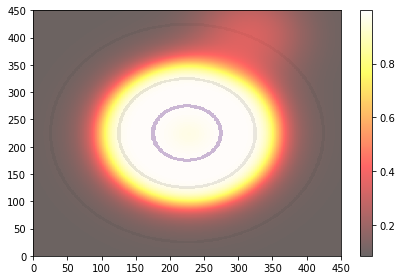

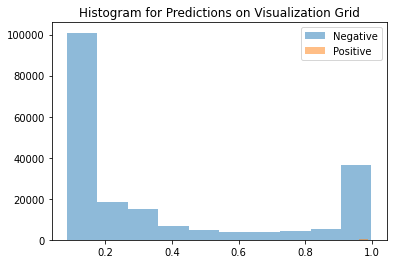

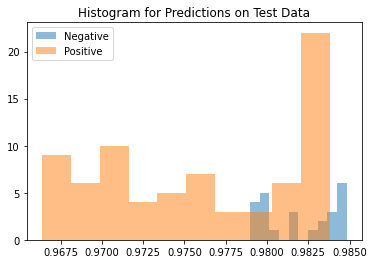

Average Difference between Positive and Negative Class: -0.005938410758972168


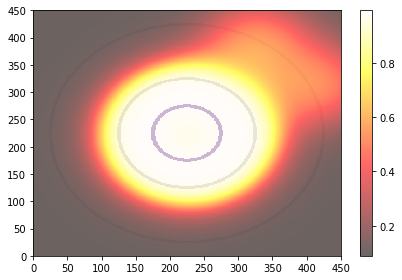

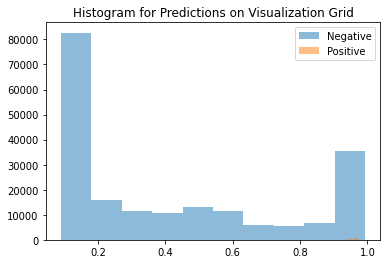

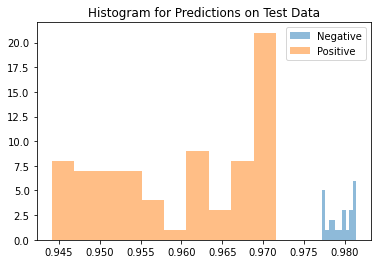

Average Difference between Positive and Negative Class: -0.01966327428817749


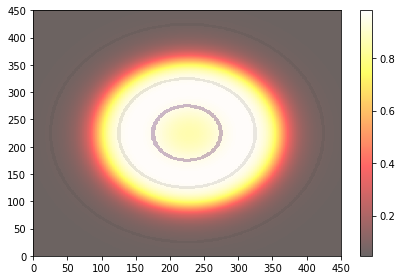

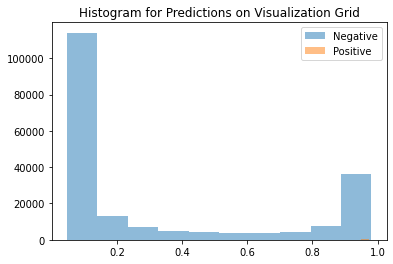

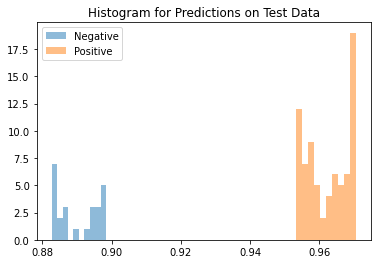

Average Difference between Positive and Negative Class: 0.07206809520721436


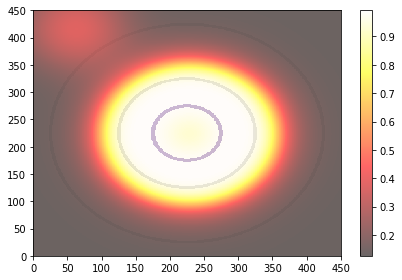

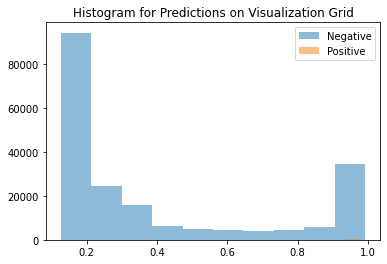

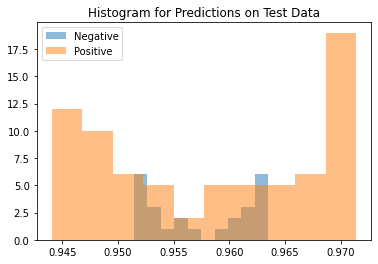

Average Difference between Positive and Negative Class: 0.0009725093841552734


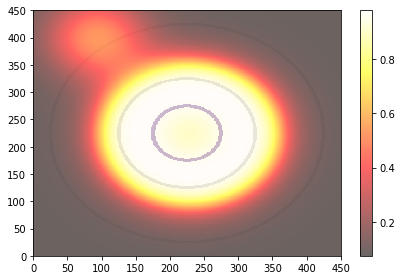

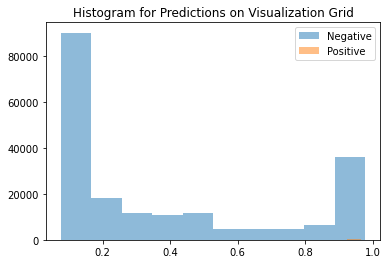

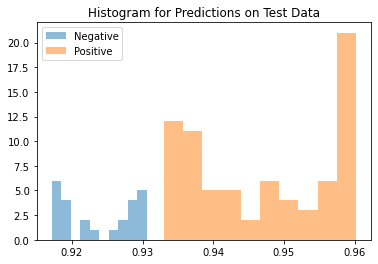

Average Difference between Positive and Negative Class: 0.023385345935821533


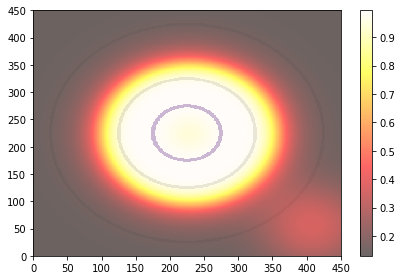

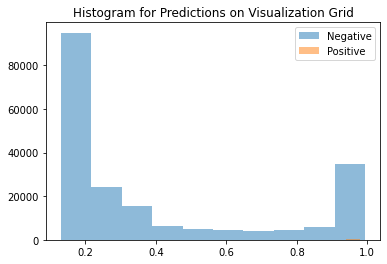

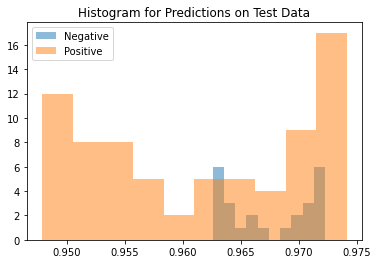

Average Difference between Positive and Negative Class: -0.005696773529052734


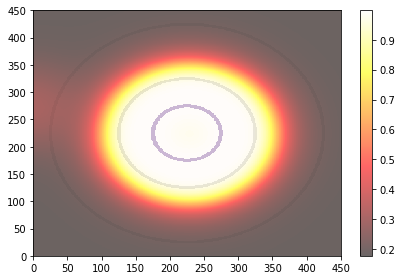

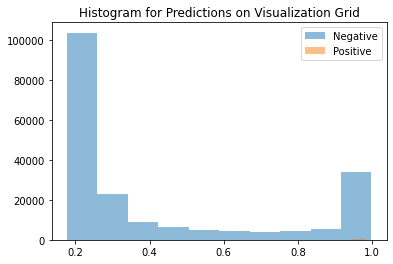

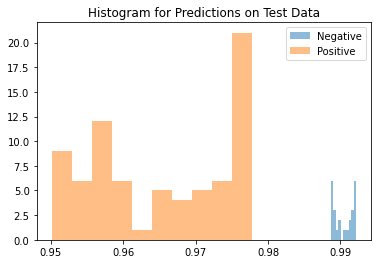

Average Difference between Positive and Negative Class: -0.02516239881515503


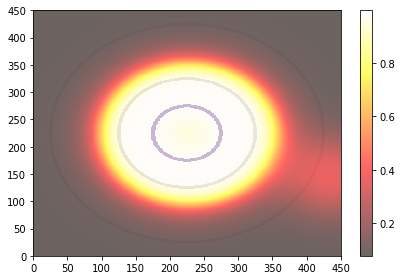

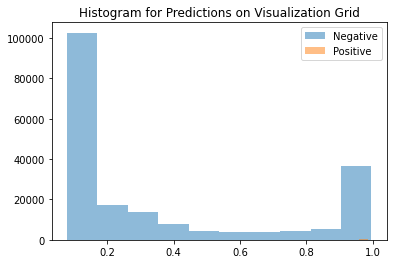

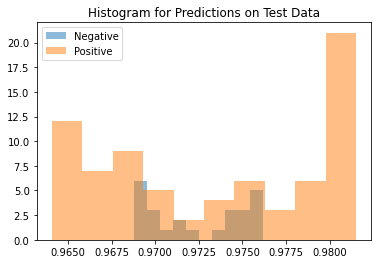

Average Difference between Positive and Negative Class: 0.00098419189453125


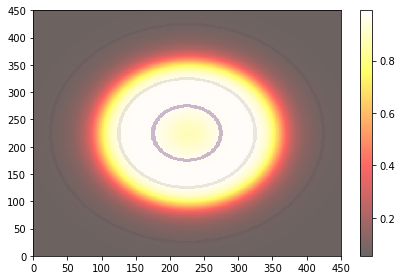

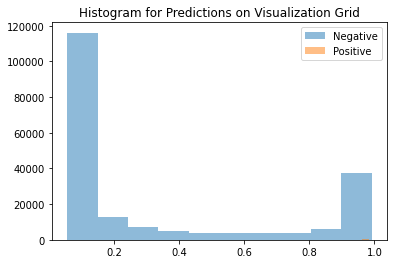

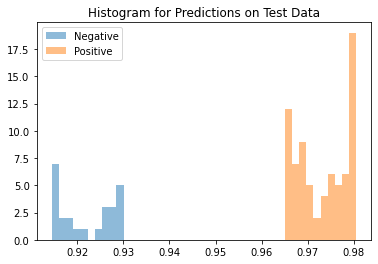

Average Difference between Positive and Negative Class: 0.05116802453994751


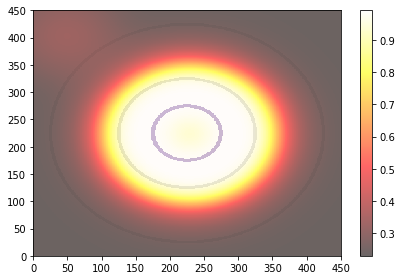

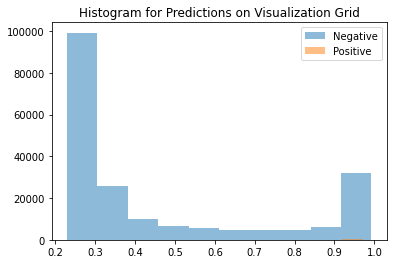

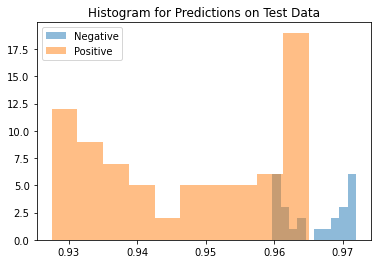

Average Difference between Positive and Negative Class: -0.018614113330841064


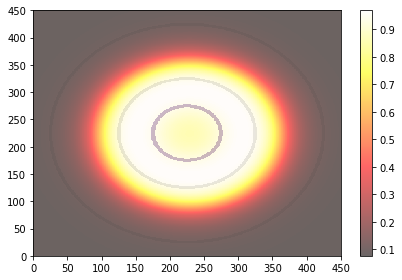

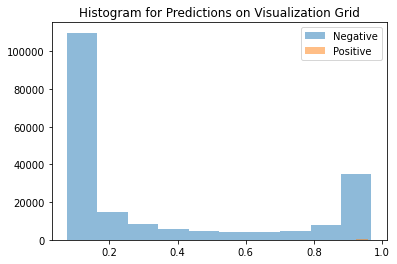

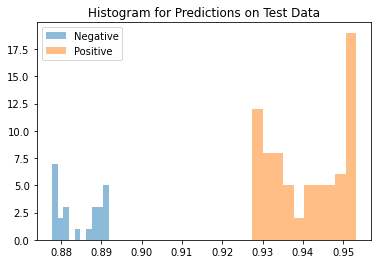

Average Difference between Positive and Negative Class: 0.05644029378890991
AUPR (Train): 1.0+-1.0821115497893178e-16
AUPR (Test): 0.8331916673359185+-0.1805894880468773
Average Distance between Means: 0.01041479129344225+-0.02783058024942875


([0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999],
 [0.9920376664068914,
  0.8016986747935847,
  0.9626603602037546,
  0.7339027235451863,
  0.5378602200379622,
  0.9845254508561045,
  0.9659398943953881,
  0.9999999999999999,
  0.9999999999999999,
  0.6026199772562383,
  0.5378602200379622,
  0.9999999999999999,
  0.839630335886588,
  0.9999999999999999,
  0.7545712164329693,
  0.5378602200379622,
  0.84543526034588,
  0.9999999999999999,
  0.5672311264819003,
  0.9999999999999999],
 [0.02156353,
  -0.0014693737,
  0.014116049,
  -0.005530715,
  -0.039476216,
  0.017004848,
  0.01390326,
  0.04021275,
  0.0180282,
  

In [8]:
# HS2r
separation = "HS"
bumped = "r"
sigma = 0.5
hidden_layers = 2
train = False    # train sigma. if NA, then False

verbose = 0      # can change this to 0 to suppress verbosity during training
plot = False
shuffle = False
val_split = 0.1

auprs_train = []
auprs_test = []
diff_means = []

# Train and Evaluate the Model
for i in range(20):
    
    # Create the model
    tf.keras.utils.set_random_seed(i)
    model = create_model(separation, activation=bumped, hidden_layers=hidden_layers,
                 sigma=sigma, train=train, loss='binary_crossentropy',
                 seed=i)
    
    # Train the model
    aupr_train, aupr_test, diff_mean = train_eval(model, X, y, x_test, y_test, 
               train=train, verbose=verbose, shuffle=shuffle, plot=plot,
               val_split=val_split, callbacks=[early_stopping], seed=i, diff=True)
    
    auprs_train.append(aupr_train)
    auprs_test.append(aupr_test)
    diff_means.append(diff_mean)
    
print(f"AUPR (Train): {np.mean(auprs_train)}+-{np.std(auprs_train)}")
print(f"AUPR (Test): {np.mean(auprs_test)}+-{np.std(auprs_test)}")
print(f"Average Distance between Means: {np.mean(diff_means)}+-{np.std(diff_means)}")
auprs_train, auprs_test, diff_means

## RBF Separation

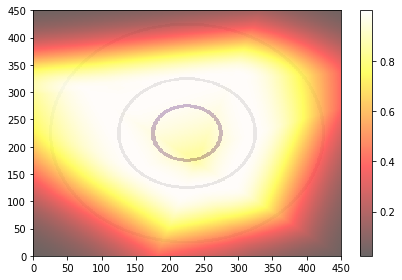

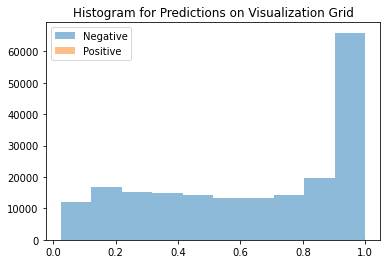

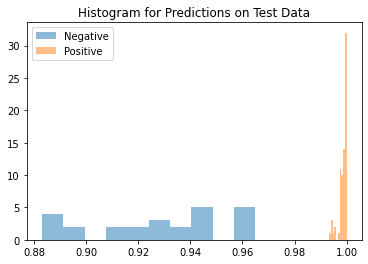

Average Difference between Positive and Negative Class: 0.0706557035446167


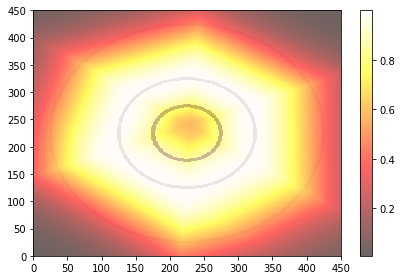

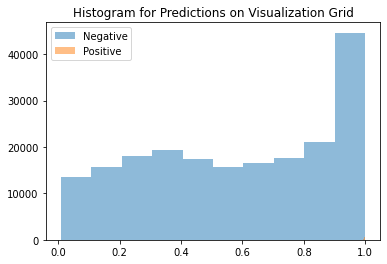

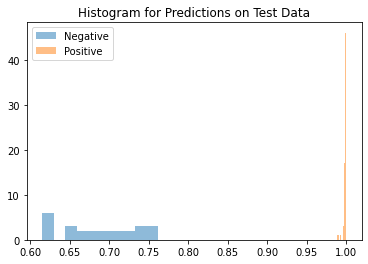

Average Difference between Positive and Negative Class: 0.3145907521247864


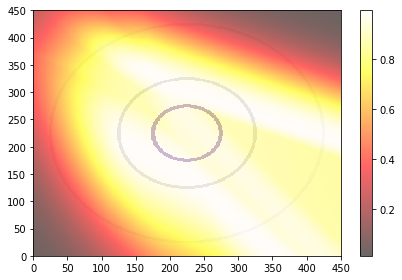

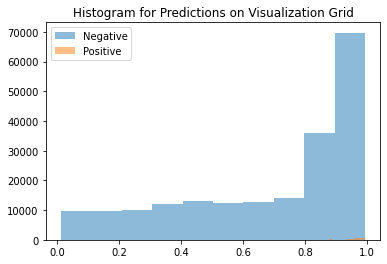

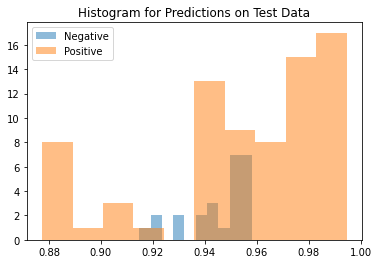

Average Difference between Positive and Negative Class: 0.008893072605133057


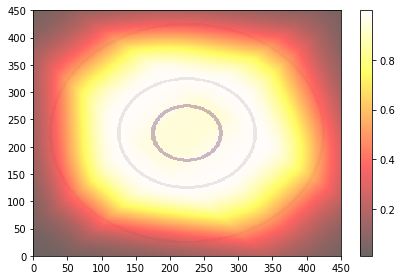

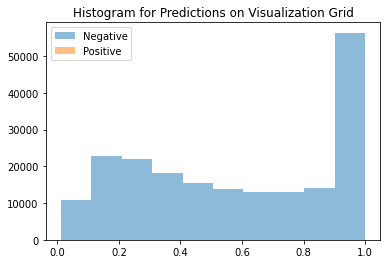

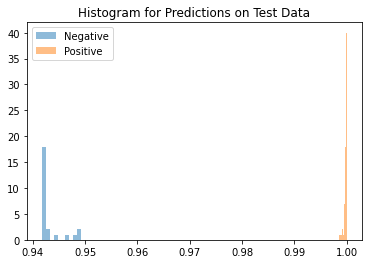

Average Difference between Positive and Negative Class: 0.05663251876831055


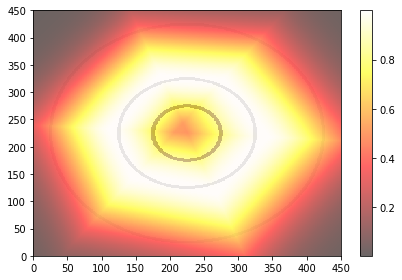

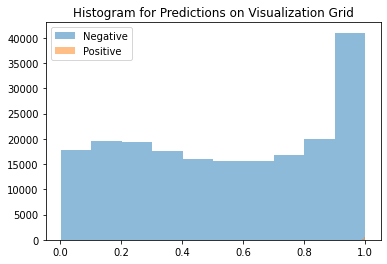

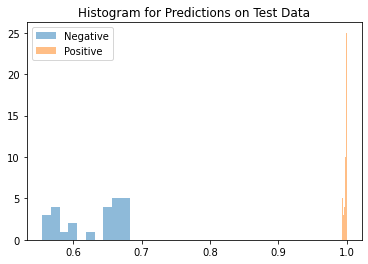

Average Difference between Positive and Negative Class: 0.37207889556884766


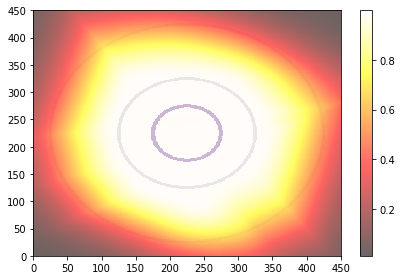

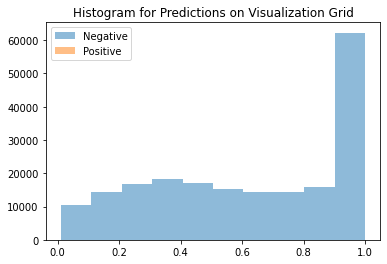

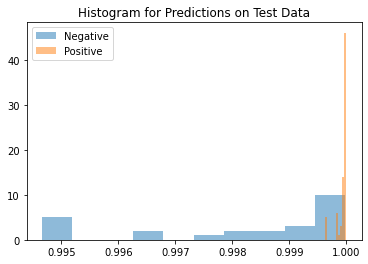

Average Difference between Positive and Negative Class: 0.0017565488815307617


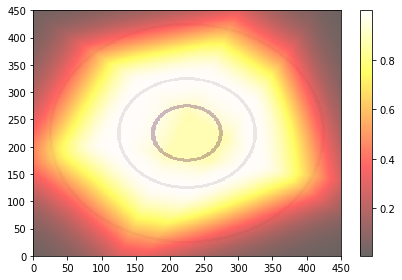

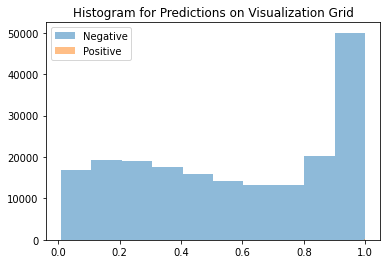

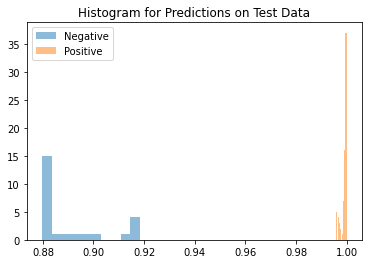

Average Difference between Positive and Negative Class: 0.1086890697479248


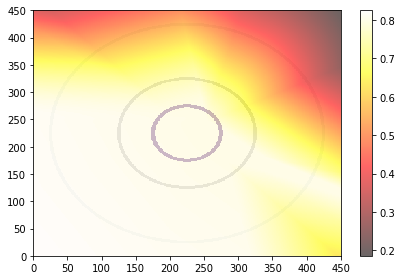

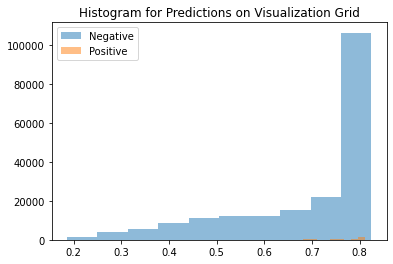

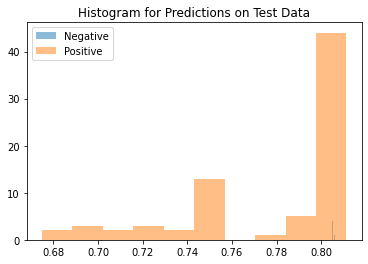

Average Difference between Positive and Negative Class: -0.024488329887390137


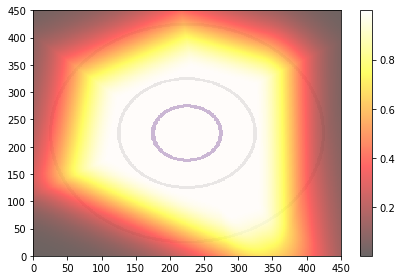

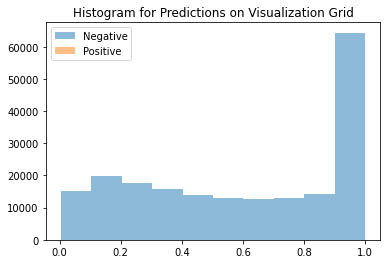

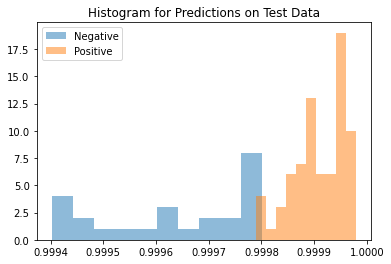

Average Difference between Positive and Negative Class: 0.00027632713317871094


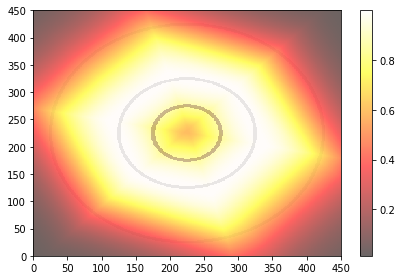

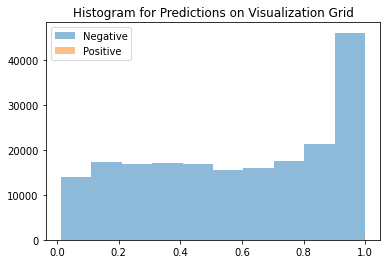

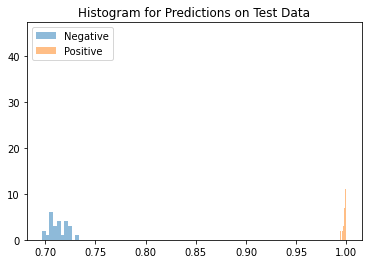

Average Difference between Positive and Negative Class: 0.28610289096832275


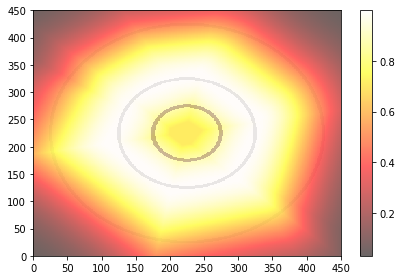

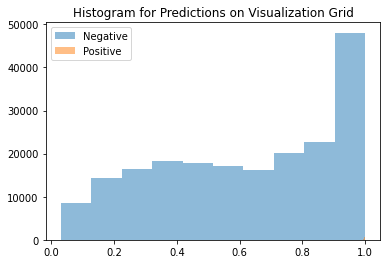

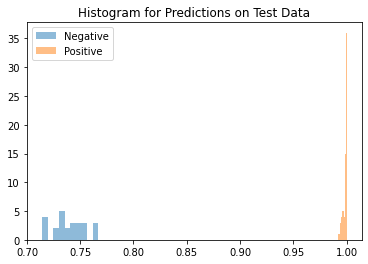

Average Difference between Positive and Negative Class: 0.258536159992218


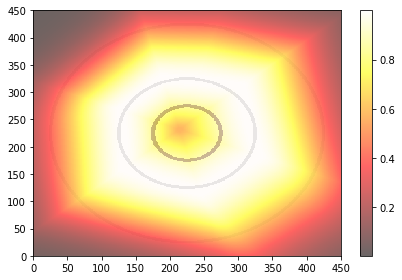

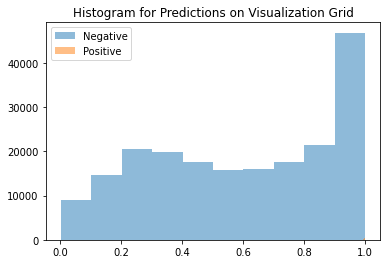

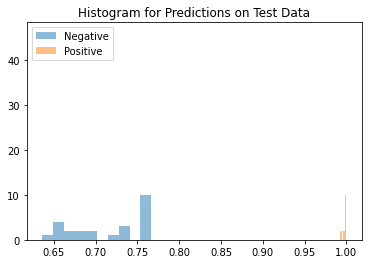

Average Difference between Positive and Negative Class: 0.2826123833656311


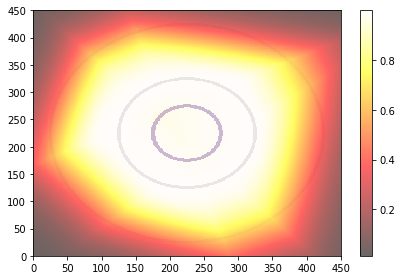

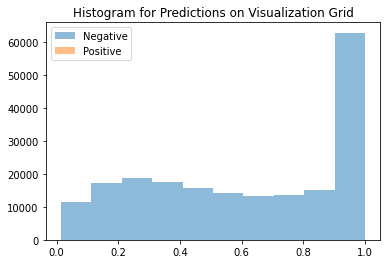

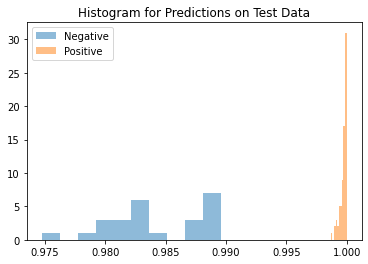

Average Difference between Positive and Negative Class: 0.015507996082305908


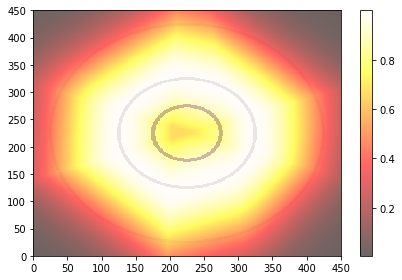

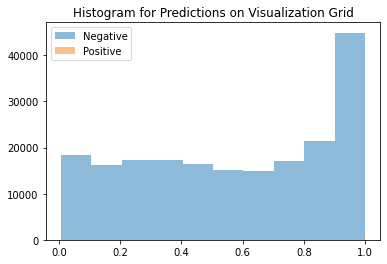

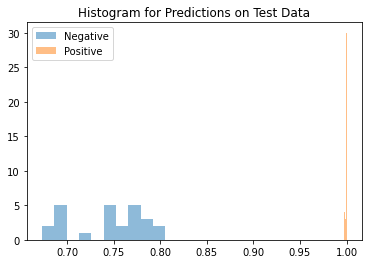

Average Difference between Positive and Negative Class: 0.2546274662017822


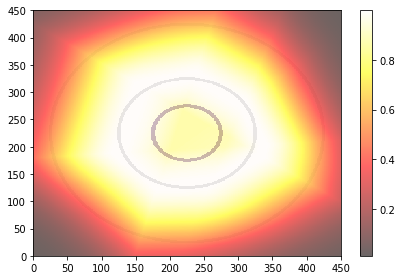

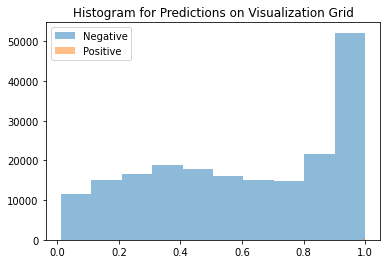

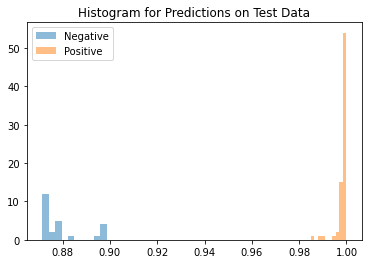

Average Difference between Positive and Negative Class: 0.11975240707397461


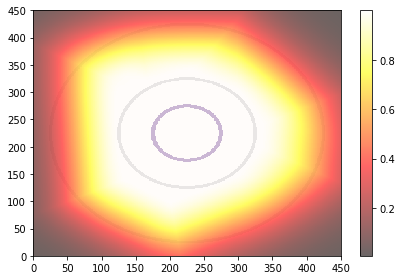

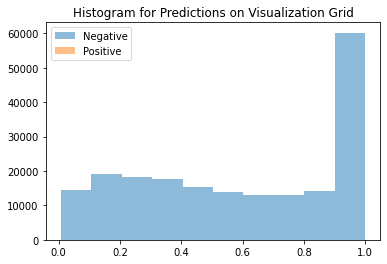

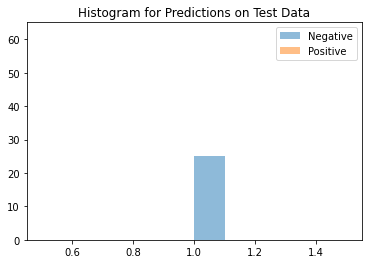

Average Difference between Positive and Negative Class: -2.47955322265625e-05


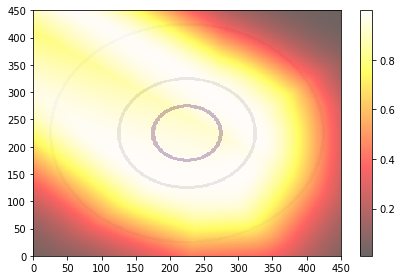

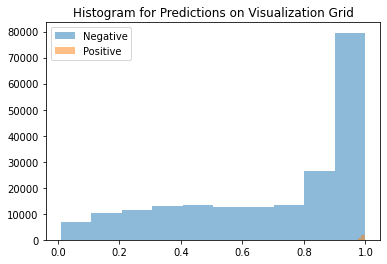

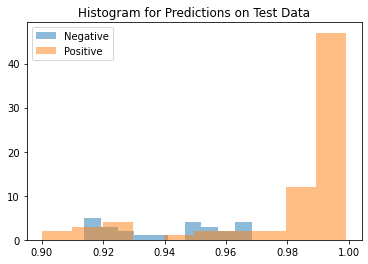

Average Difference between Positive and Negative Class: 0.04077428579330444


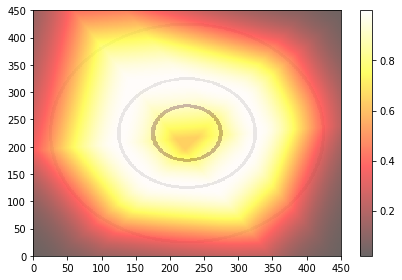

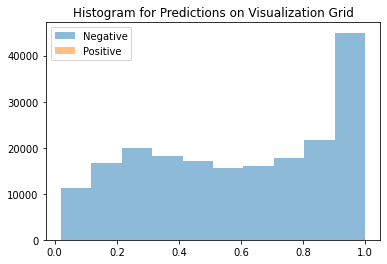

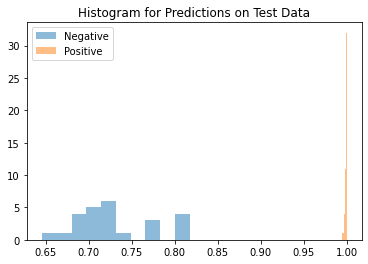

Average Difference between Positive and Negative Class: 0.26995033025741577


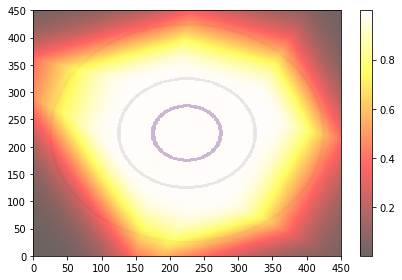

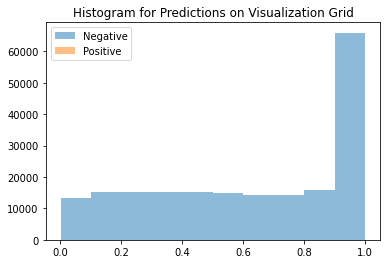

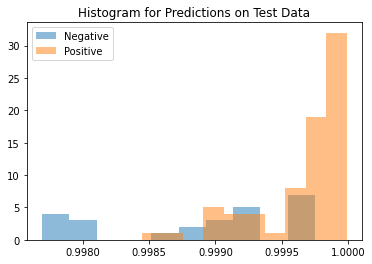

Average Difference between Positive and Negative Class: 0.0007796883583068848


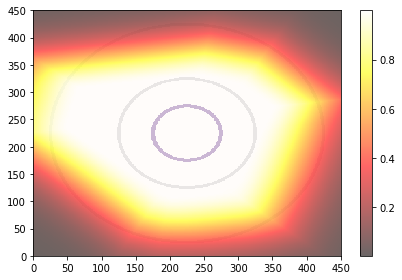

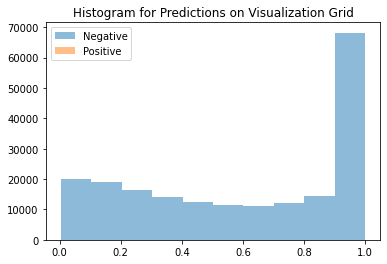

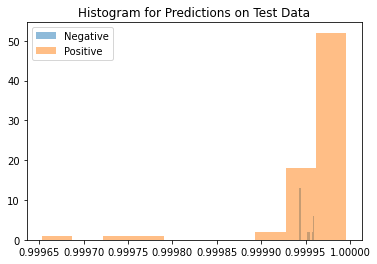

Average Difference between Positive and Negative Class: 8.64267349243164e-06
AUPR (Train): 0.9834217976508309+-0.07226270870559616
AUPR (Test): 0.9702242537295673+-0.049920417472251594
Average Distance between Means: 0.12188559770584106+-0.1310535967350006


([0.9999999999999999,
  1.0,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  0.6684359530166204,
  1.0000000000000002,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  1.0],
 [0.9999999999999999,
  1.0,
  0.8921403914269426,
  1.0,
  0.9999999999999999,
  0.9395664388685537,
  0.9999999999999999,
  0.8125575773420504,
  0.9986384942505862,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.895093983666029,
  0.9661522800198996,
  0.9999999999999999,
  0.9542318825550526,
  0.946104026462233],
 [0.0706557,
  0.31459075,
  0.008893073,
  0.05663252,
  0.3720789,
  0.0017565489,
  0.10868907,
  -0.02448833,
  0.00027632713,
  0.2861029,
  0.25853616,
  0.28261238,
  0.015507996,
  0.25462747,
  0.11975

In [9]:
# RBF2
separation = "RBF"
bumped = ""
sigma = 0.5
hidden_layers = 2
train = False    # train sigma. if NA, then False

verbose = 0      # can change this to 0 to suppress verbosity during training
plot = False
shuffle = False
val_split = 0.1

auprs_train = []
auprs_test = []
diff_means = []

# Train and Evaluate the Model
for i in range(20):
    
    # Create the model
    tf.keras.utils.set_random_seed(i)
    model = create_model(separation, activation=bumped, hidden_layers=hidden_layers,
                 sigma=sigma, train=train, loss='binary_crossentropy',
                 seed=i)
    
    # Train the model
    aupr_train, aupr_test, diff_mean = train_eval(model, X, y, x_test, y_test, 
               train=train, verbose=verbose, shuffle=shuffle, plot=plot,
               val_split=val_split, callbacks=[early_stopping], seed=i, diff=True)
    
    auprs_train.append(aupr_train)
    auprs_test.append(aupr_test)
    diff_means.append(diff_mean)
    
print(f"AUPR (Train): {np.mean(auprs_train)}+-{np.std(auprs_train)}")
print(f"AUPR (Test): {np.mean(auprs_test)}+-{np.std(auprs_test)}")
print(f"Average Distance between Means: {np.mean(diff_means)}+-{np.std(diff_means)}")
auprs_train, auprs_test, diff_means

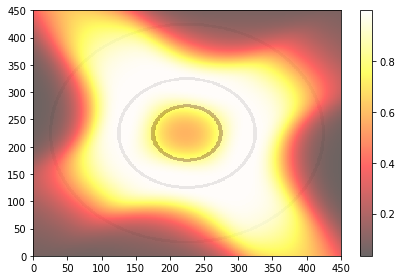

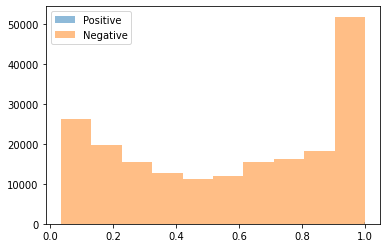

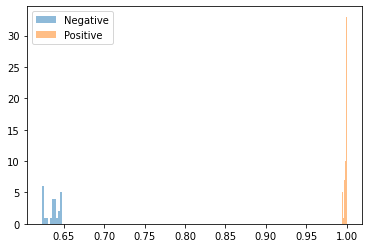

Average Difference between Positive and Negative Class: 0.3623799979686737


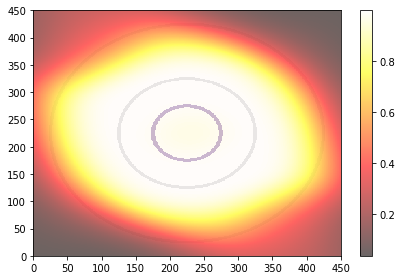

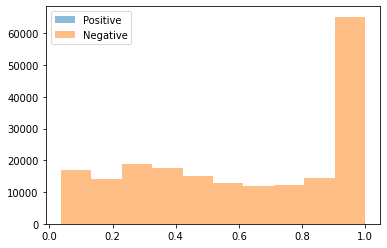

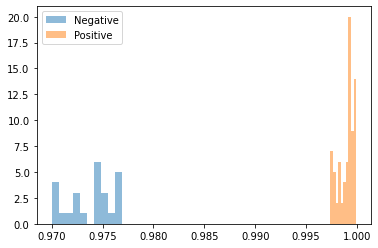

Average Difference between Positive and Negative Class: 0.025140000507235527


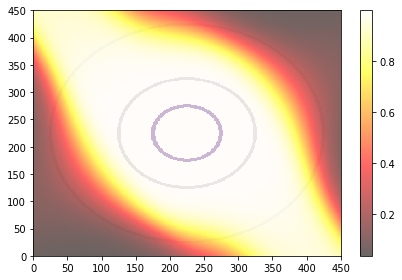

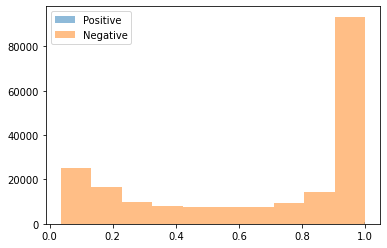

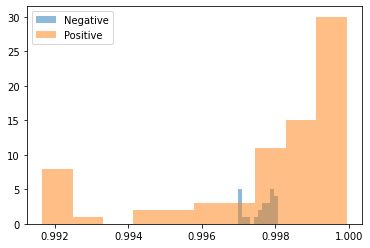

Average Difference between Positive and Negative Class: 0.0001900000061141327


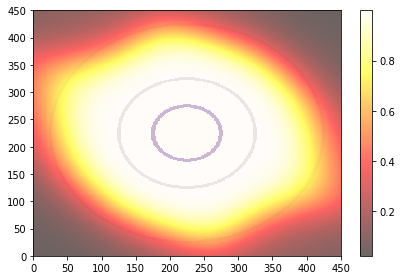

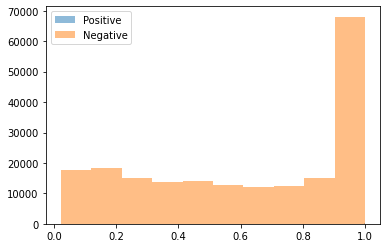

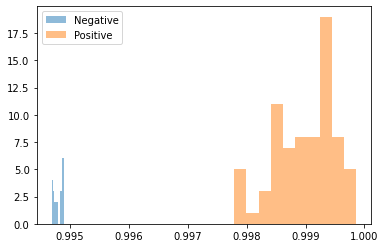

Average Difference between Positive and Negative Class: 0.004209999926388264


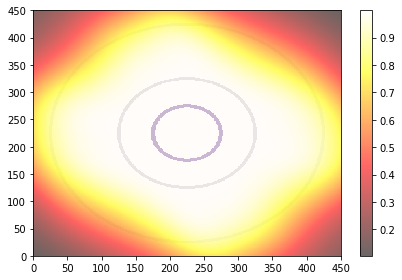

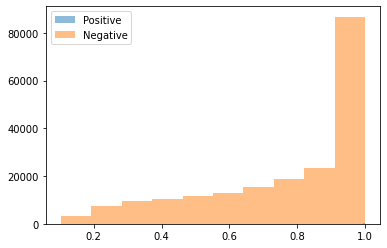

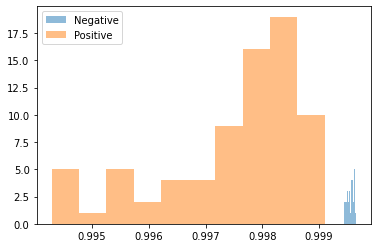

Average Difference between Positive and Negative Class: -0.0020600000862032175


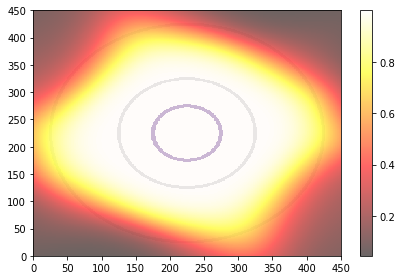

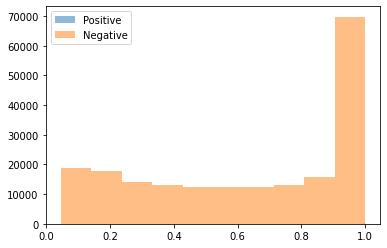

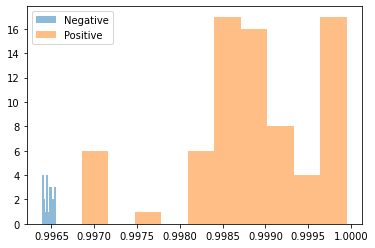

Average Difference between Positive and Negative Class: 0.002409999957308173


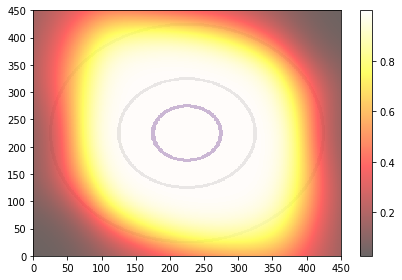

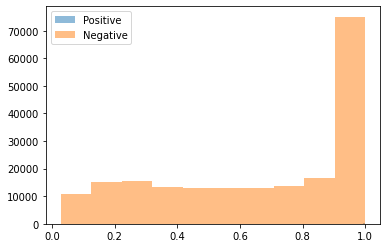

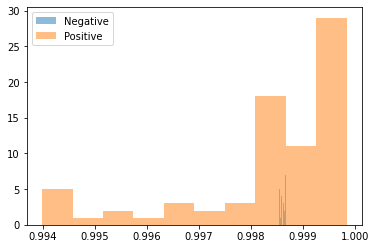

Average Difference between Positive and Negative Class: -0.0001900000061141327


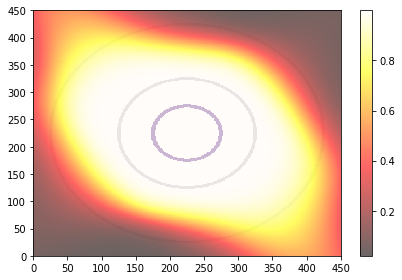

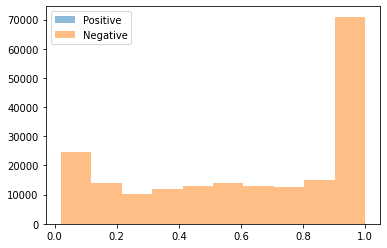

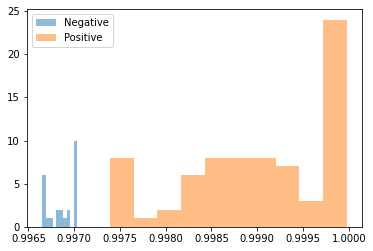

Average Difference between Positive and Negative Class: 0.00215000007301569


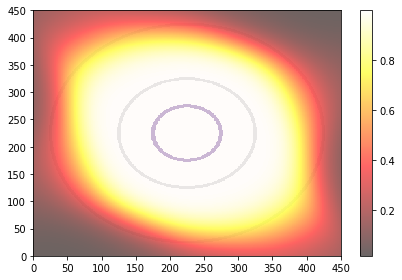

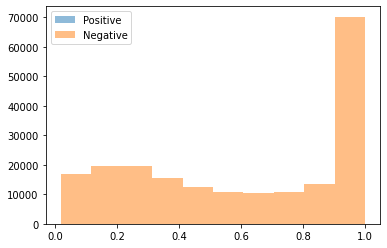

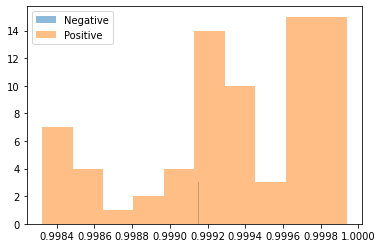

Average Difference between Positive and Negative Class: 0.00018000000272877514


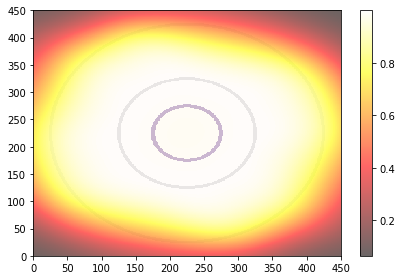

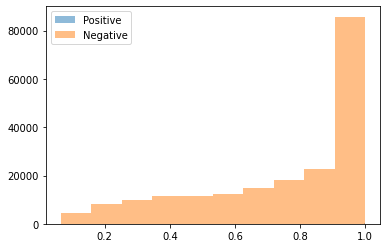

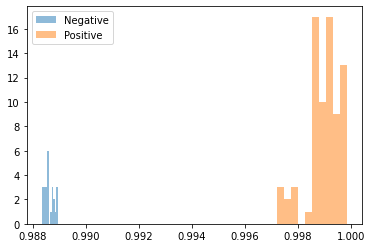

Average Difference between Positive and Negative Class: 0.010350000113248825


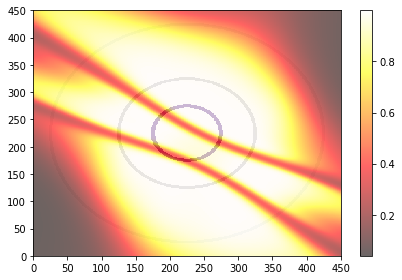

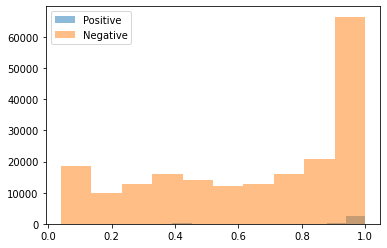

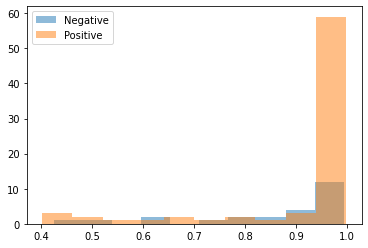

Average Difference between Positive and Negative Class: 0.06168000027537346


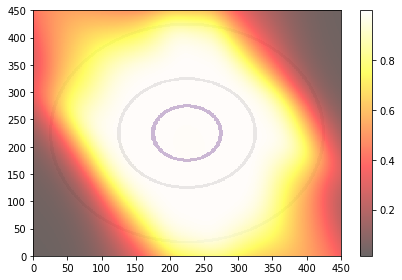

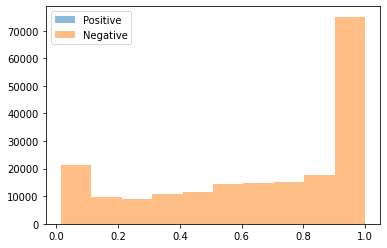

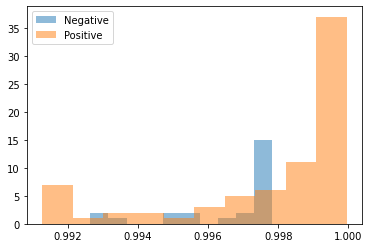

Average Difference between Positive and Negative Class: 0.001230000052601099


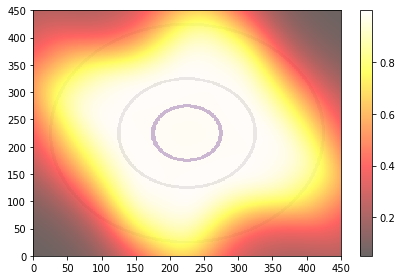

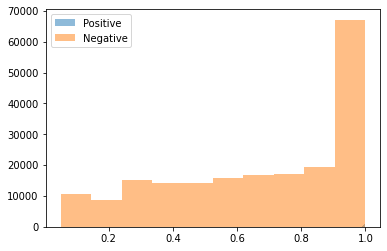

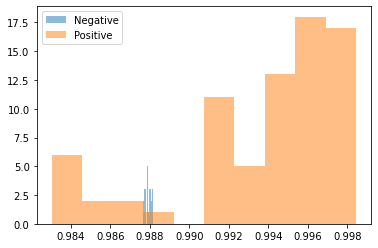

Average Difference between Positive and Negative Class: 0.005810000002384186


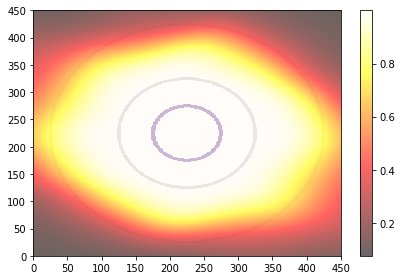

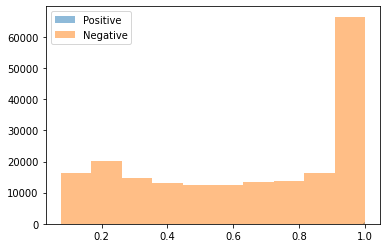

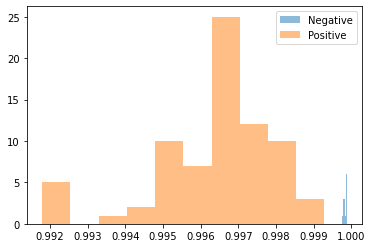

Average Difference between Positive and Negative Class: -0.00343000004068017


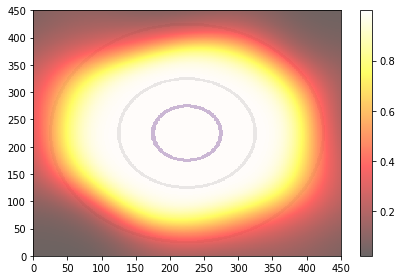

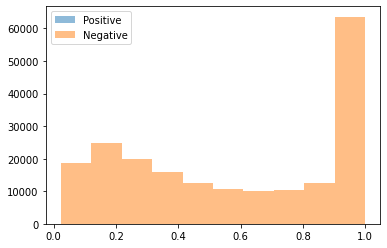

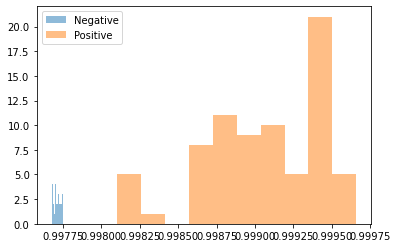

Average Difference between Positive and Negative Class: 0.0013599999947473407


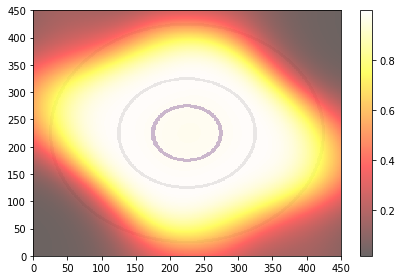

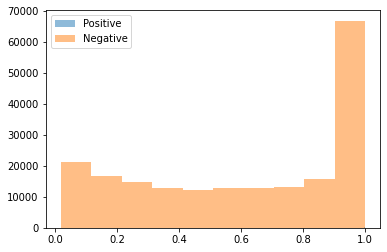

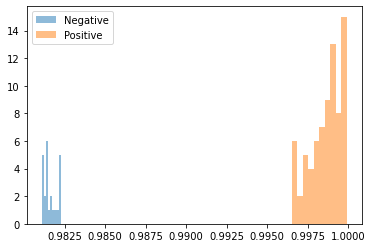

Average Difference between Positive and Negative Class: 0.017020000144839287


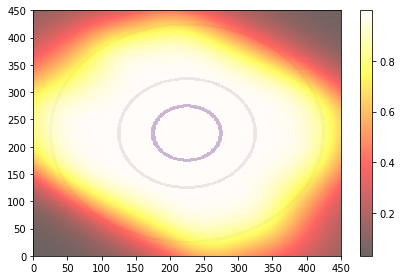

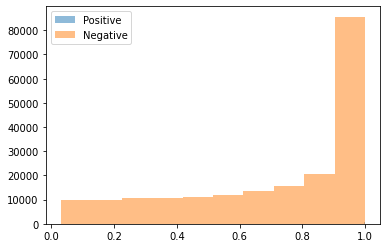

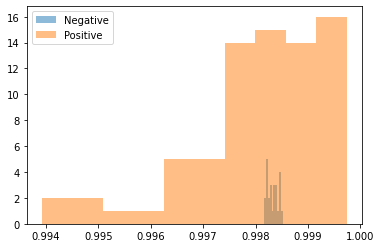

Average Difference between Positive and Negative Class: -0.0002300000051036477


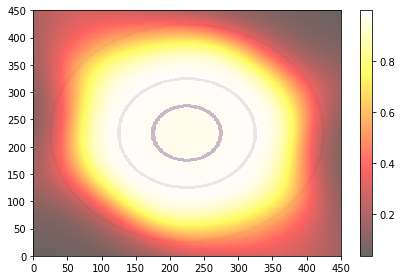

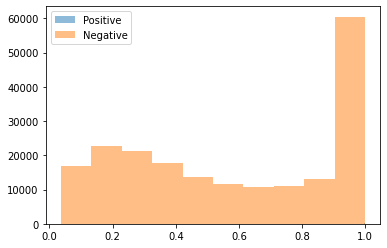

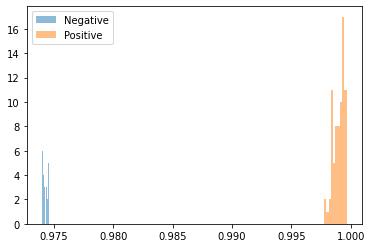

Average Difference between Positive and Negative Class: 0.0246799997985363


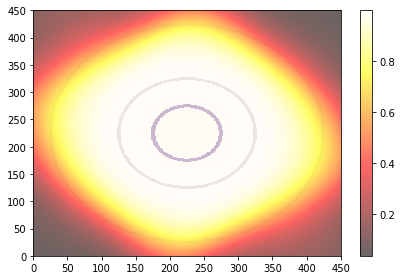

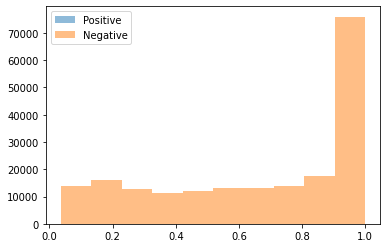

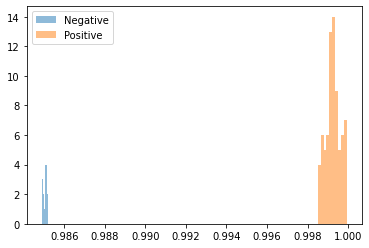

Average Difference between Positive and Negative Class: 0.014179999940097332


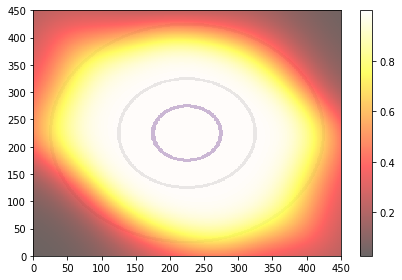

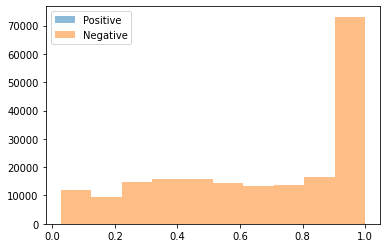

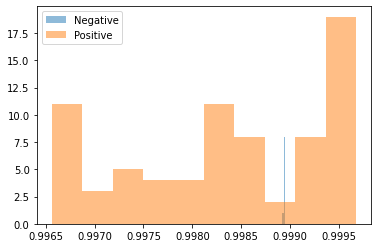

Average Difference between Positive and Negative Class: -0.0005799999926239252
AUPR (Train): 1.0+-1.0532500405730103e-16
AUPR (Test): 0.910878469188364+-0.13851891475400968
Average Distance between Means: 0.026324177160859108+-0.07848044484853745


([0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  0.9999999999999999],
 [0.9999999999999999,
  0.9999999999999999,
  0.9077607943849024,
  0.9999999999999999,
  0.5378450159997696,
  0.9999999999999999,
  0.8661189690766729,
  0.9999999999999999,
  0.9297582002706897,
  0.9999999999999999,
  0.9222762312893867,
  0.925274950016758,
  0.9648791765511131,
  0.5378602200379622,
  1.0,
  0.9999999999999999,
  0.8374290276993681,
  0.9999999999999999,
  1.0,
  0.7883667984406598],
 [0.362378,
  0.025140285,
  0.00018703938,
  0.004209757,
  -0.0020554066,
  0.0024052262,
  -0.00018763542,
  0.0021458864,
  0.00017565489,
  0.010350585,
  0.061678052,
  0.00

In [10]:
# RBF2b w BCE
separation = "RBF"
bumped = "b"
sigma = 0.5
hidden_layers = 2
train = False    # train sigma. if NA, then False

verbose = 0      # can change this to 0 to suppress verbosity during training
plot = False
shuffle = False
val_split = 0.1

auprs_train = []
auprs_test = []
diff_means = []

# Train and Evaluate the Model
for i in range(20):
    
    # Create the model
    tf.keras.utils.set_random_seed(i)
    model = create_model(separation, activation=bumped, hidden_layers=hidden_layers,
                 sigma=sigma, train=train, loss='binary_crossentropy',
                 seed=i)
    
    # Train the model
    aupr_train, aupr_test, diff_mean = train_eval(model, X, y, x_test, y_test, 
               train=train, verbose=verbose, shuffle=shuffle, plot=plot,
               val_split=val_split, callbacks=[early_stopping], seed=i, diff=True)
    
    auprs_train.append(aupr_train)
    auprs_test.append(aupr_test)
    diff_means.append(diff_mean)
    
print(f"AUPR (Train): {np.mean(auprs_train)}+-{np.std(auprs_train)}")
print(f"AUPR (Test): {np.mean(auprs_test)}+-{np.std(auprs_test)}")
print(f"Average Distance between Means: {np.mean(diff_means)}+-{np.std(diff_means)}")
auprs_train, auprs_test, diff_means

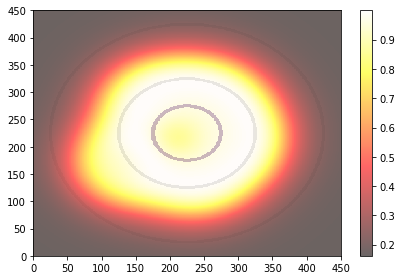

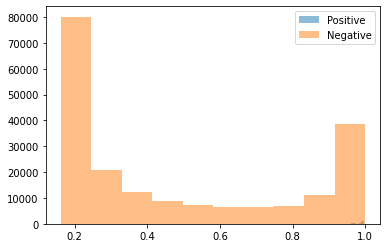

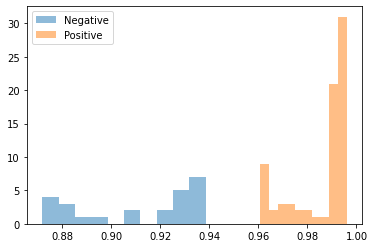

Average Difference between Positive and Negative Class: 0.07423000037670135


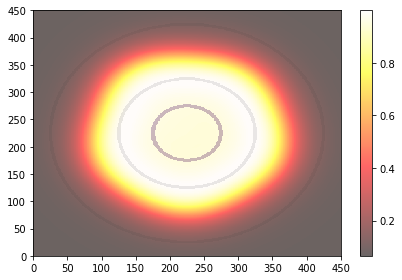

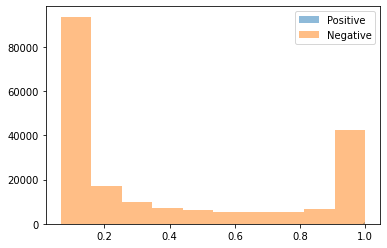

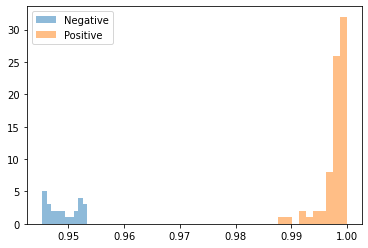

Average Difference between Positive and Negative Class: 0.04885999858379364


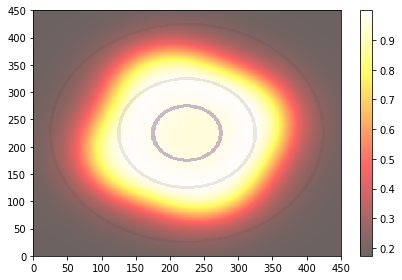

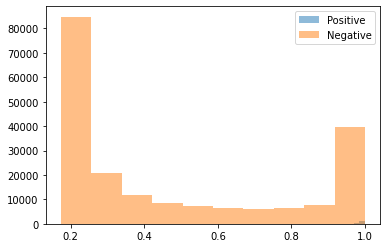

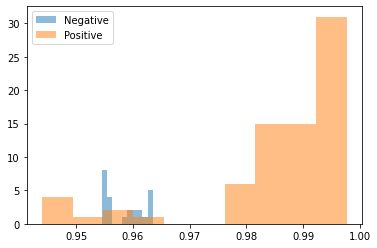

Average Difference between Positive and Negative Class: 0.02751000039279461


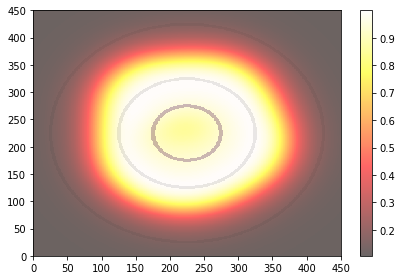

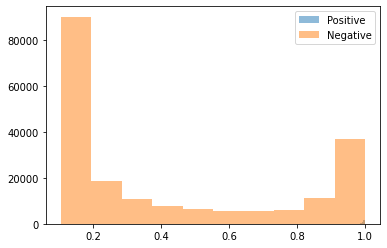

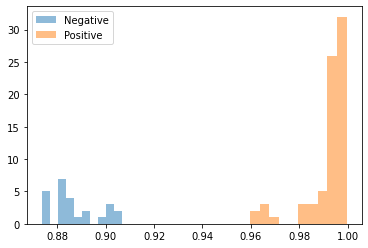

Average Difference between Positive and Negative Class: 0.10480000078678131


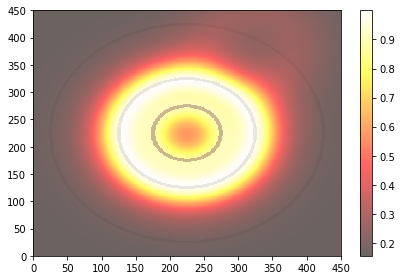

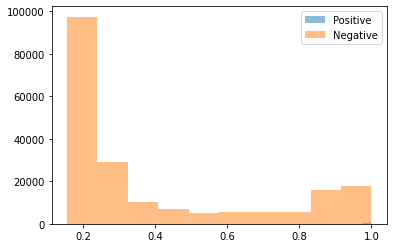

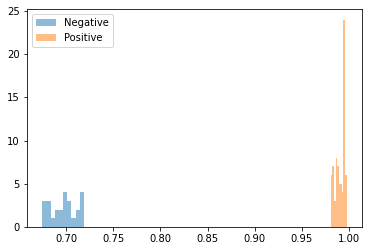

Average Difference between Positive and Negative Class: 0.2927300035953522


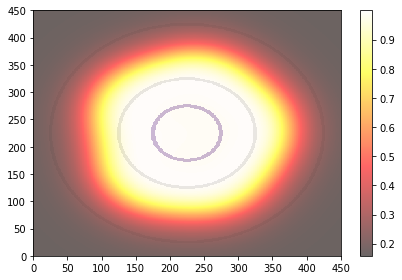

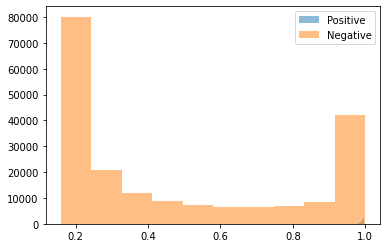

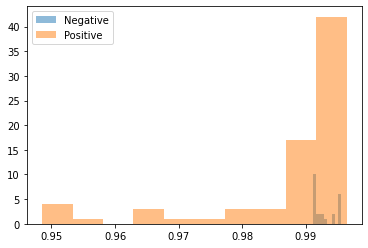

Average Difference between Positive and Negative Class: -0.005049999803304672


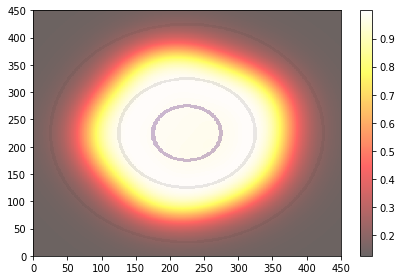

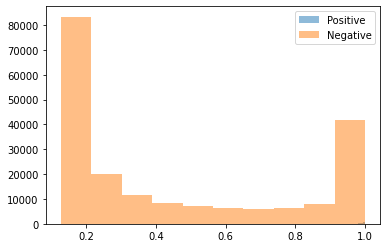

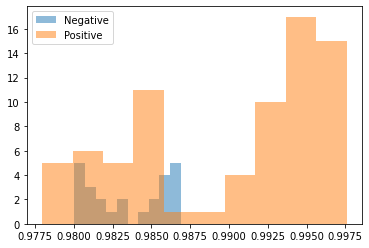

Average Difference between Positive and Negative Class: 0.006390000227838755


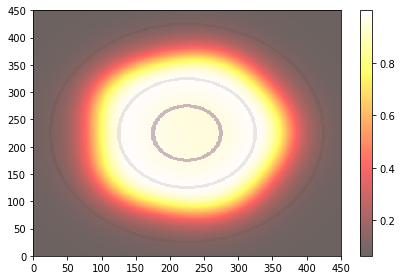

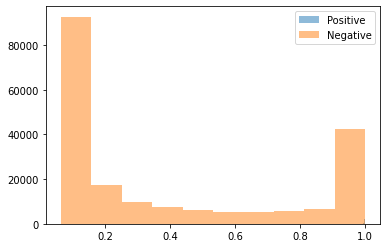

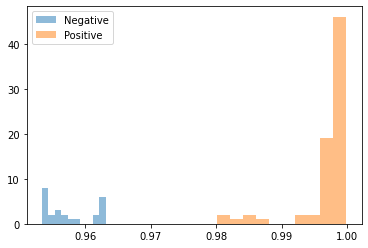

Average Difference between Positive and Negative Class: 0.03968000039458275


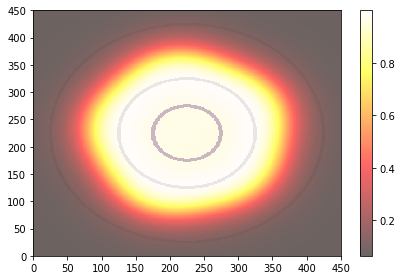

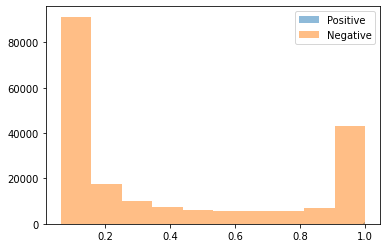

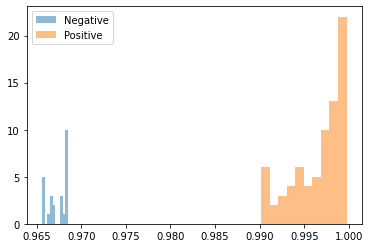

Average Difference between Positive and Negative Class: 0.029260000213980675


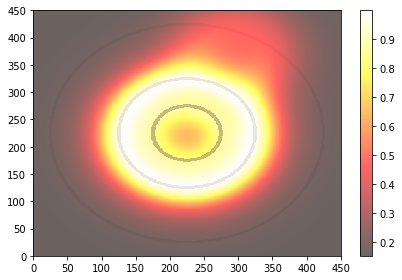

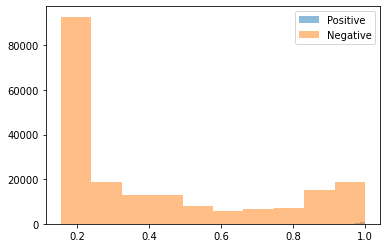

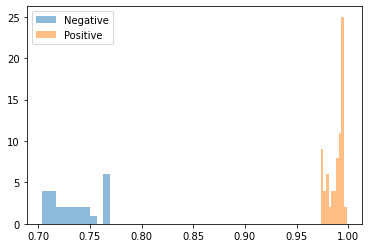

Average Difference between Positive and Negative Class: 0.2535800039768219


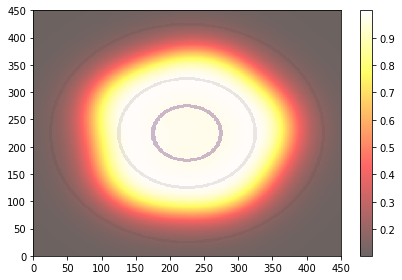

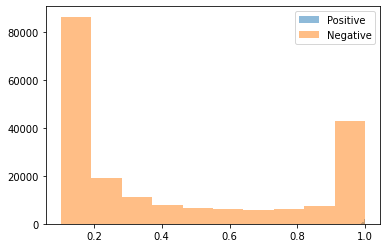

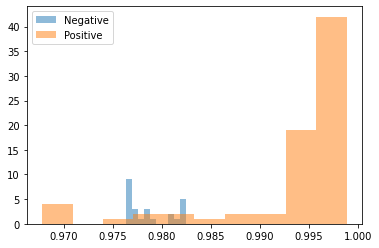

Average Difference between Positive and Negative Class: 0.014680000022053719


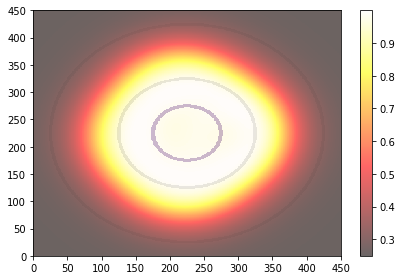

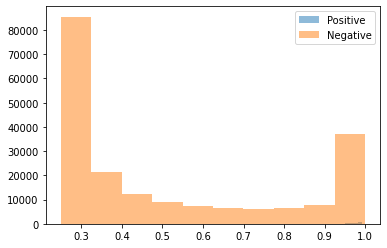

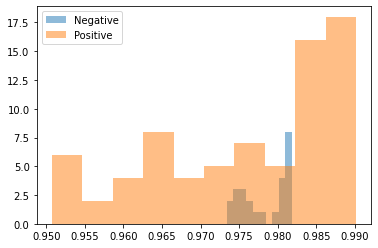

Average Difference between Positive and Negative Class: -0.002420000033453107


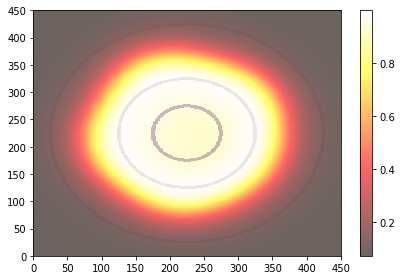

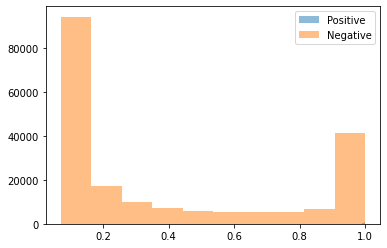

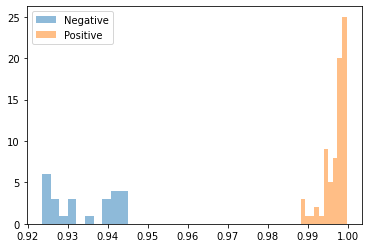

Average Difference between Positive and Negative Class: 0.0630899965763092


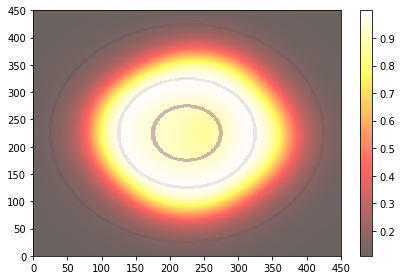

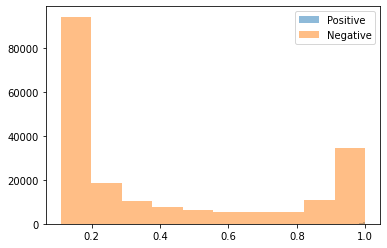

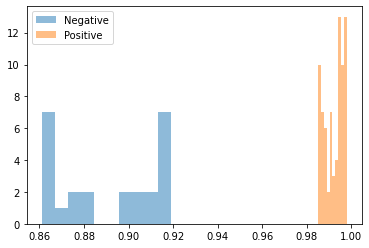

Average Difference between Positive and Negative Class: 0.10092999786138535


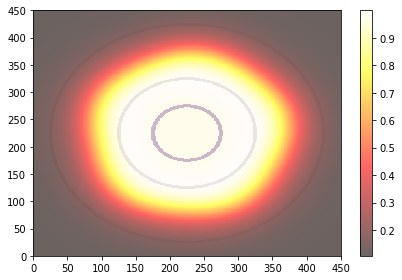

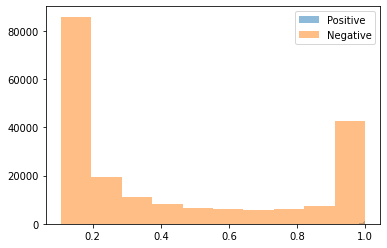

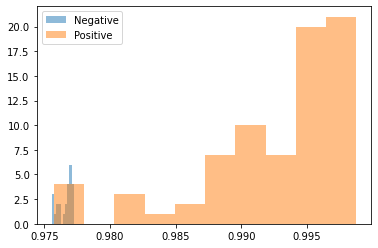

Average Difference between Positive and Negative Class: 0.016019999980926514


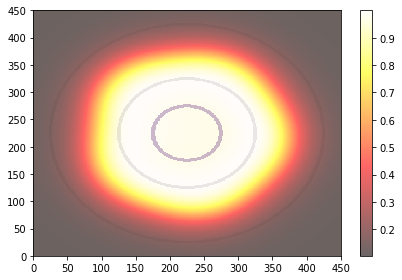

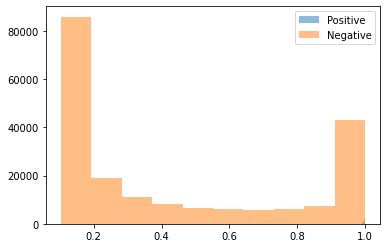

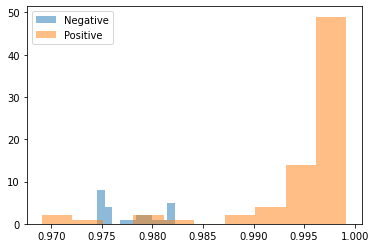

Average Difference between Positive and Negative Class: 0.017079999670386314


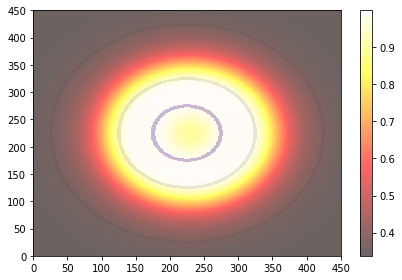

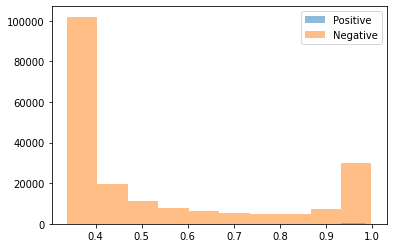

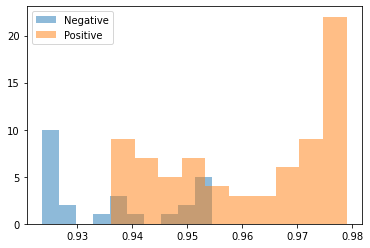

Average Difference between Positive and Negative Class: 0.02524000033736229


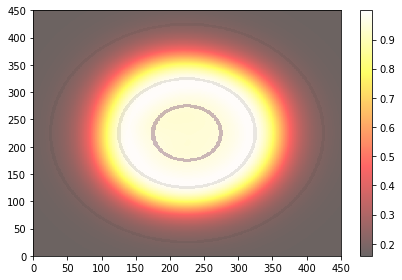

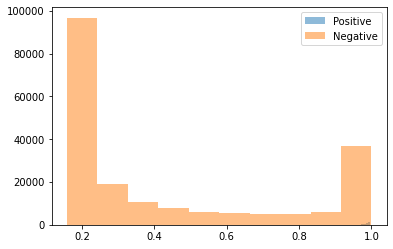

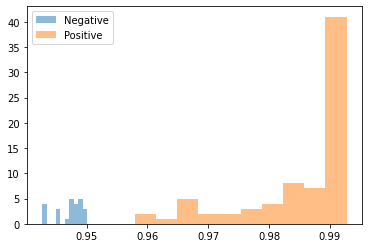

Average Difference between Positive and Negative Class: 0.03824999928474426


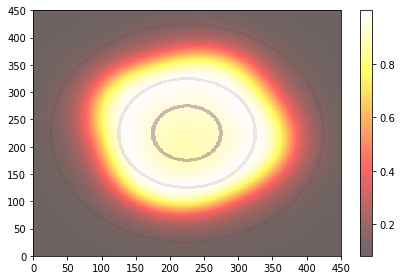

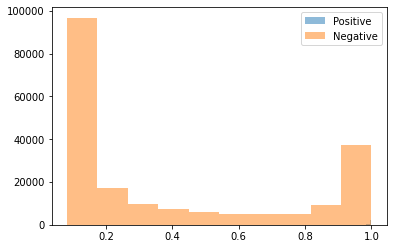

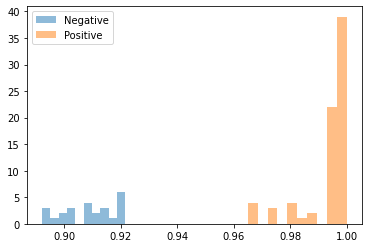

Average Difference between Positive and Negative Class: 0.08427000045776367


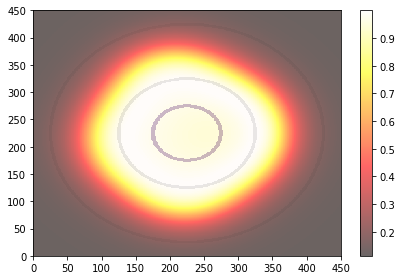

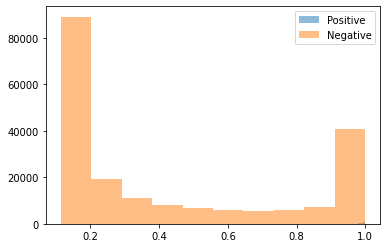

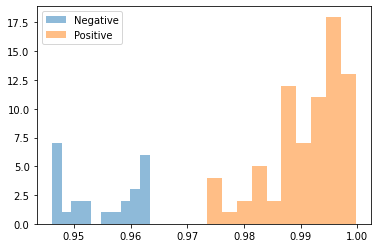

Average Difference between Positive and Negative Class: 0.03626000136137009
AUPR (Train): 0.9999999999999998+-1.1102230246251565e-16
AUPR (Test): 0.9709505849767897+-0.06143146363673788
Average Distance between Means: 0.06327065080404282+-0.07665494829416275


([0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999],
 [0.9999999999999999,
  0.9999999999999999,
  0.9787185522255132,
  0.9999999999999999,
  1.0,
  0.7549200184134511,
  0.9291672948642454,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9790426529171121,
  0.8444877045792546,
  1.0,
  0.9999999999999999,
  0.98901410873169,
  0.98745918790284,
  0.9562021799016908,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999],
 [0.07422614,
  0.048864543,
  0.02751112,
  0.10480398,
  0.29272616,
  -0.0050456524,
  0.0063937902,
  0.039684534,
  0.029255211,
  0.25358492,
  0.

In [11]:
# RBF2r with bce
separation = "RBF"
bumped = "r"
sigma = 0.5
hidden_layers = 2
train = False    # train sigma. if NA, then False

verbose = 0      # can change this to 0 to suppress verbosity during training
plot = False
shuffle = False
val_split = 0.1

auprs_train = []
auprs_test = []
diff_means = []

# Train and Evaluate the Model
for i in range(20):
    
    # Create the model
    tf.keras.utils.set_random_seed(i)
    model = create_model(separation, activation=bumped, hidden_layers=hidden_layers,
                 sigma=sigma, train=train, loss='binary_crossentropy',
                 seed=i)
    
    # Train the model
    aupr_train, aupr_test, diff_mean = train_eval(model, X, y, x_test, y_test, 
               train=train, verbose=verbose, shuffle=shuffle, plot=plot,
               val_split=val_split, callbacks=[early_stopping], seed=i, diff=True)
    
    auprs_train.append(aupr_train)
    auprs_test.append(aupr_test)
    diff_means.append(diff_mean)
    
print(f"AUPR (Train): {np.mean(auprs_train)}+-{np.std(auprs_train)}")
print(f"AUPR (Test): {np.mean(auprs_test)}+-{np.std(auprs_test)}")
print(f"Average Distance between Means: {np.mean(diff_means)}+-{np.std(diff_means)}")
auprs_train, auprs_test, diff_means

## Equality Separation

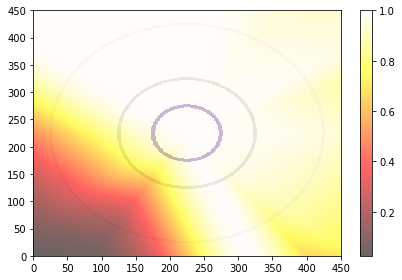

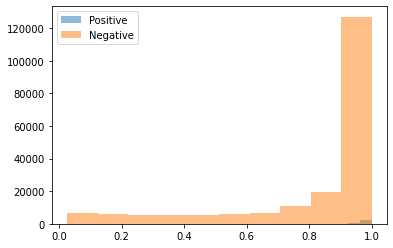

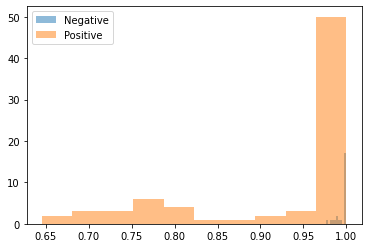

Average Difference between Positive and Negative Class: -0.0715399980545044


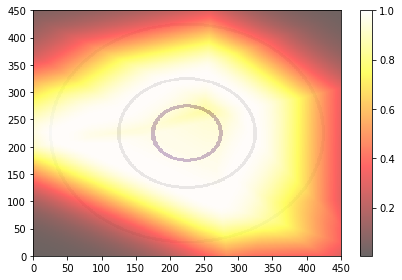

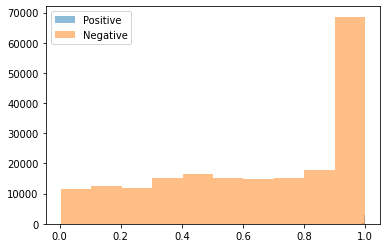

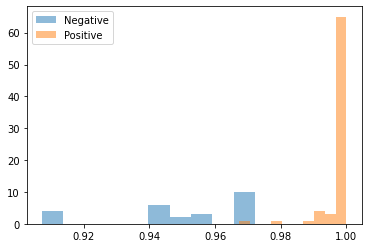

Average Difference between Positive and Negative Class: 0.04751000180840492


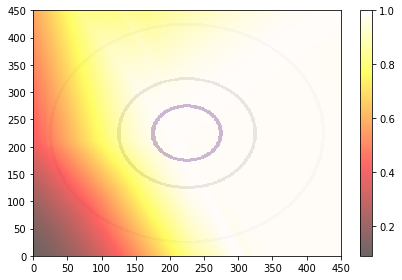

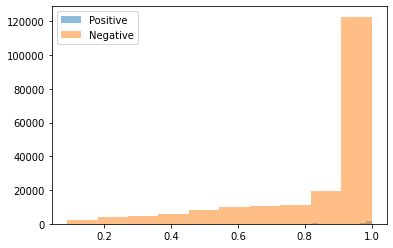

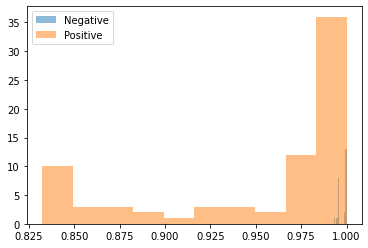

Average Difference between Positive and Negative Class: -0.04718000069260597


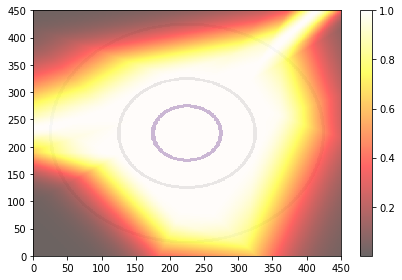

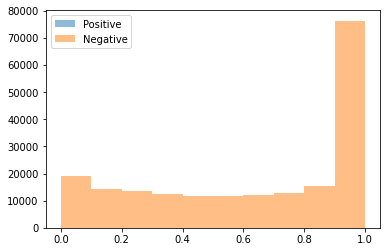

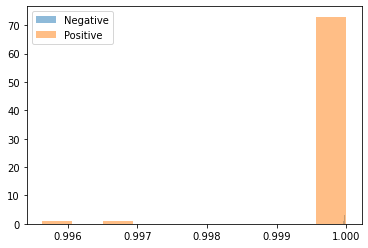

Average Difference between Positive and Negative Class: -9.999999747378752e-05


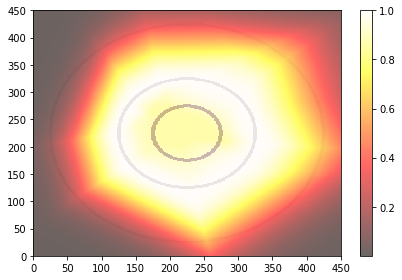

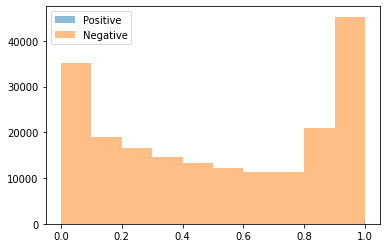

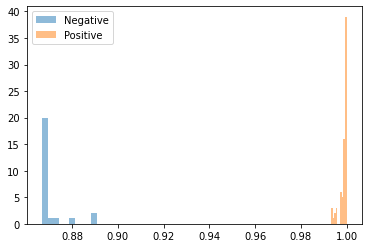

Average Difference between Positive and Negative Class: 0.1285099983215332


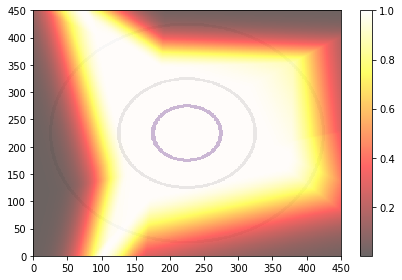

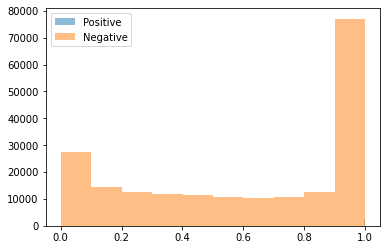

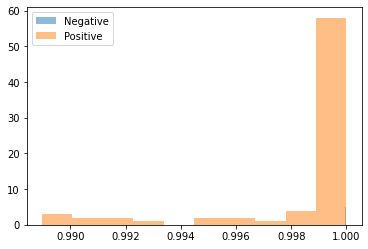

Average Difference between Positive and Negative Class: -0.0014199999859556556


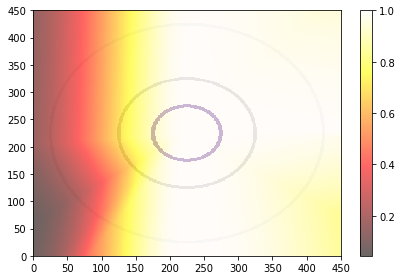

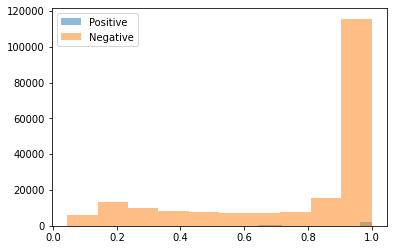

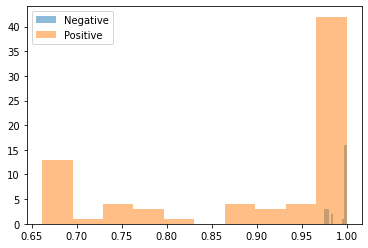

Average Difference between Positive and Negative Class: -0.09531000256538391


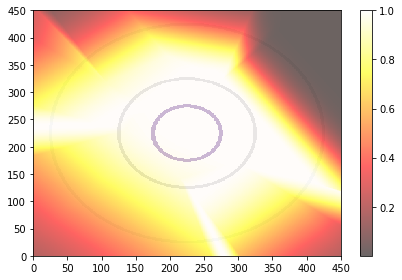

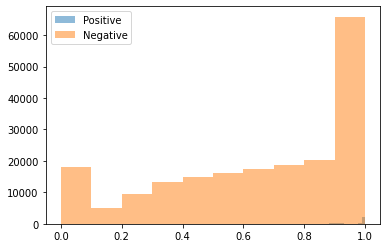

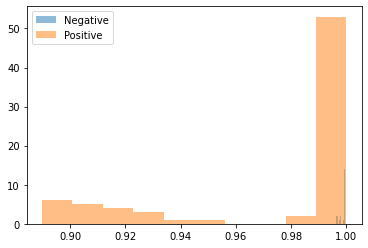

Average Difference between Positive and Negative Class: -0.024070000275969505


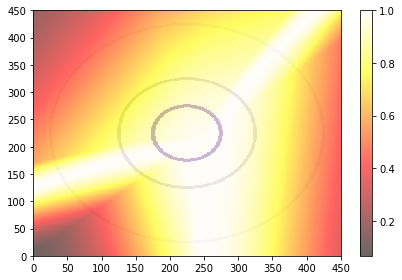

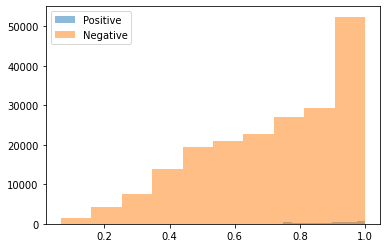

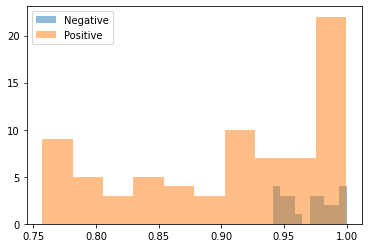

Average Difference between Positive and Negative Class: -0.0649000033736229


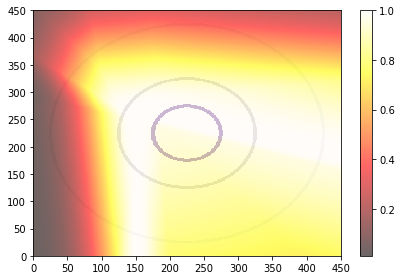

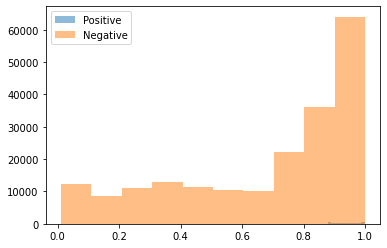

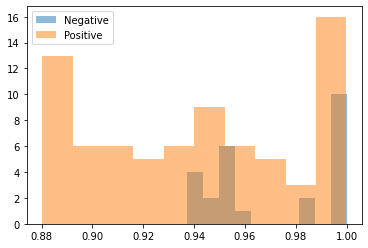

Average Difference between Positive and Negative Class: -0.031369999051094055


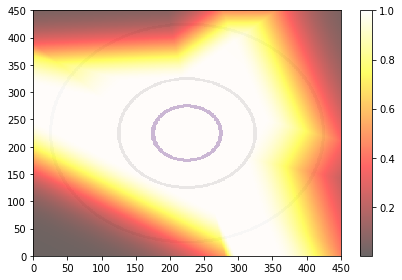

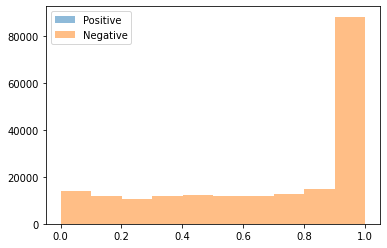

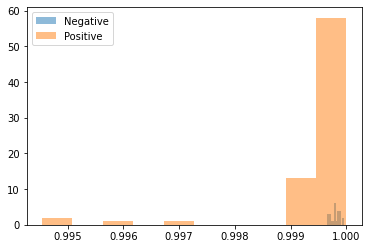

Average Difference between Positive and Negative Class: -0.0003600000054575503


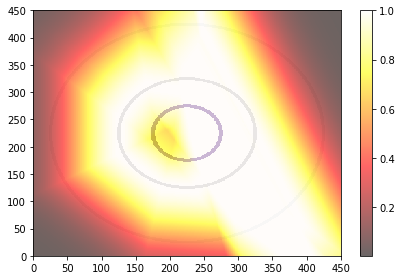

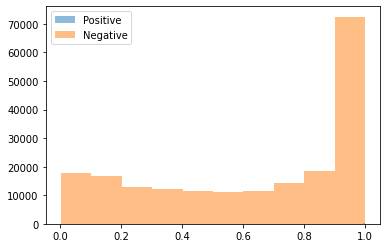

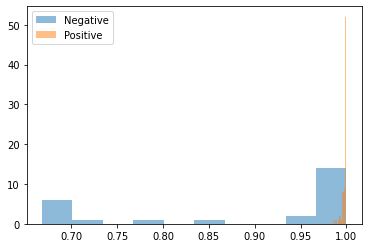

Average Difference between Positive and Negative Class: 0.10575000196695328


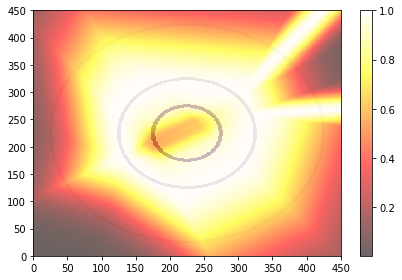

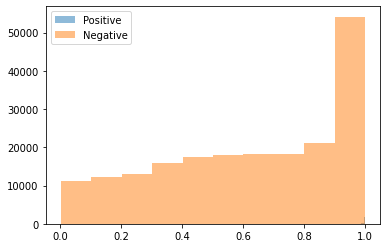

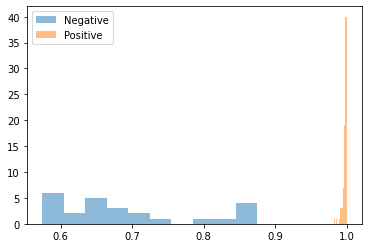

Average Difference between Positive and Negative Class: 0.30564001202583313


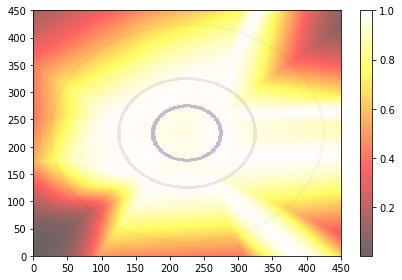

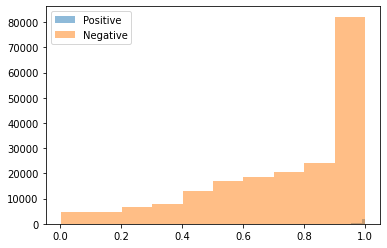

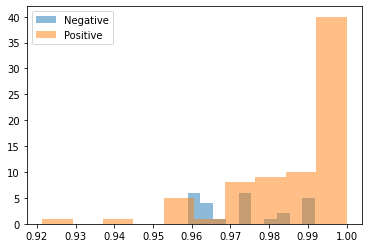

Average Difference between Positive and Negative Class: 0.014059999957680702


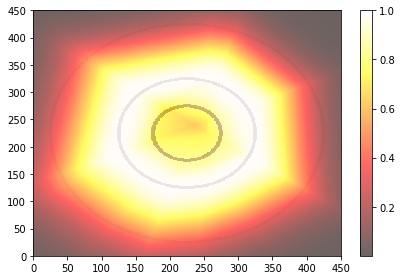

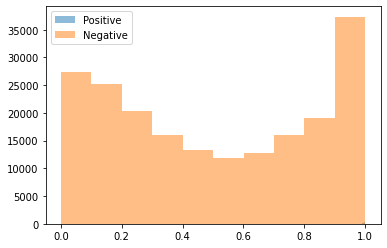

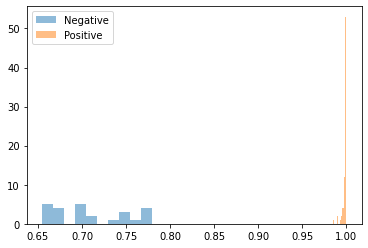

Average Difference between Positive and Negative Class: 0.2888599932193756


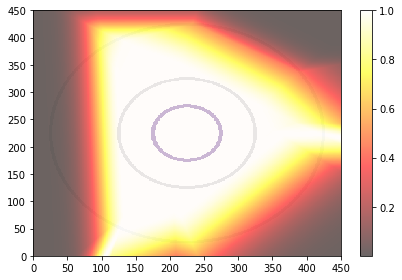

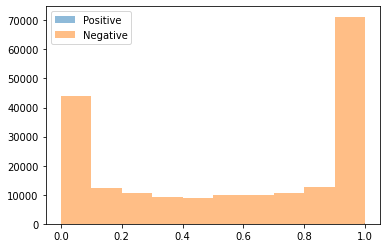

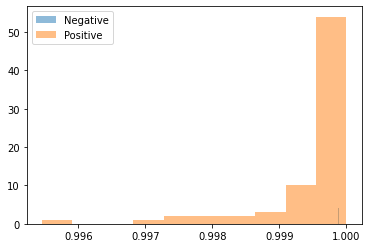

Average Difference between Positive and Negative Class: -0.00033999999868683517


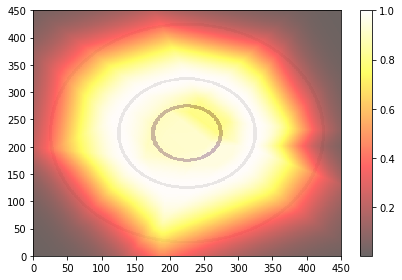

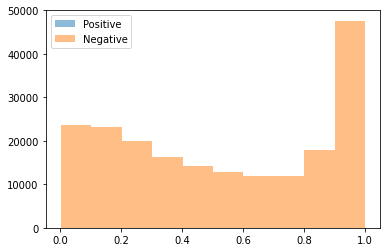

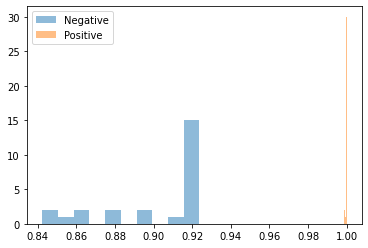

Average Difference between Positive and Negative Class: 0.09740000218153


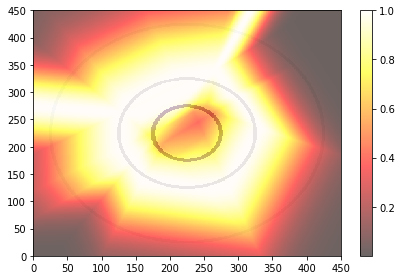

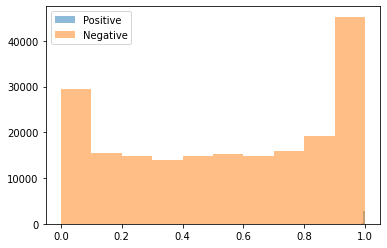

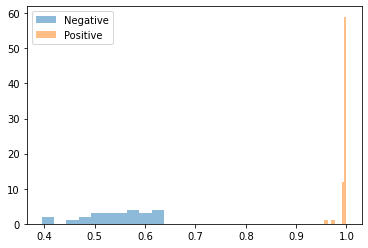

Average Difference between Positive and Negative Class: 0.4524900019168854


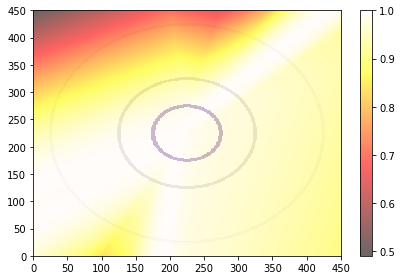

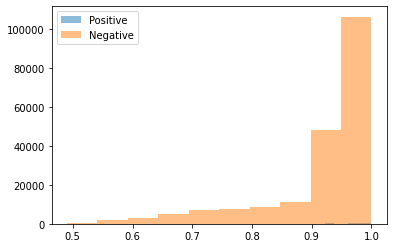

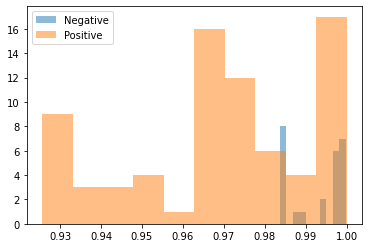

Average Difference between Positive and Negative Class: -0.023360000923275948


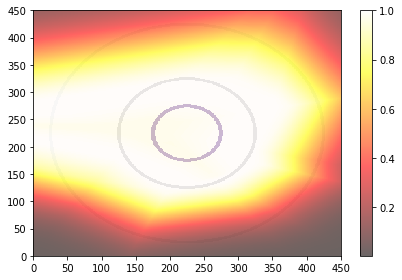

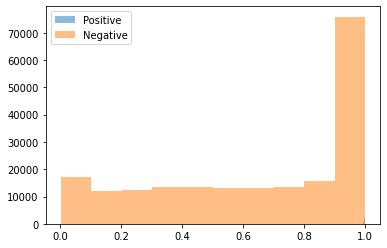

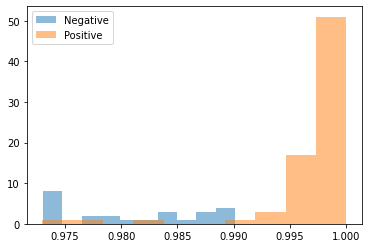

Average Difference between Positive and Negative Class: 0.016340000554919243
AUPR (Train): 0.9848617994510116+-0.02924941504696383
AUPR (Test): 0.8295525895823855+-0.15253569876942946
Average Distance between Means: 0.05483156442642212+-0.13858839869499207


([0.8982912354665629,
  0.9999999999999999,
  0.9487391308280013,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  0.9380882287353528,
  1.0,
  0.9954431540875137,
  0.9847577087426079,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  0.9319165311601951,
  0.9999999999999999],
 [0.6969245726779376,
  0.9987070232148104,
  0.5610734419058462,
  0.9085992991583767,
  0.9999999999999999,
  0.7657075064699681,
  0.6141448062056474,
  0.7834471045425476,
  0.6634147842124801,
  0.6206544739945145,
  0.7308647280037367,
  0.8068328161155341,
  0.9999999999999999,
  0.9289725581561492,
  1.0,
  0.847318926107347,
  1.0,
  0.9999999999999999,
  0.6721381571606329,
  0.9922515937221819],
 [-0.07154018,
  0.04751408,
  -0.04718393,
  -9.953976e-05,
  0.12851453,
  -0.0014228225,
  -0.095311105,
  -0.024065256,
  -0.06489688,
  -0.03136617,
  -0.00036138296,
  0.105752826,
  0.30564356,
  0.0140

In [12]:
# ES2 with BCE fixed sigma=0.5
separation = "ES"
bumped = ""
sigma = 0.5
hidden_layers = 2
train = False    # train sigma. if NA, then False

verbose = 0      # can change this to 0 to suppress verbosity during training
plot = False
shuffle = False
val_split = 0.1

auprs_train = []
auprs_test = []
diff_means = []

# Train and Evaluate the Model
for i in range(20):
    
    # Create the model
    tf.keras.utils.set_random_seed(i)
    model = create_model(separation, activation=bumped, hidden_layers=hidden_layers,
                 sigma=sigma, train=train, loss='binary_crossentropy',
                 seed=i)
    
    # Train the model
    aupr_train, aupr_test, diff_mean = train_eval(model, X, y, x_test, y_test, 
               train=train, verbose=verbose, shuffle=shuffle, plot=plot,
               val_split=val_split, callbacks=[early_stopping], seed=i, diff=True)
    
    auprs_train.append(aupr_train)
    auprs_test.append(aupr_test)
    diff_means.append(diff_mean)
    
print(f"AUPR (Train): {np.mean(auprs_train)}+-{np.std(auprs_train)}")
print(f"AUPR (Test): {np.mean(auprs_test)}+-{np.std(auprs_test)}")
print(f"Average Distance between Means: {np.mean(diff_means)}+-{np.std(diff_means)}")
auprs_train, auprs_test, diff_means

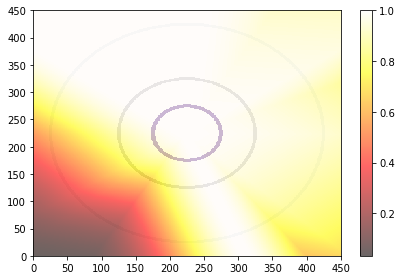

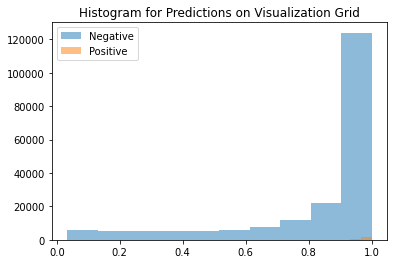

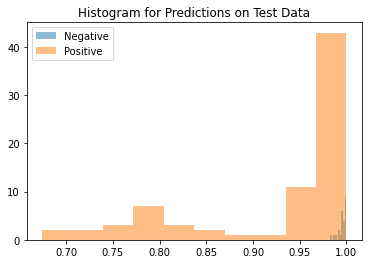

Average Difference between Positive and Negative Class: -0.06713581085205078


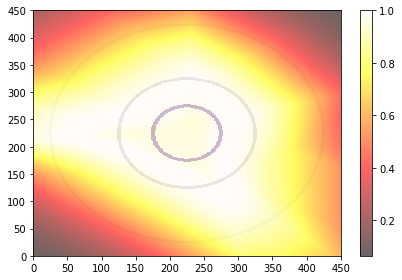

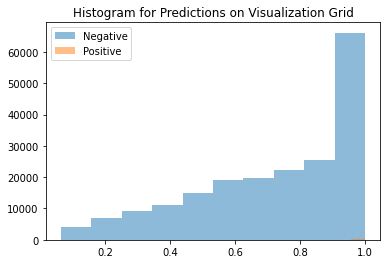

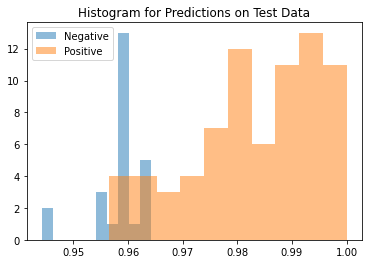

Average Difference between Positive and Negative Class: 0.025031566619873047


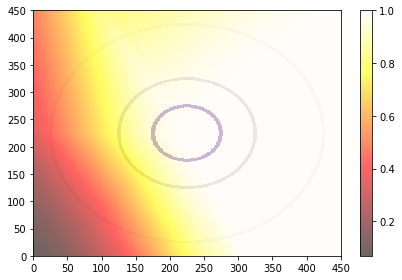

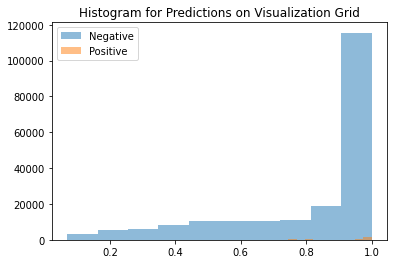

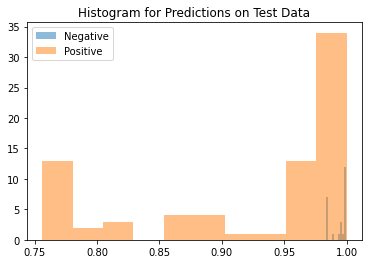

Average Difference between Positive and Negative Class: -0.07075077295303345


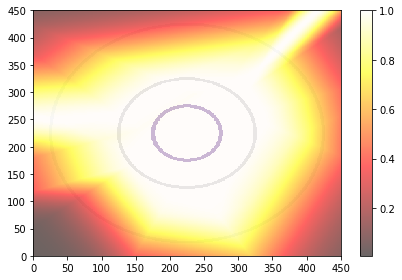

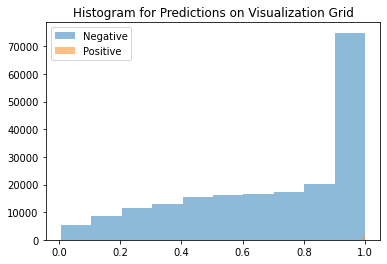

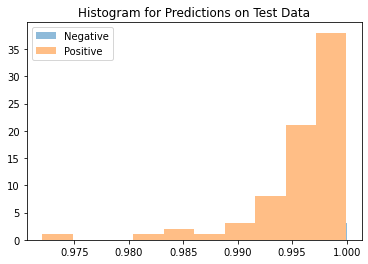

Average Difference between Positive and Negative Class: -0.0035036802291870117


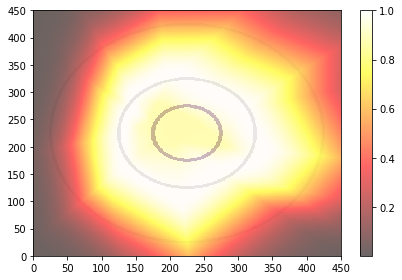

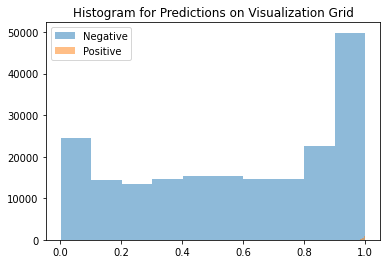

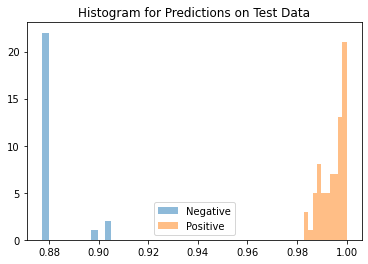

Average Difference between Positive and Negative Class: 0.11305707693099976


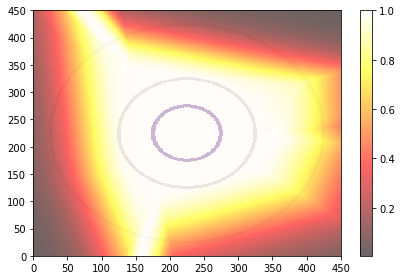

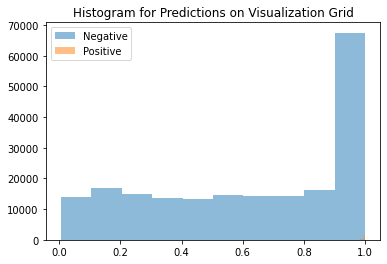

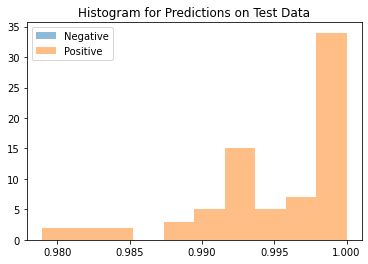

Average Difference between Positive and Negative Class: -0.004765331745147705


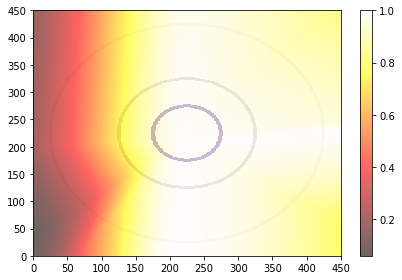

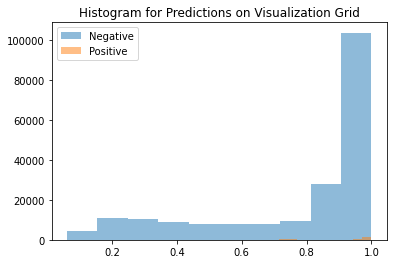

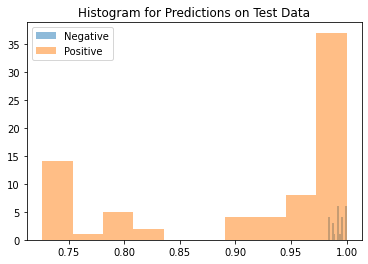

Average Difference between Positive and Negative Class: -0.08360934257507324


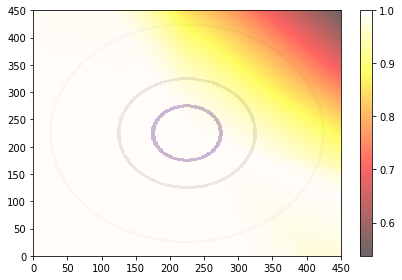

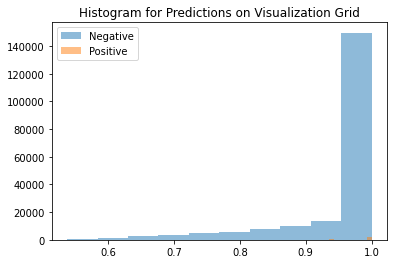

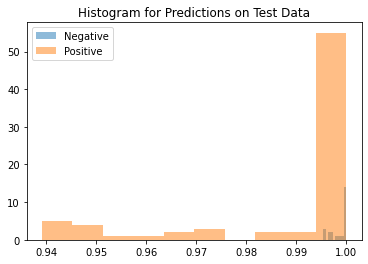

Average Difference between Positive and Negative Class: -0.009657859802246094


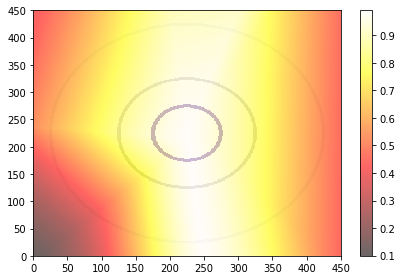

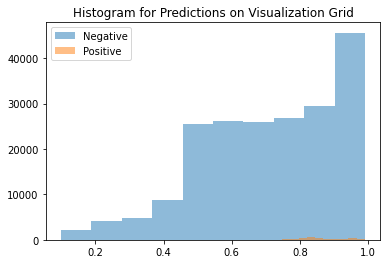

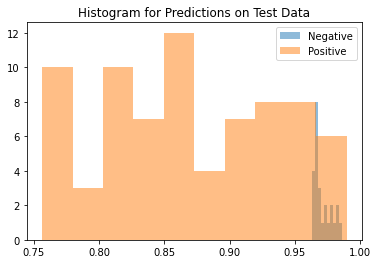

Average Difference between Positive and Negative Class: -0.10038405656814575


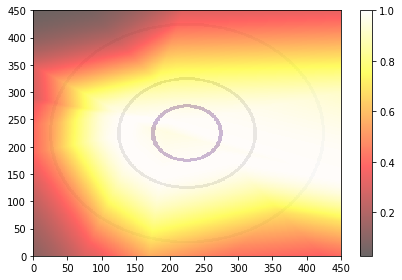

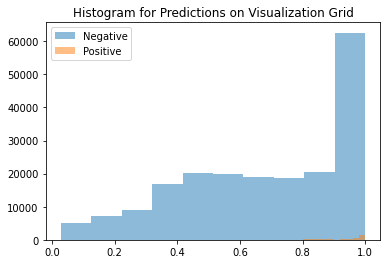

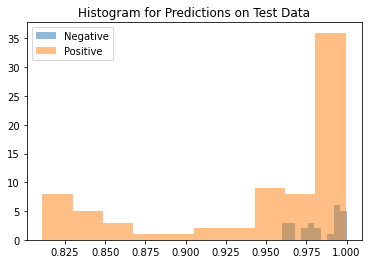

Average Difference between Positive and Negative Class: -0.03902703523635864


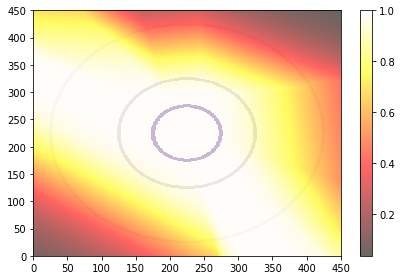

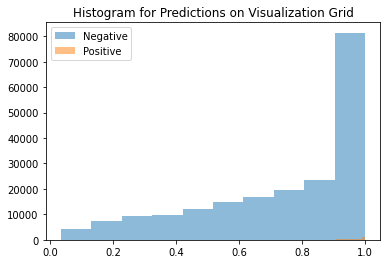

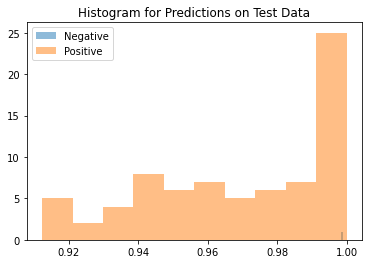

Average Difference between Positive and Negative Class: -0.028980791568756104


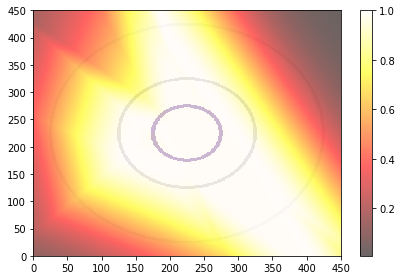

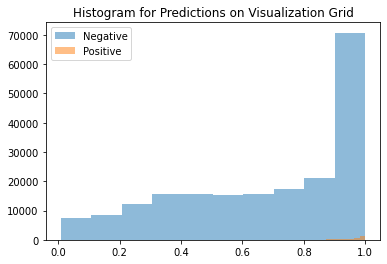

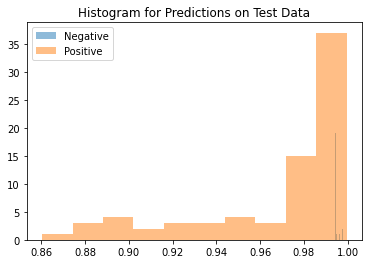

Average Difference between Positive and Negative Class: -0.02641773223876953


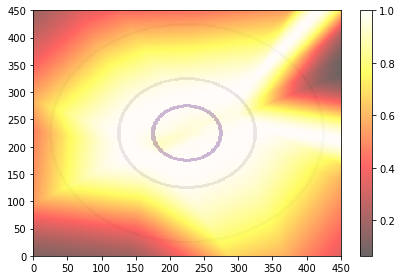

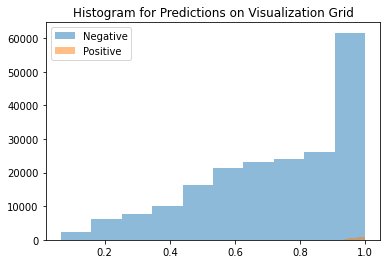

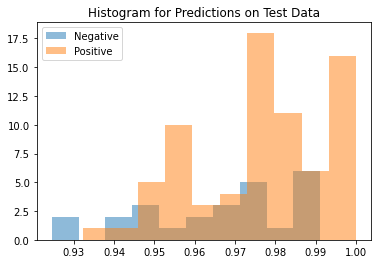

Average Difference between Positive and Negative Class: 0.01056051254272461


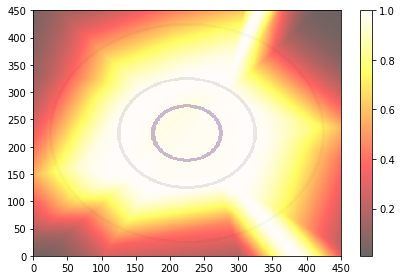

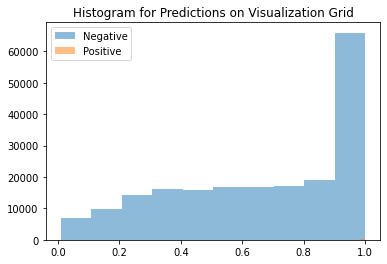

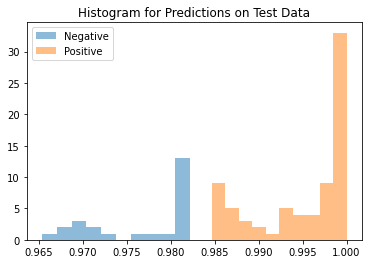

Average Difference between Positive and Negative Class: 0.01820063591003418


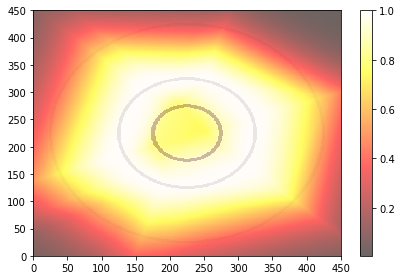

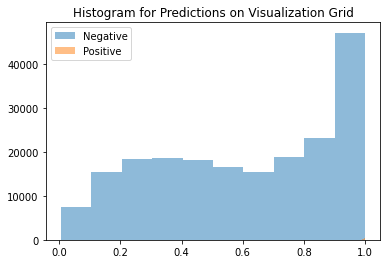

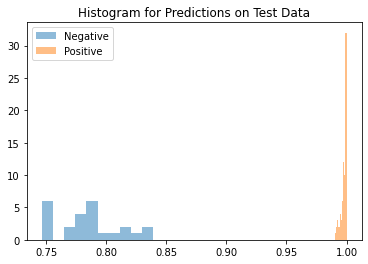

Average Difference between Positive and Negative Class: 0.21325808763504028


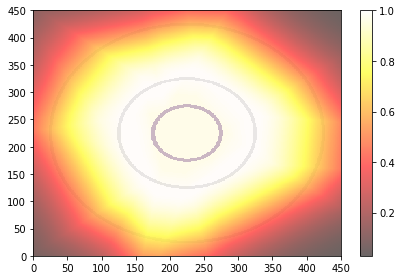

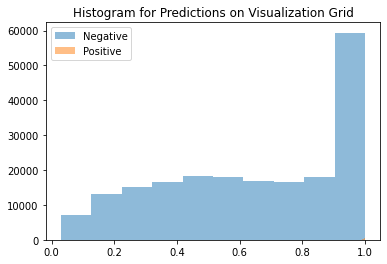

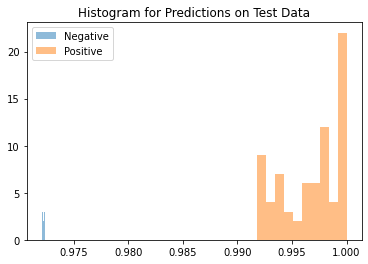

Average Difference between Positive and Negative Class: 0.024599432945251465


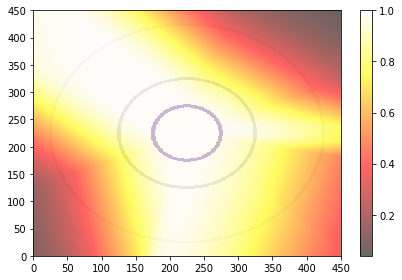

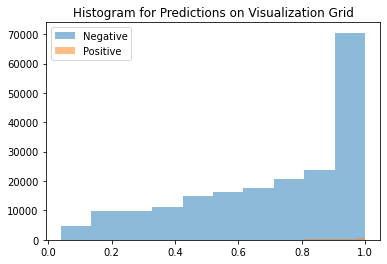

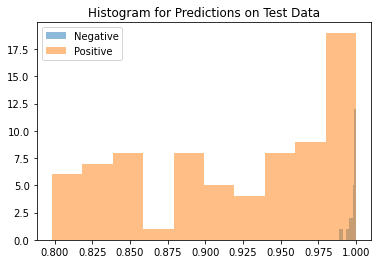

Average Difference between Positive and Negative Class: -0.07952648401260376


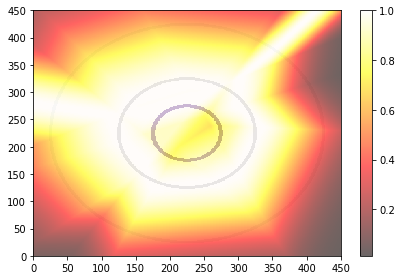

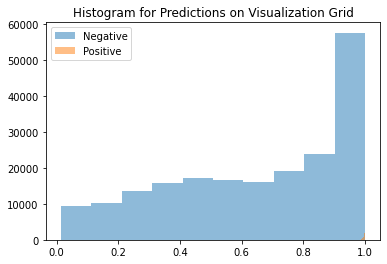

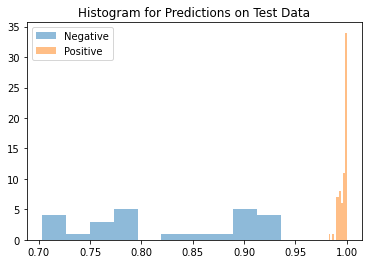

Average Difference between Positive and Negative Class: 0.17322778701782227


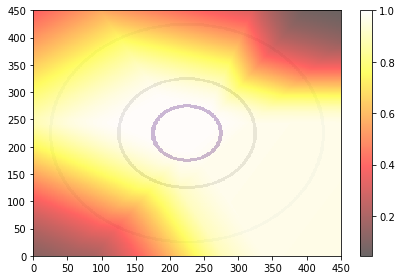

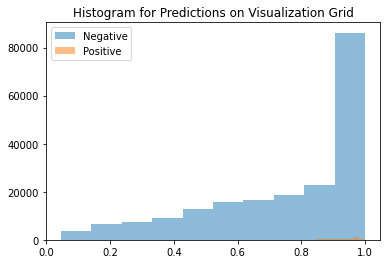

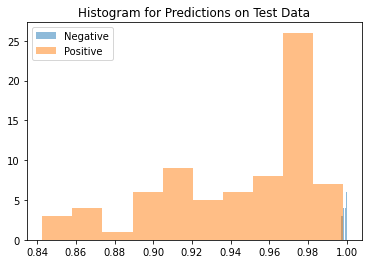

Average Difference between Positive and Negative Class: -0.05557364225387573


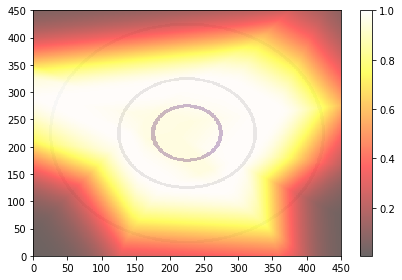

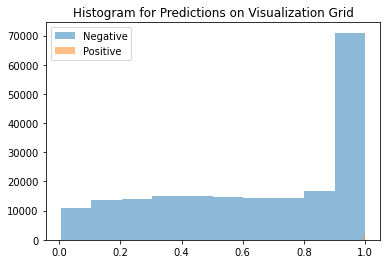

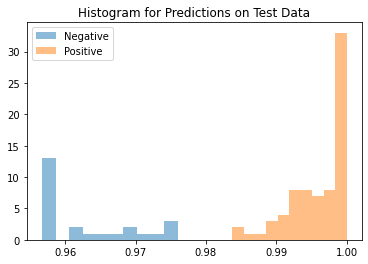

Average Difference between Positive and Negative Class: 0.03328704833984375
AUPR (Train): 0.9684939328765833+-0.057973685694397134
AUPR (Test): 0.7740083351872451+-0.17855440163393296
Average Distance between Means: 0.0020944804418832064+-0.08066783100366592


([0.8700172773308986,
  0.9999999999999999,
  0.7835119333984913,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  0.9333970173467232,
  0.8707963512293334,
  0.9727292388720798,
  0.9866252894095632,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9848581535428139,
  0.9999999999999999,
  0.9679433964017594,
  0.9999999999999999],
 [0.6296973453184653,
  0.989011530961735,
  0.7593417983700697,
  0.6612494371122767,
  0.9999999999999999,
  0.668565064222844,
  0.5859128516875464,
  0.7032242623343444,
  0.5784782337584046,
  0.6696251039264816,
  0.5874794203268002,
  0.6836586738698298,
  0.8620793062989469,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.5638477089128592,
  1.0,
  0.537995966644297,
  0.9999999999999999],
 [-0.06713581,
  0.025031567,
  -0.07075077,
  -0.0035036802,
  0.11305708,
  -0.0047653317,
  -0.08360934,
  -0.00965786,
  -0.10038406,
  -0.03902703

In [13]:
# ES2 with MSE fixed sigma=0.5
separation = "ES"
bumped = ""
sigma = 0.5
hidden_layers = 2
train = False    # train sigma. if NA, then False

verbose = 0      # can change this to 0 to suppress verbosity during training
plot = False
shuffle = False
val_split = 0.1

auprs_train = []
auprs_test = []
diff_means = []

# Train and Evaluate the Model
for i in range(20):
    
    # Create the model
    tf.keras.utils.set_random_seed(i)
    model = create_model(separation, activation=bumped, hidden_layers=hidden_layers,
                 sigma=sigma, train=train, loss='mse',
                 seed=i)
    
    # Train the model
    aupr_train, aupr_test, diff_mean = train_eval(model, X, y, x_test, y_test, 
               train=train, verbose=verbose, shuffle=shuffle, plot=plot,
               val_split=val_split, callbacks=[early_stopping], seed=i, diff=True)
    
    auprs_train.append(aupr_train)
    auprs_test.append(aupr_test)
    diff_means.append(diff_mean)
    
print(f"AUPR (Train): {np.mean(auprs_train)}+-{np.std(auprs_train)}")
print(f"AUPR (Test): {np.mean(auprs_test)}+-{np.std(auprs_test)}")
print(f"Average Distance between Means: {np.mean(diff_means)}+-{np.std(diff_means)}")
auprs_train, auprs_test, diff_means

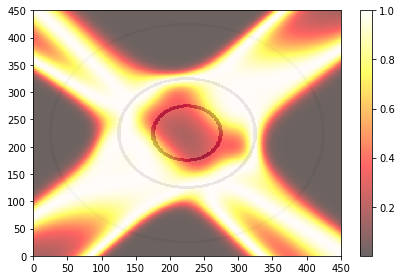

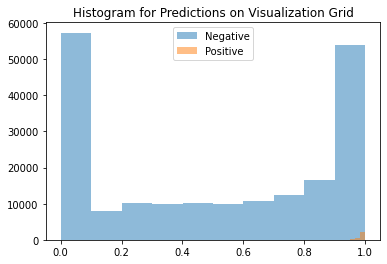

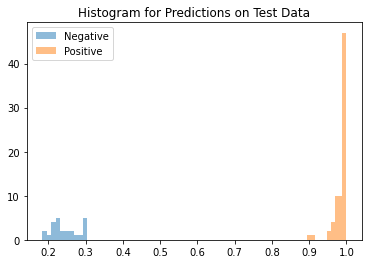

Average Difference between Positive and Negative Class: 0.7439920902252197


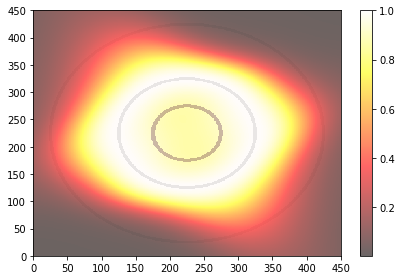

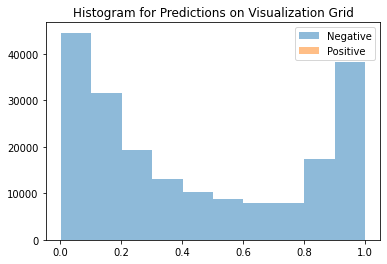

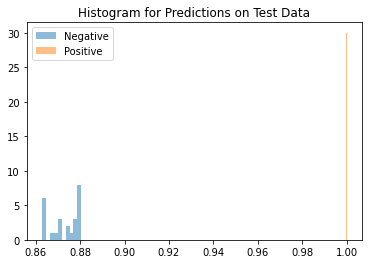

Average Difference between Positive and Negative Class: 0.12685680389404297


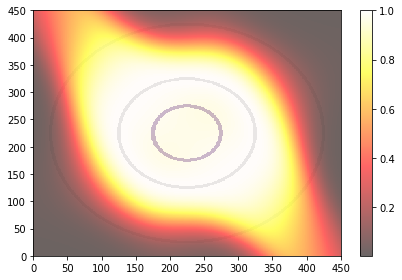

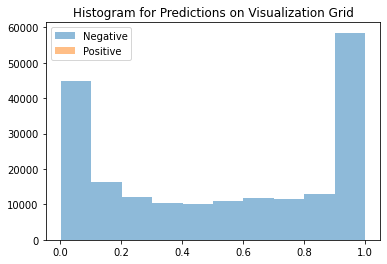

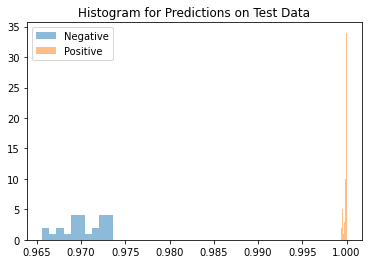

Average Difference between Positive and Negative Class: 0.029585540294647217


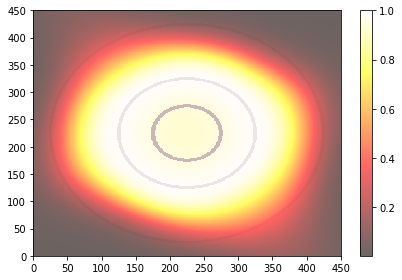

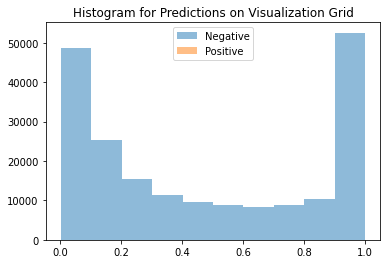

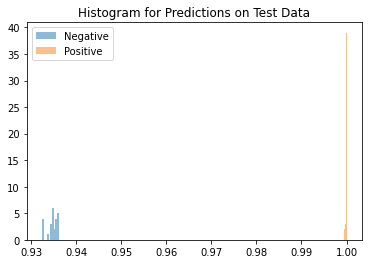

Average Difference between Positive and Negative Class: 0.06515300273895264


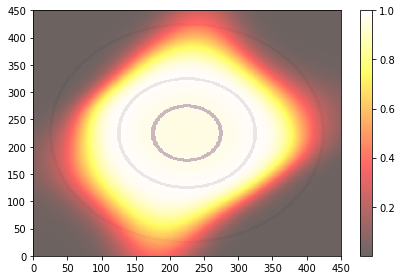

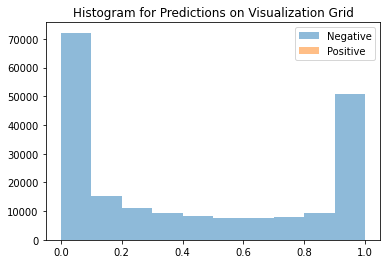

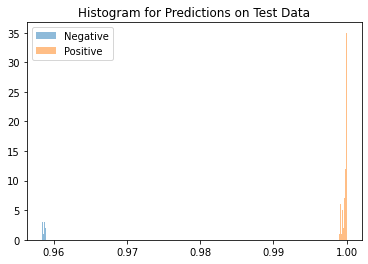

Average Difference between Positive and Negative Class: 0.041086435317993164


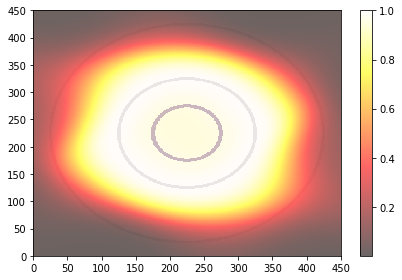

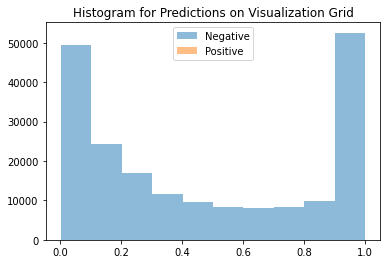

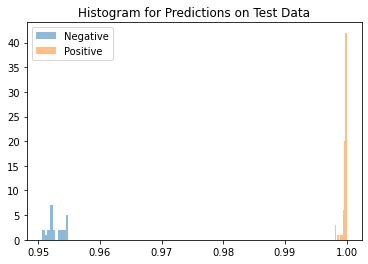

Average Difference between Positive and Negative Class: 0.04684114456176758


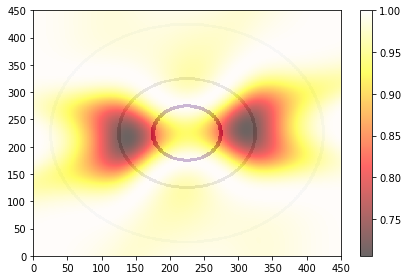

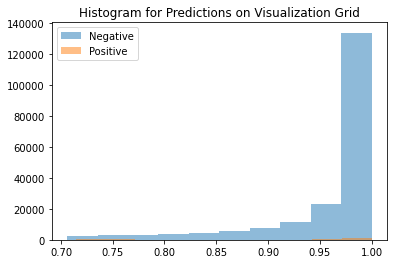

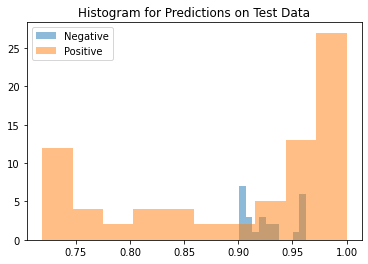

Average Difference between Positive and Negative Class: -0.02745276689529419


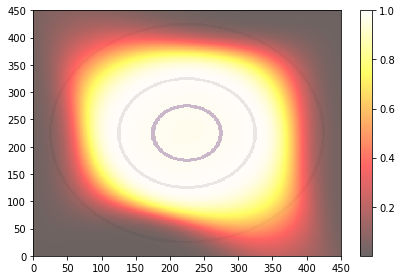

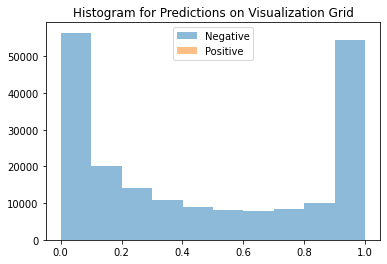

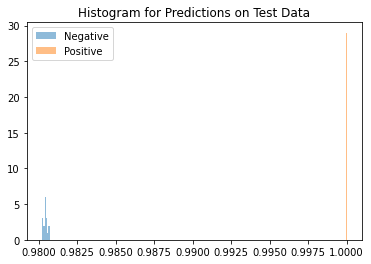

Average Difference between Positive and Negative Class: 0.019520103931427002


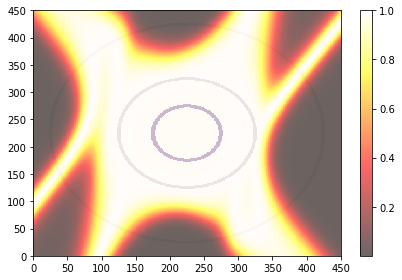

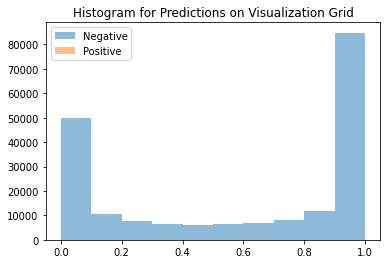

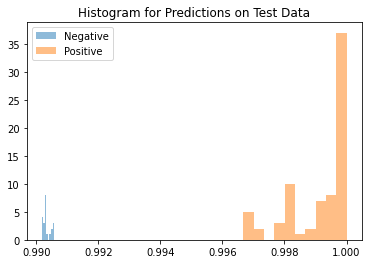

Average Difference between Positive and Negative Class: 0.008803069591522217


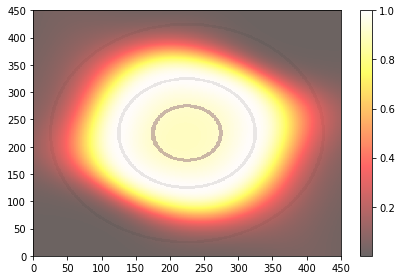

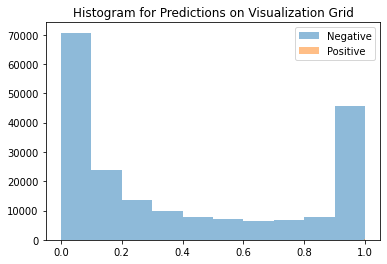

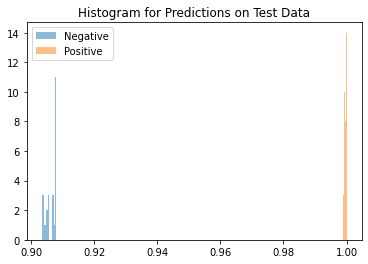

Average Difference between Positive and Negative Class: 0.09316664934158325


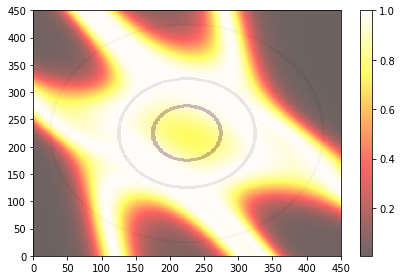

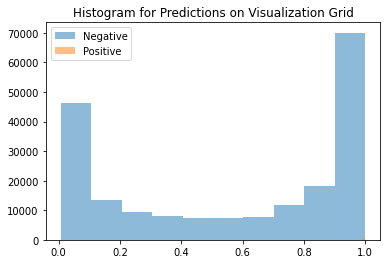

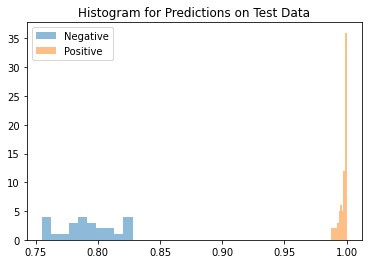

Average Difference between Positive and Negative Class: 0.2048025131225586


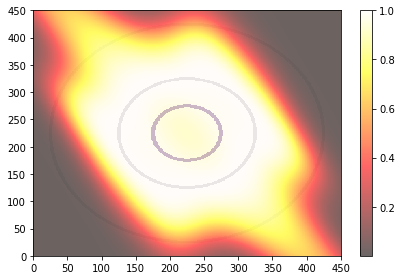

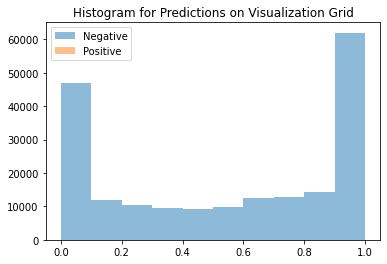

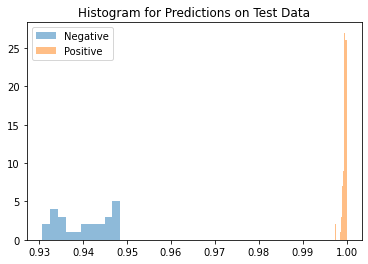

Average Difference between Positive and Negative Class: 0.05920553207397461


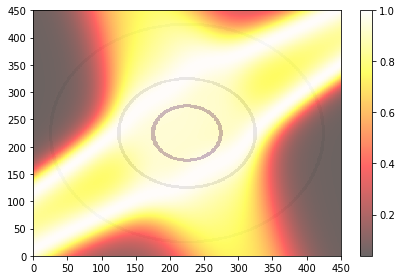

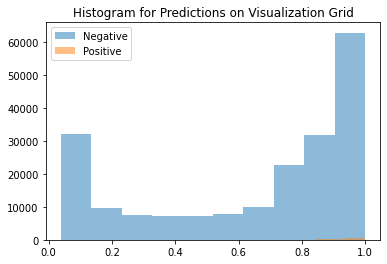

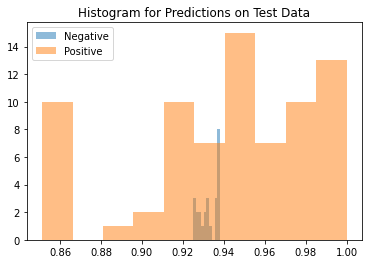

Average Difference between Positive and Negative Class: 0.00902622938156128


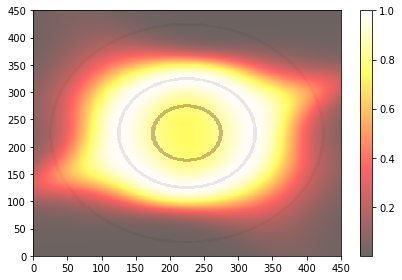

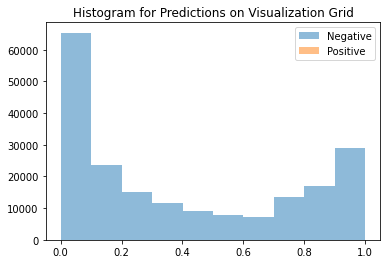

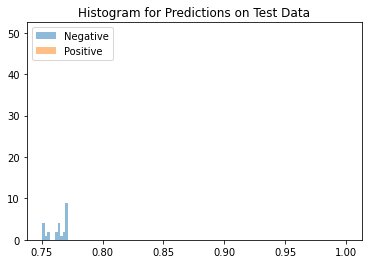

Average Difference between Positive and Negative Class: 0.2363978624343872


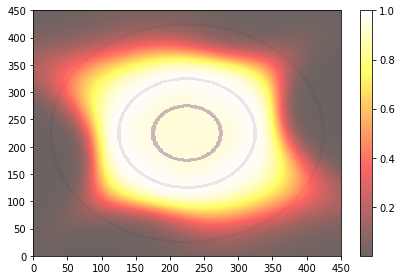

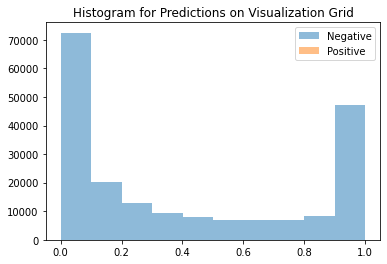

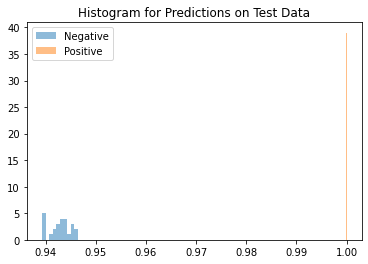

Average Difference between Positive and Negative Class: 0.05705386400222778


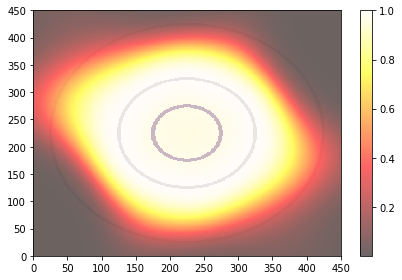

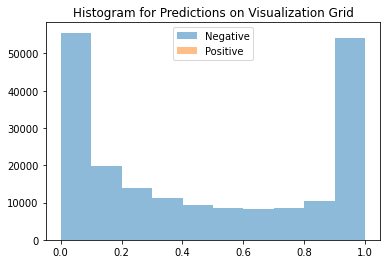

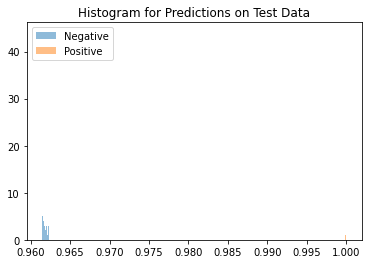

Average Difference between Positive and Negative Class: 0.038143694400787354


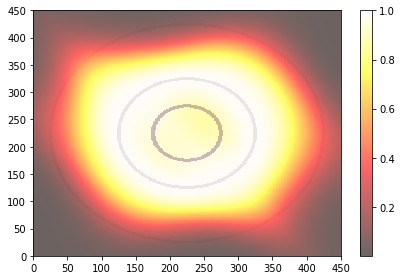

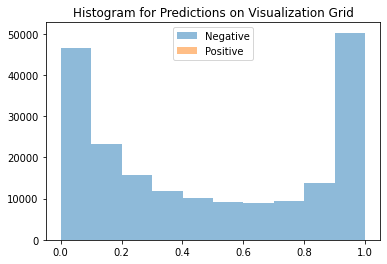

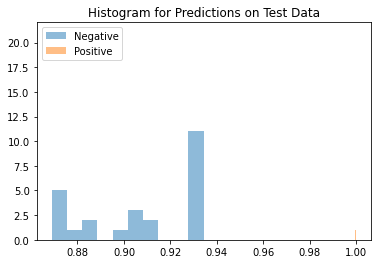

Average Difference between Positive and Negative Class: 0.09159320592880249


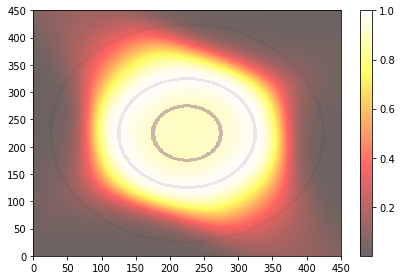

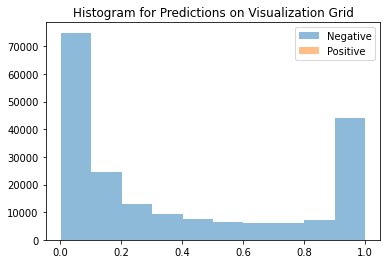

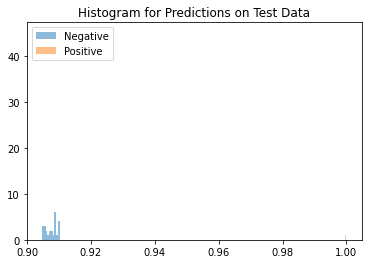

Average Difference between Positive and Negative Class: 0.09223759174346924


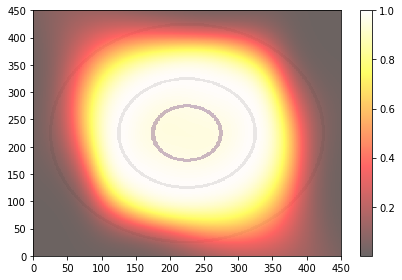

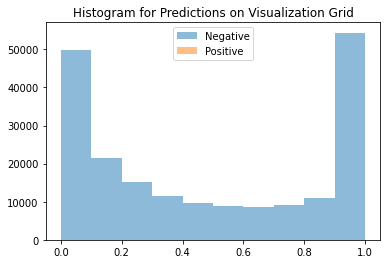

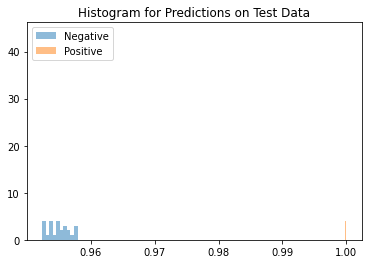

Average Difference between Positive and Negative Class: 0.044963538646698


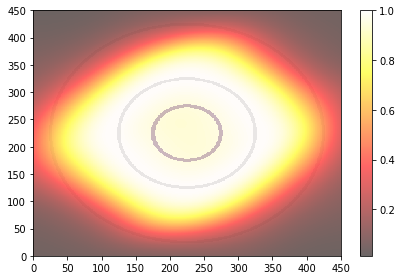

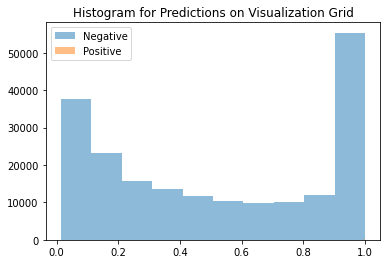

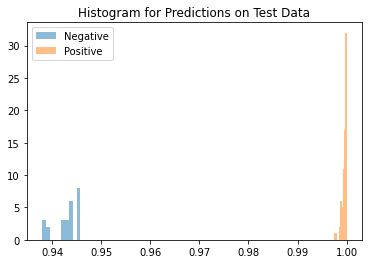

Average Difference between Positive and Negative Class: 0.056542038917541504
AUPR (Train): 0.9781356669752304+-0.09422536967704077
AUPR (Test): 0.9879816369438246+-0.036410219036701386
Average Distance between Means: 0.101875901222229+-0.1595584899187088


([0.9999999999999999,
  1.0,
  1.0,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  0.5674412948207035,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9952720446839046,
  0.9999999999999998,
  0.9999999999999998,
  0.9999999999999998,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  1.0],
 [0.9999999999999999,
  0.9999999999999999,
  1.0,
  1.0,
  1.0,
  0.9999999999999999,
  0.8637743635318152,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.8958583753446765,
  0.9999999999999998,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  1.0,
  0.9999999999999998,
  1.0],
 [0.7439921,
  0.1268568,
  0.02958554,
  0.065153,
  0.041086435,
  0.046841145,
  -0.027452767,
  0.019520104,
  0.00880307,
  0.09316665,
  0.20480251,
  0.059205532,
  0.009026229,
  0.23639786,
  0.057053864,
  0.038143694,
  0.091593206,
  0.09223759,
  0.04496354,
  0.05654204])

In [14]:
# ES2b with BCE fixed sigma=0.5
separation = "ES"
bumped = "b"
sigma = 0.5
hidden_layers = 2
train = False    # train sigma. if NA, then False

verbose = 0      # can change this to 0 to suppress verbosity during training
plot = False
shuffle = False
val_split = 0.1

auprs_train = []
auprs_test = []
diff_means = []
models = []

# Train and Evaluate the Model
for i in range(20):
    
    # Create the model
    tf.keras.utils.set_random_seed(i)
    model = create_model(separation, activation=bumped, hidden_layers=hidden_layers,
                 sigma=sigma, train=train, loss='binary_crossentropy',
                 seed=i)
    
    # Train the model
    aupr_train, aupr_test, diff_mean = train_eval(model, X, y, x_test, y_test, 
               train=train, verbose=verbose, shuffle=shuffle, plot=plot,
               val_split=val_split, callbacks=[early_stopping], seed=i, diff=True)
    
    auprs_train.append(aupr_train)
    auprs_test.append(aupr_test)
    diff_means.append(diff_mean)
    models.append(model)
    
print(f"AUPR (Train): {np.mean(auprs_train)}+-{np.std(auprs_train)}")
print(f"AUPR (Test): {np.mean(auprs_test)}+-{np.std(auprs_test)}")
print(f"Average Distance between Means: {np.mean(diff_means)}+-{np.std(diff_means)}")
auprs_train, auprs_test, diff_means

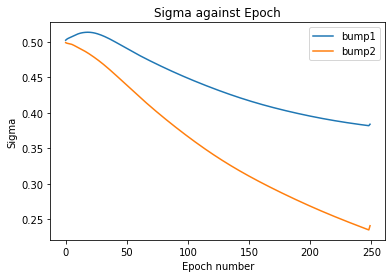

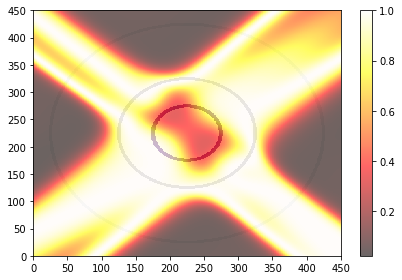

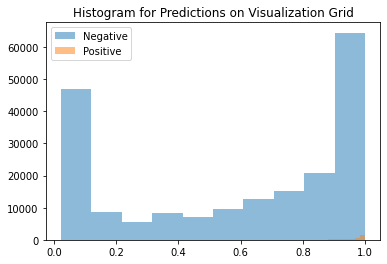

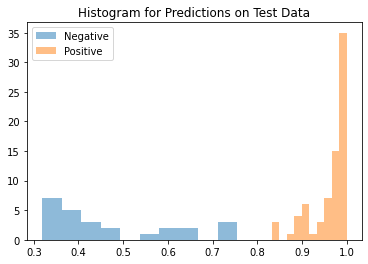

Average Difference between Positive and Negative Class: 0.4916538596153259


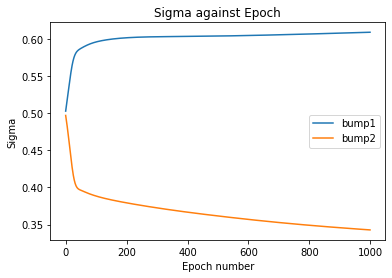

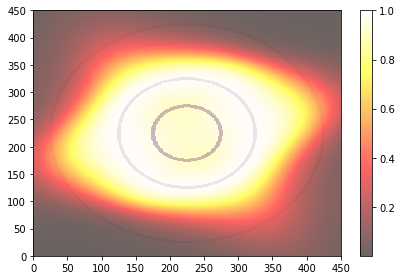

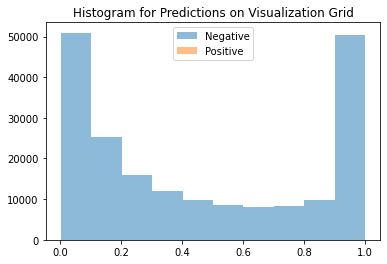

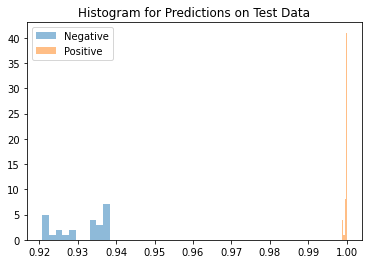

Average Difference between Positive and Negative Class: 0.06893366575241089


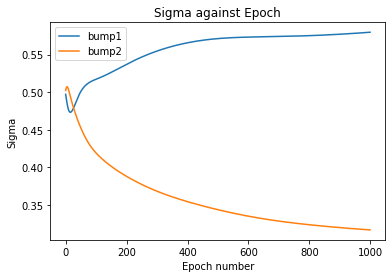

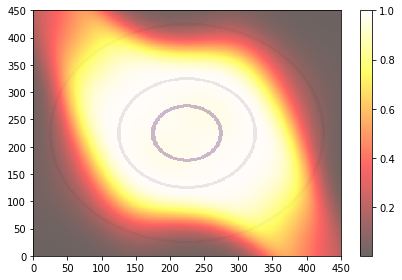

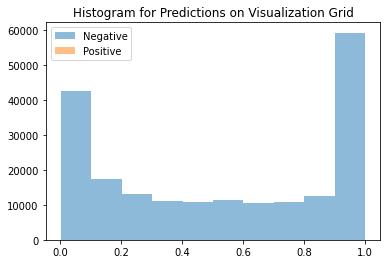

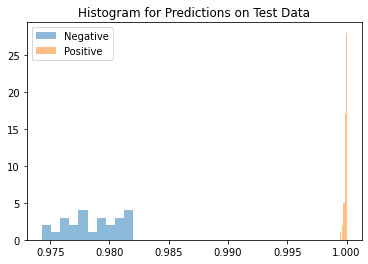

Average Difference between Positive and Negative Class: 0.021244943141937256


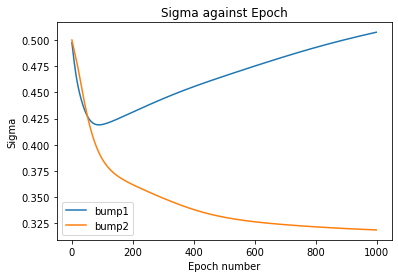

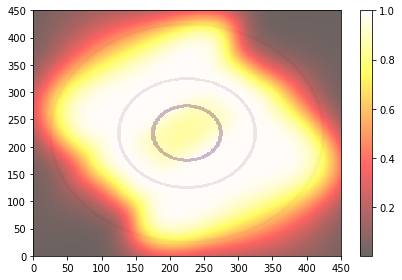

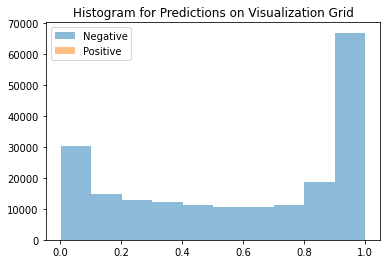

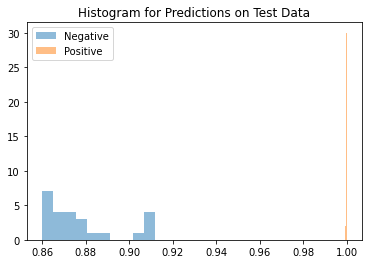

Average Difference between Positive and Negative Class: 0.12146329879760742


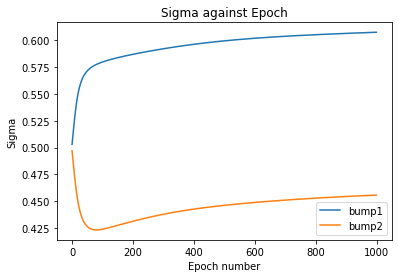

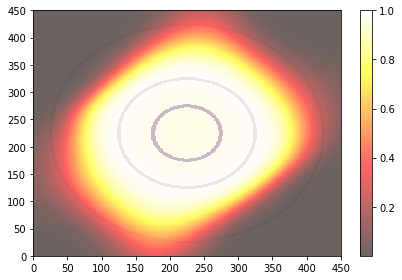

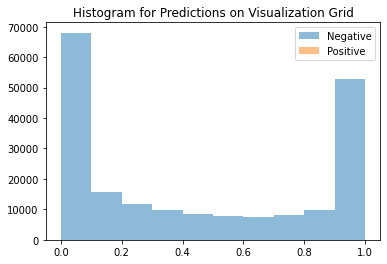

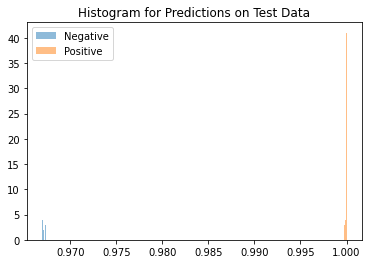

Average Difference between Positive and Negative Class: 0.03268098831176758


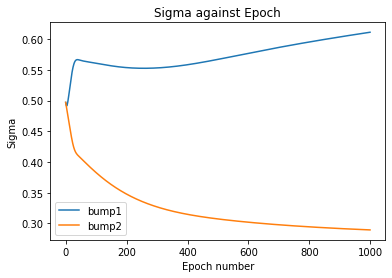

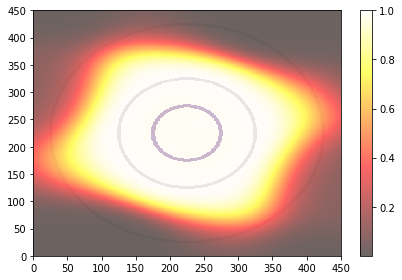

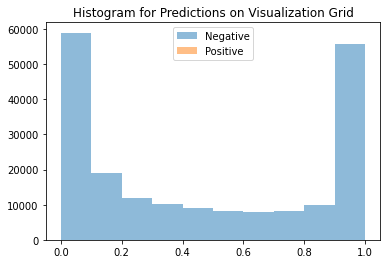

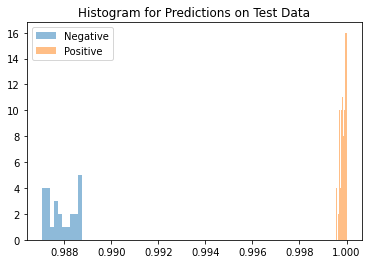

Average Difference between Positive and Negative Class: 0.011947214603424072


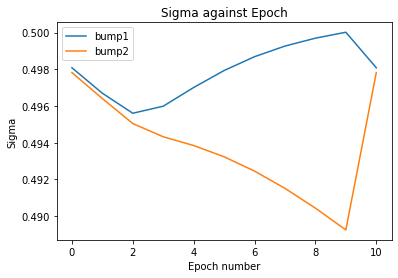

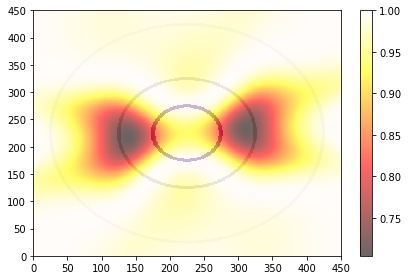

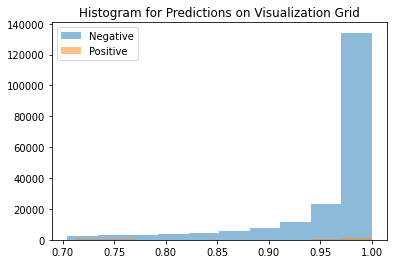

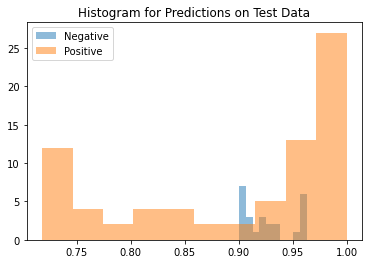

Average Difference between Positive and Negative Class: -0.028233885765075684


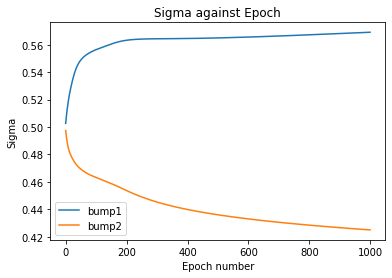

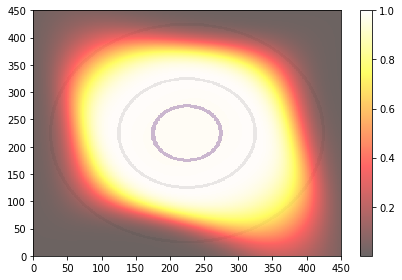

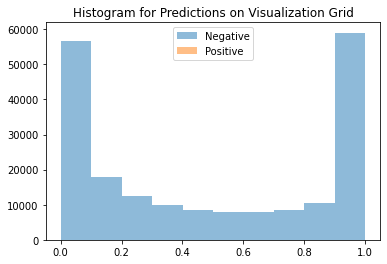

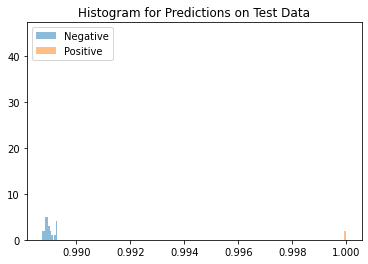

Average Difference between Positive and Negative Class: 0.011000633239746094


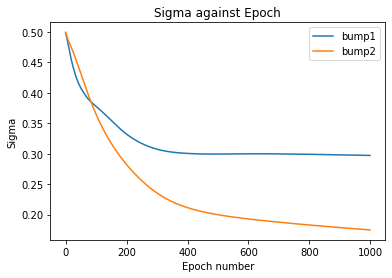

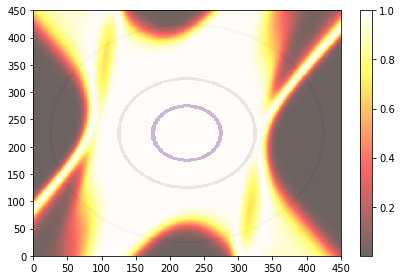

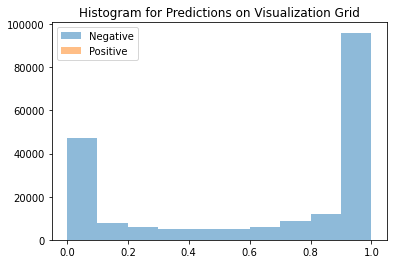

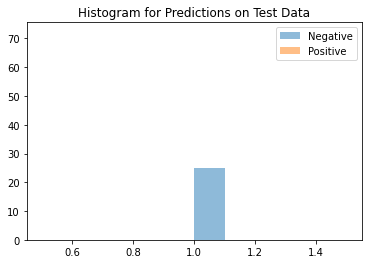

Average Difference between Positive and Negative Class: -0.000133514404296875


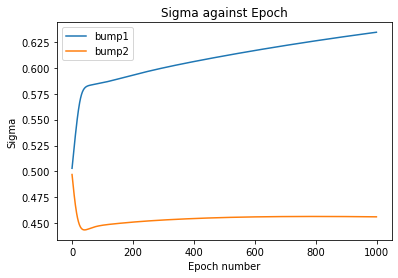

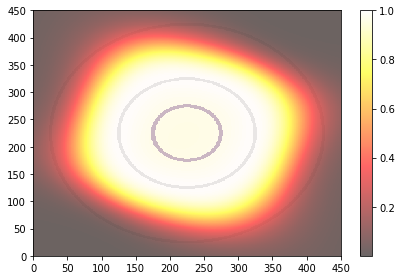

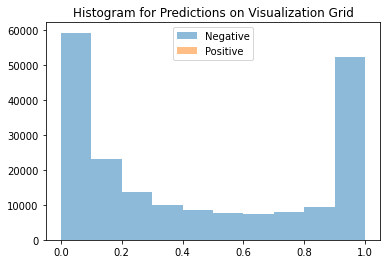

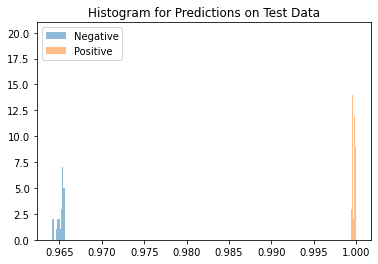

Average Difference between Positive and Negative Class: 0.03465789556503296


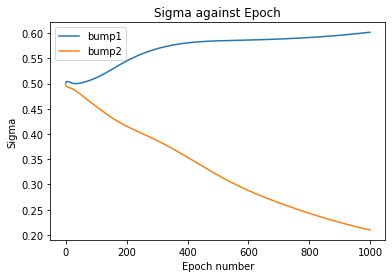

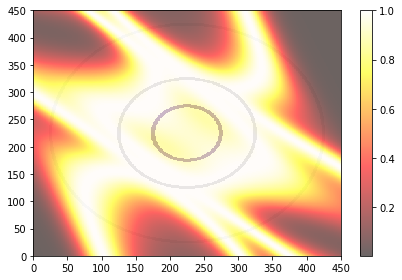

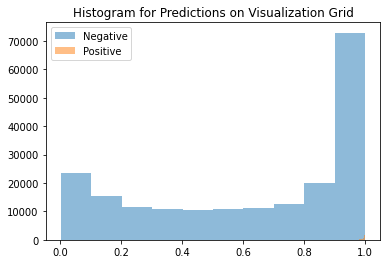

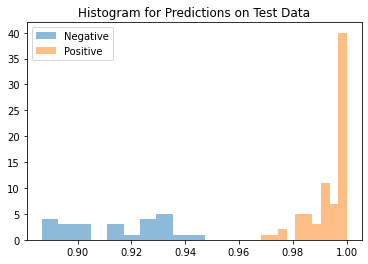

Average Difference between Positive and Negative Class: 0.07927370071411133


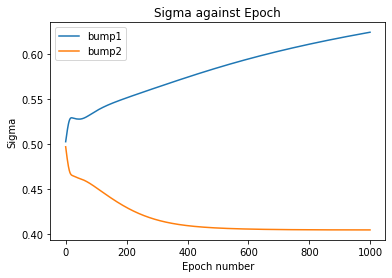

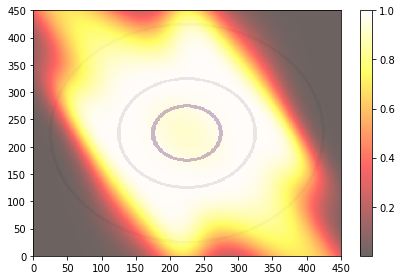

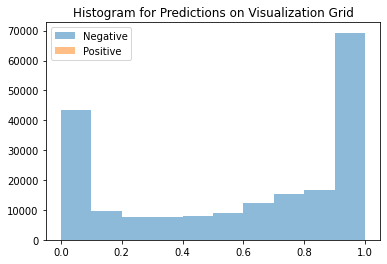

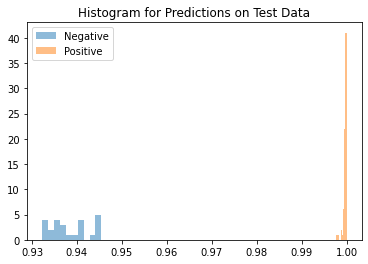

Average Difference between Positive and Negative Class: 0.061234116554260254


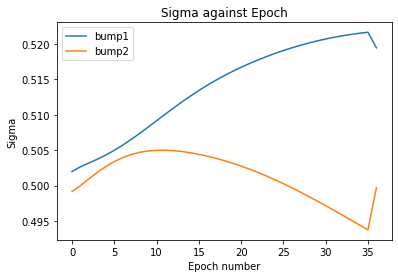

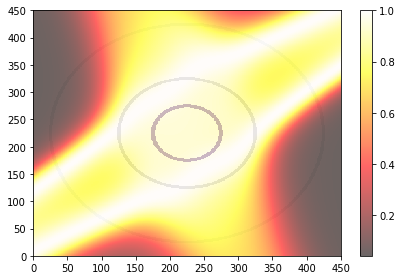

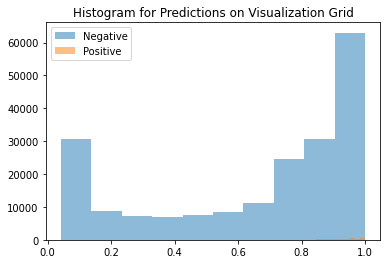

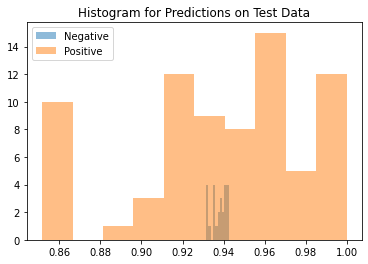

Average Difference between Positive and Negative Class: 0.0014970898628234863


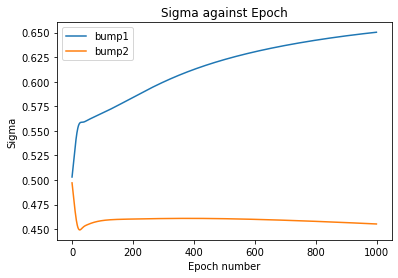

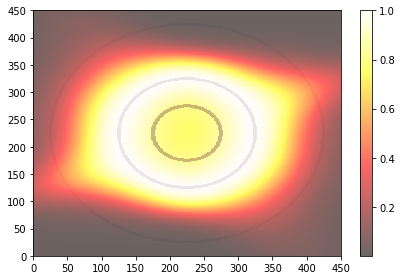

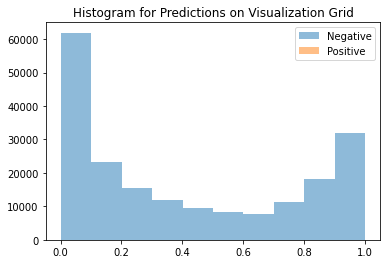

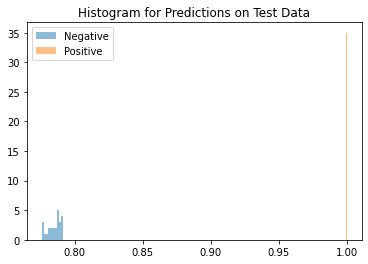

Average Difference between Positive and Negative Class: 0.2147362232208252


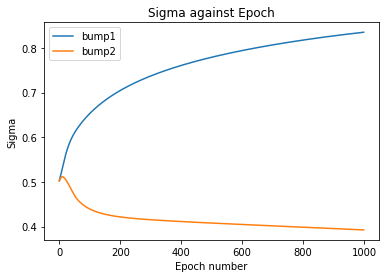

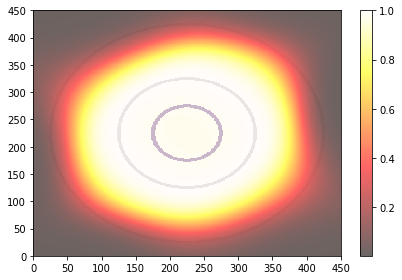

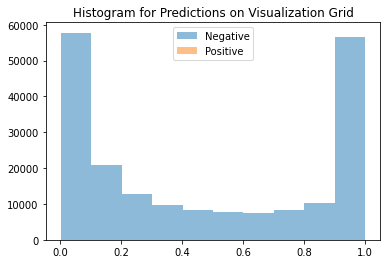

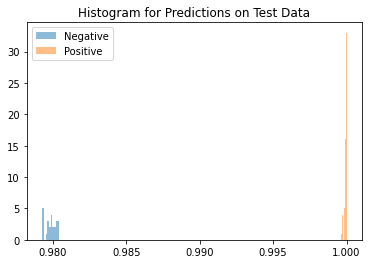

Average Difference between Positive and Negative Class: 0.020062267780303955


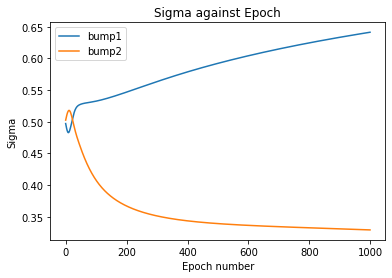

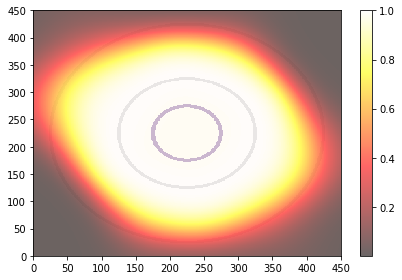

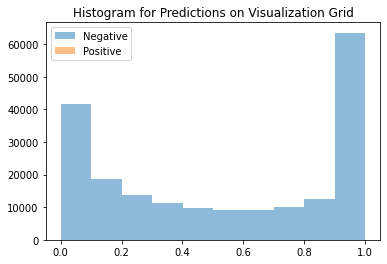

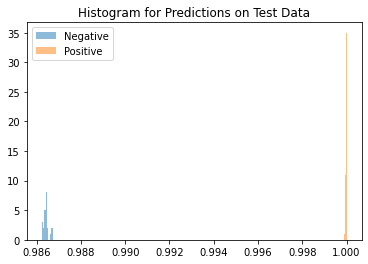

Average Difference between Positive and Negative Class: 0.013527274131774902


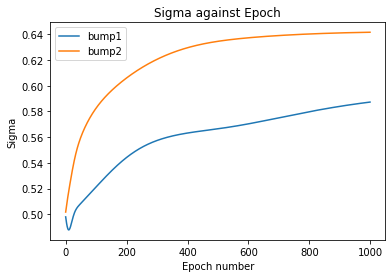

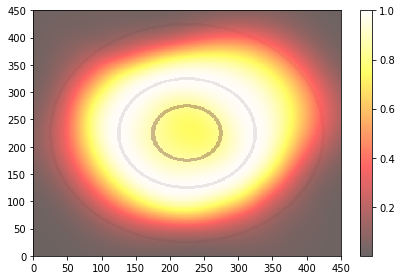

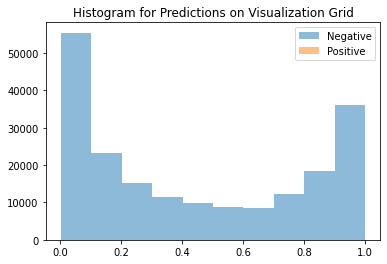

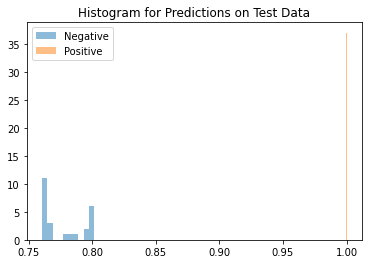

Average Difference between Positive and Negative Class: 0.22305482625961304


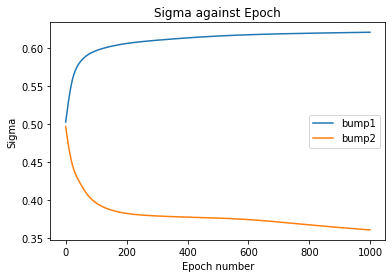

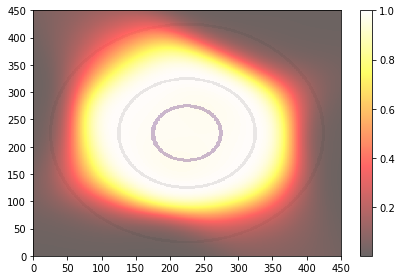

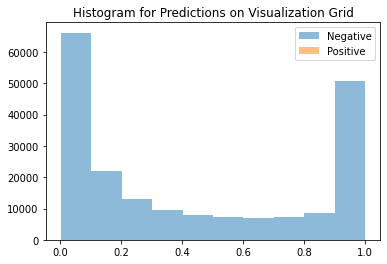

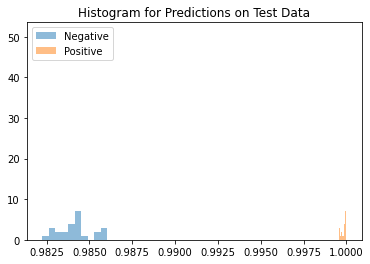

Average Difference between Positive and Negative Class: 0.01577240228652954


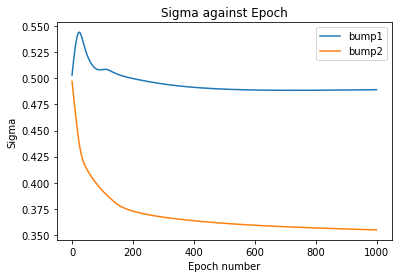

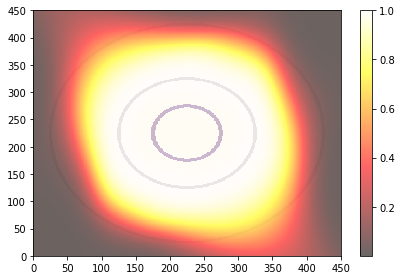

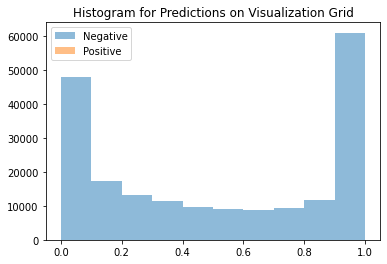

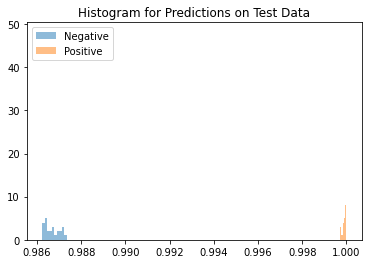

Average Difference between Positive and Negative Class: 0.01326686143875122


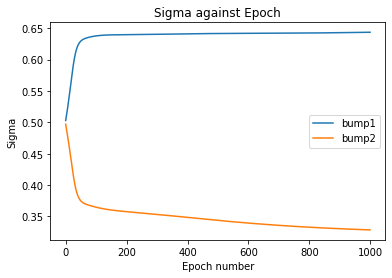

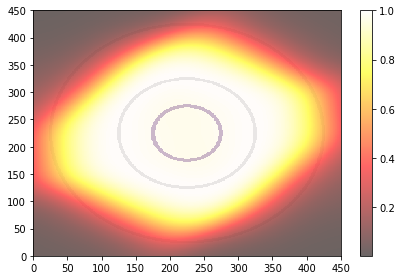

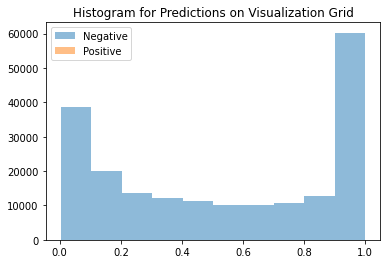

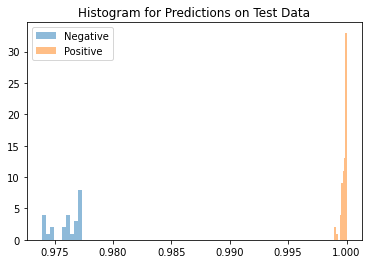

Average Difference between Positive and Negative Class: 0.02372574806213379
AUPR (Train): 0.9780996237806013+-0.0942387177780304
AUPR (Test): 0.9795334744868345+-0.048736367434229565
Average Distance between Means: 0.07156827300786972+-0.11619901657104492


([0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  1.0,
  0.9999999999999999,
  0.5673540691808462,
  1.0,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9946384064311825,
  0.9999999999999998,
  1.0,
  1.0,
  0.9999999999999999,
  1.0,
  1.0,
  0.9999999999999999],
 [0.9999999999999999,
  1.0,
  1.0,
  1.0,
  0.9999999999999999,
  1.0,
  0.8620123322697839,
  0.9999999999999999,
  0.8680821105843285,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  0.8605750468825757,
  1.0,
  1.0,
  1.0,
  1.0,
  0.9999999999999999,
  1.0,
  1.0],
 [0.49165386,
  0.068933666,
  0.021244943,
  0.1214633,
  0.03268099,
  0.011947215,
  -0.028233886,
  0.011000633,
  -0.0001335144,
  0.034657896,
  0.0792737,
  0.061234117,
  0.0014970899,
  0.21473622,
  0.020062268,
  0.013527274,
  0.22305483,
  0.015772402,
  0.013266861,
  0.023725748])

In [15]:
# ES2b with BCE trainable sigma=0.5
separation = "ES"
bumped = "b"
sigma = 0.5
hidden_layers = 2
train = True     # train sigma. if NA, then False

verbose = 0      # can change this to 0 to suppress verbosity during training
plot = False
shuffle = False
val_split = 0.1

auprs_train = []
auprs_test = []
diff_means = []

# Train and Evaluate the Model
for i in range(20):
    
    # Create the model
    tf.keras.utils.set_random_seed(i)
    model = create_model(separation, activation=bumped, hidden_layers=hidden_layers,
                 sigma=sigma, train=train, loss='binary_crossentropy',
                 seed=i)
    
    # Train the model
    aupr_train, aupr_test, diff_mean = train_eval(model, X, y, x_test, y_test, 
               train=train, verbose=verbose, shuffle=shuffle, plot=plot,
               val_split=val_split, callbacks=[early_stopping], seed=i, diff=True)
    
    auprs_train.append(aupr_train)
    auprs_test.append(aupr_test)
    diff_means.append(diff_mean)
    
print(f"AUPR (Train): {np.mean(auprs_train)}+-{np.std(auprs_train)}")
print(f"AUPR (Test): {np.mean(auprs_test)}+-{np.std(auprs_test)}")
print(f"Average Distance between Means: {np.mean(diff_means)}+-{np.std(diff_means)}")
auprs_train, auprs_test, diff_means

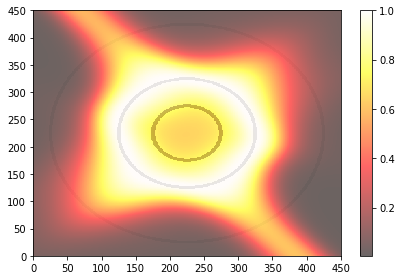

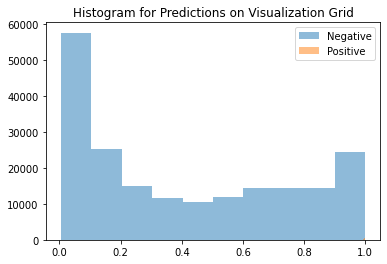

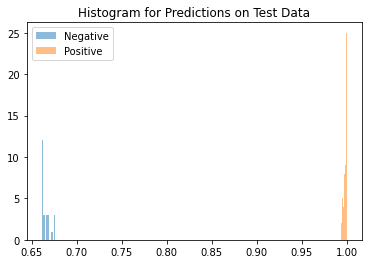

Average Difference between Positive and Negative Class: 0.3324407935142517


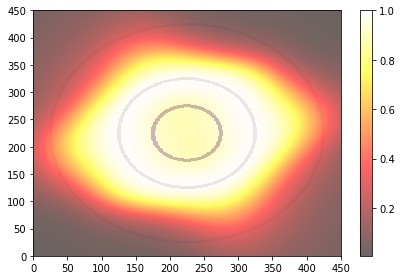

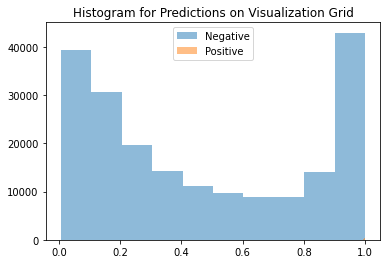

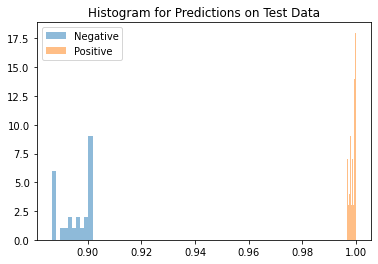

Average Difference between Positive and Negative Class: 0.10303747653961182


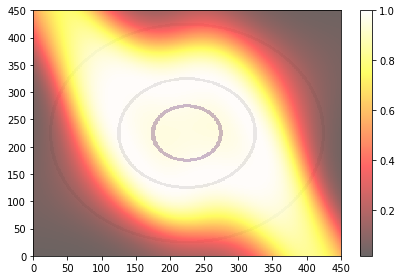

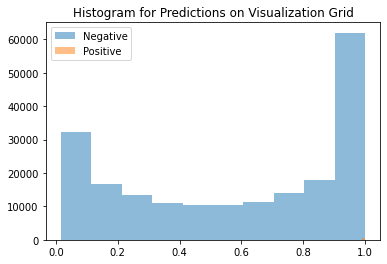

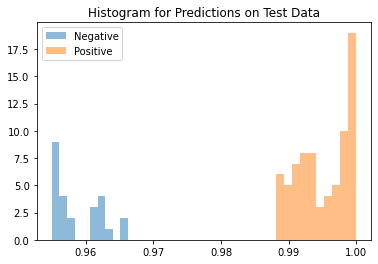

Average Difference between Positive and Negative Class: 0.036334991455078125


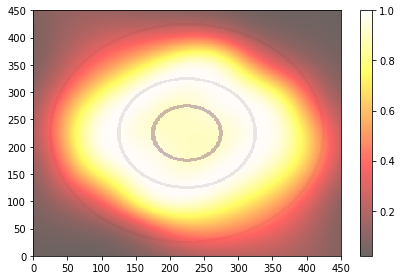

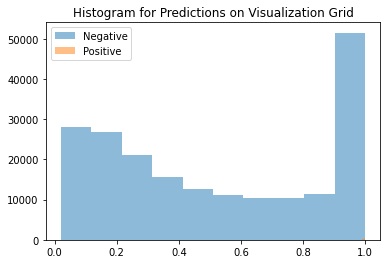

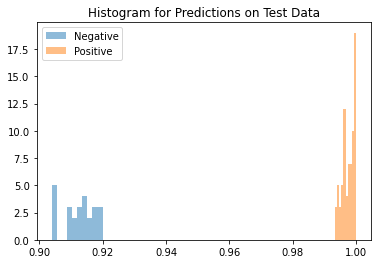

Average Difference between Positive and Negative Class: 0.08500874042510986


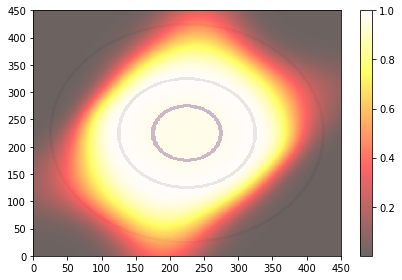

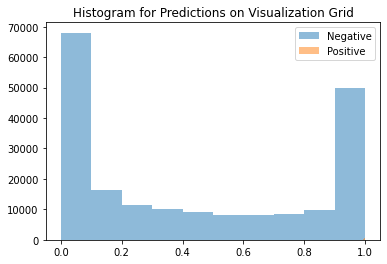

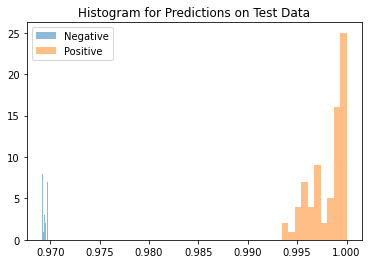

Average Difference between Positive and Negative Class: 0.028661370277404785


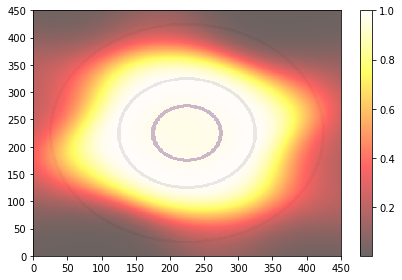

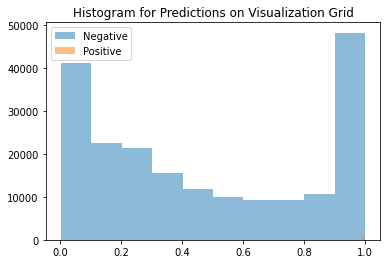

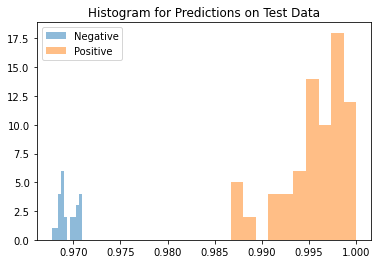

Average Difference between Positive and Negative Class: 0.026169955730438232


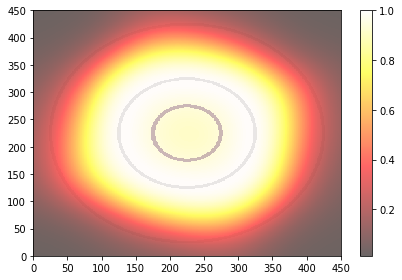

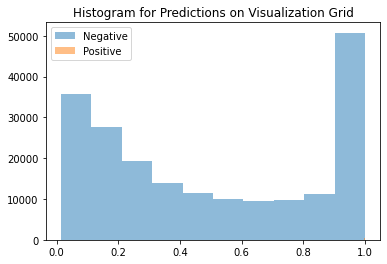

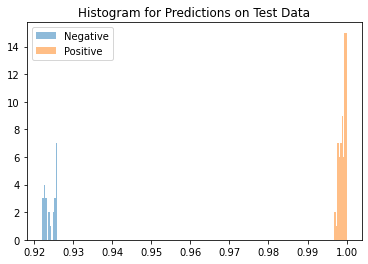

Average Difference between Positive and Negative Class: 0.07475060224533081


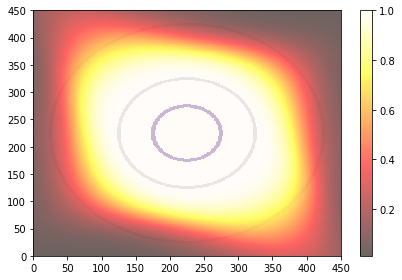

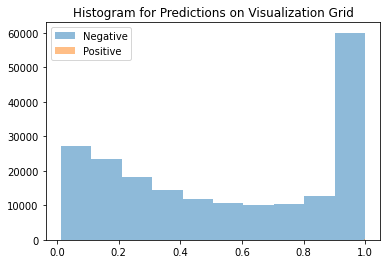

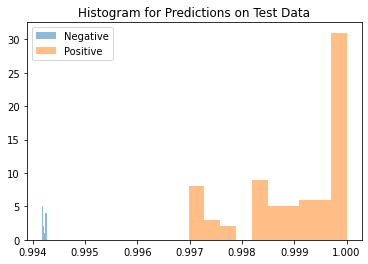

Average Difference between Positive and Negative Class: 0.0048160552978515625


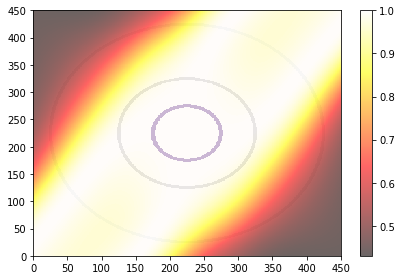

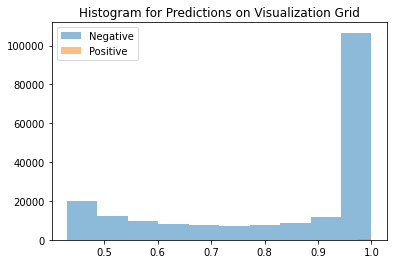

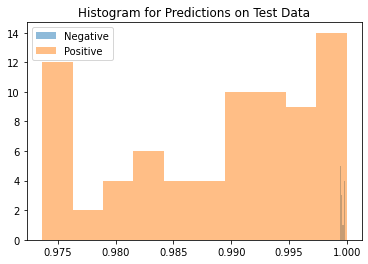

Average Difference between Positive and Negative Class: -0.010864496231079102


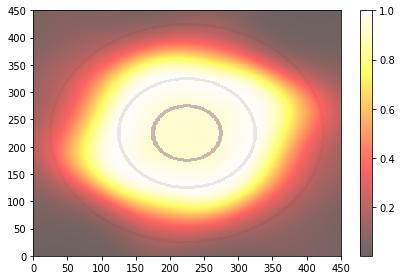

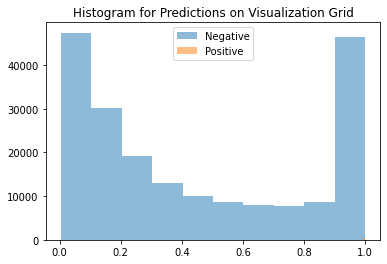

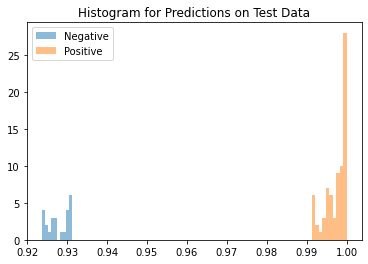

Average Difference between Positive and Negative Class: 0.06951886415481567


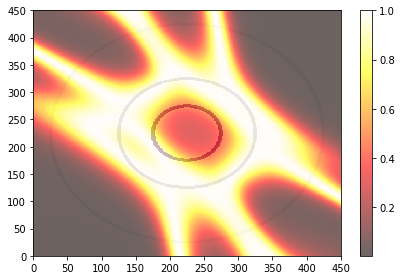

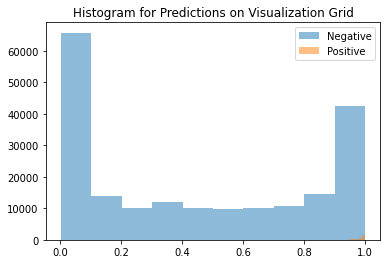

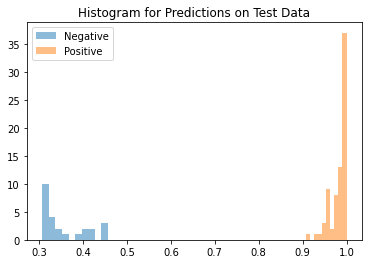

Average Difference between Positive and Negative Class: 0.6272721886634827


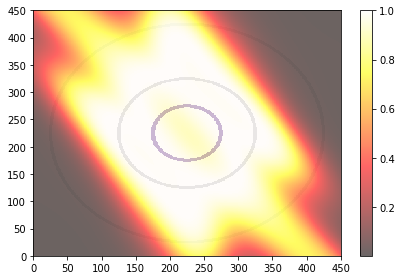

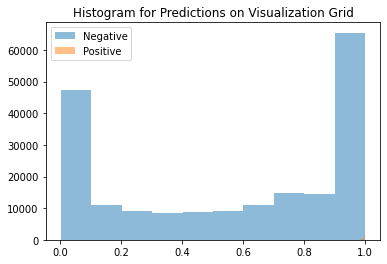

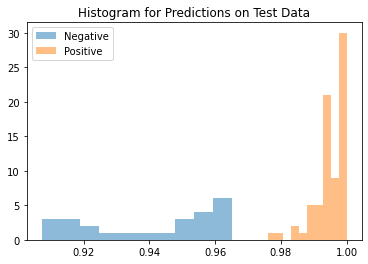

Average Difference between Positive and Negative Class: 0.05439102649688721


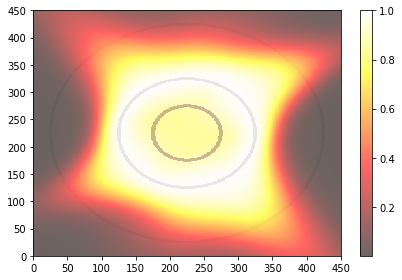

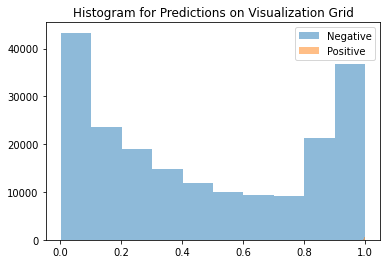

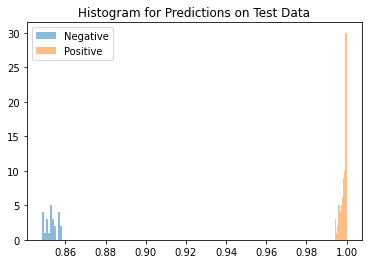

Average Difference between Positive and Negative Class: 0.1452654004096985


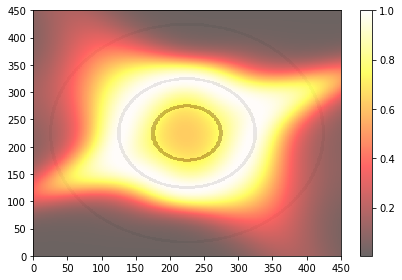

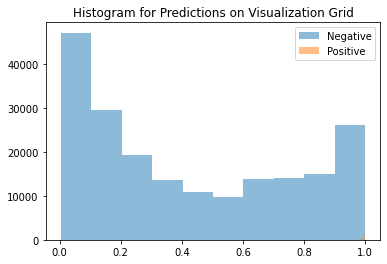

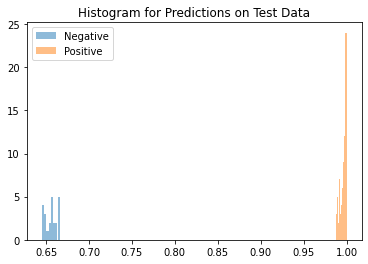

Average Difference between Positive and Negative Class: 0.34024202823638916


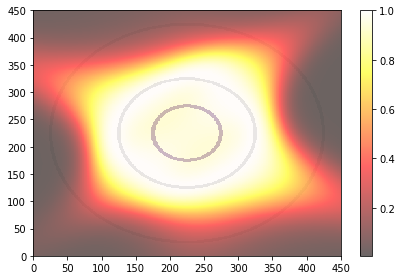

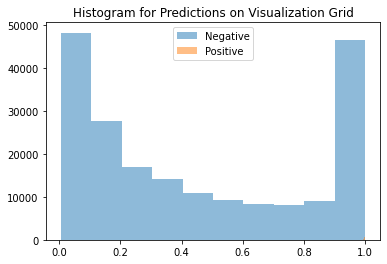

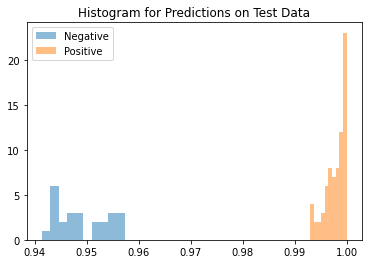

Average Difference between Positive and Negative Class: 0.04867434501647949


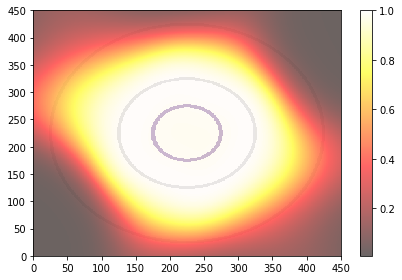

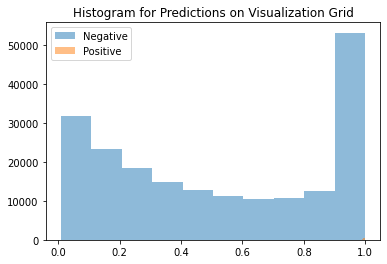

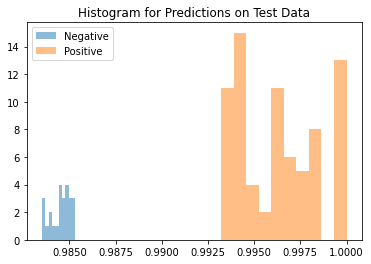

Average Difference between Positive and Negative Class: 0.01180112361907959


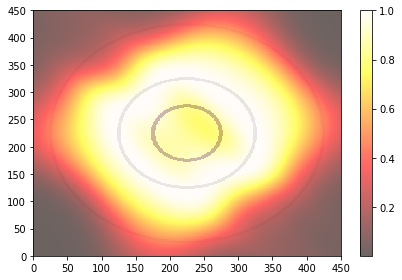

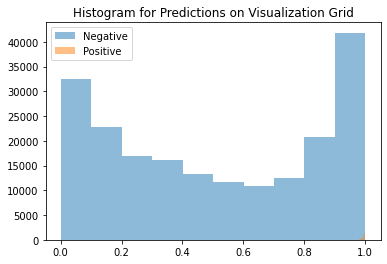

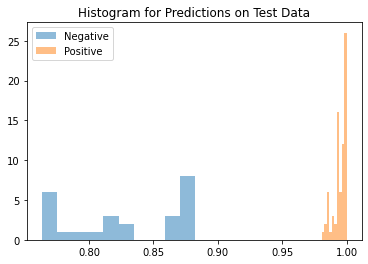

Average Difference between Positive and Negative Class: 0.1657160520553589


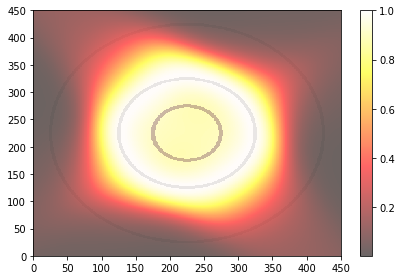

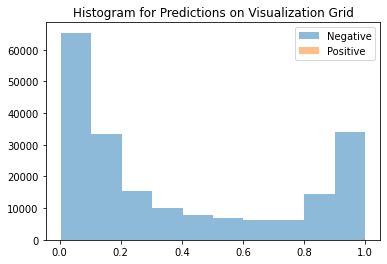

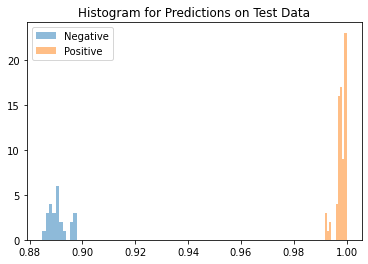

Average Difference between Positive and Negative Class: 0.10711008310317993


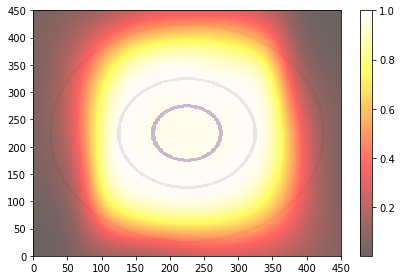

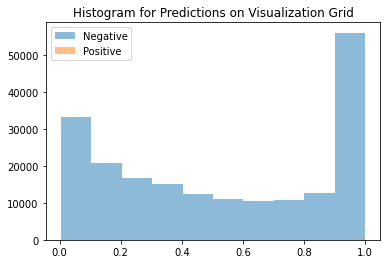

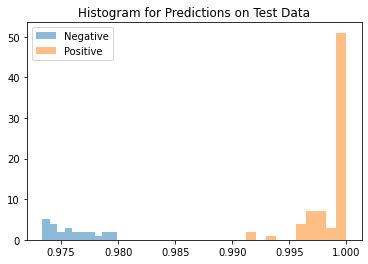

Average Difference between Positive and Negative Class: 0.022749781608581543


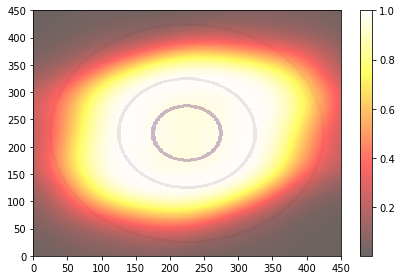

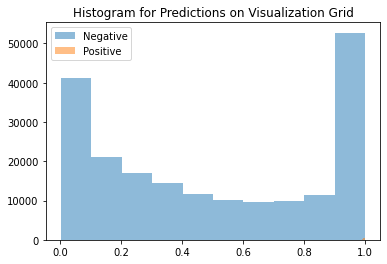

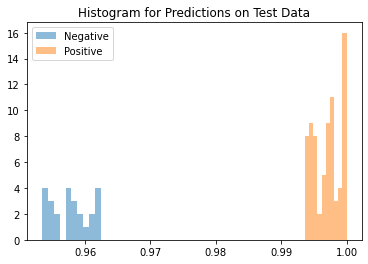

Average Difference between Positive and Negative Class: 0.039193153381347656
AUPR (Train): 0.9985017146081226+-0.006530874611776349
AUPR (Test): 0.9794587713324573+-0.08953713993797931
Average Distance between Means: 0.11561448872089386+-0.15020090341567993


([0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9700342921624541,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999],
 [1.0,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.5891754266491457,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999],
 [0.3324408,
  0.10303748,
  0.03633499,
  0.08500874,
  0.02866137,
  0.026169956,
  0.0747506,
  0.0048160553,
  -0.010864496,
  0.069518864,
  0.

In [16]:
# ES2b with MSE fixed sigma=0.5
separation = "ES"
bumped = "b"
sigma = 0.5
hidden_layers = 2
train = False    # train sigma. if NA, then False

verbose = 0      # can change this to 0 to suppress verbosity during training
plot = False
shuffle = False
val_split = 0.1

auprs_train = []
auprs_test = []
diff_means = []

# Train and Evaluate the Model
for i in range(20):
    
    # Create the model
    tf.keras.utils.set_random_seed(i)
    model = create_model(separation, activation=bumped, hidden_layers=hidden_layers,
                 sigma=sigma, train=train, loss='mse',
                 seed=i)
    
    # Train the model
    aupr_train, aupr_test, diff_mean = train_eval(model, X, y, x_test, y_test, 
               train=train, verbose=verbose, shuffle=shuffle, plot=plot,
               val_split=val_split, callbacks=[early_stopping], seed=i, diff=True)
    
    auprs_train.append(aupr_train)
    auprs_test.append(aupr_test)
    diff_means.append(diff_mean)
    
print(f"AUPR (Train): {np.mean(auprs_train)}+-{np.std(auprs_train)}")
print(f"AUPR (Test): {np.mean(auprs_test)}+-{np.std(auprs_test)}")
print(f"Average Distance between Means: {np.mean(diff_means)}+-{np.std(diff_means)}")
auprs_train, auprs_test, diff_means

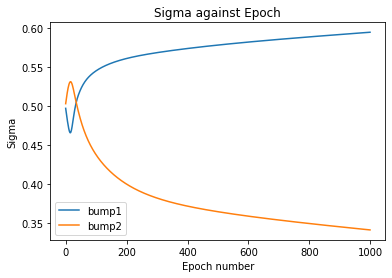

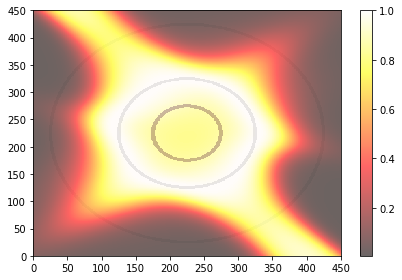

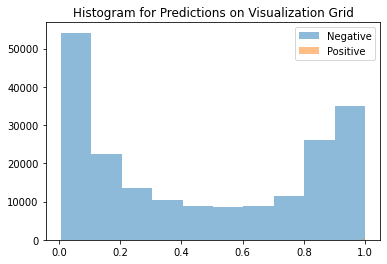

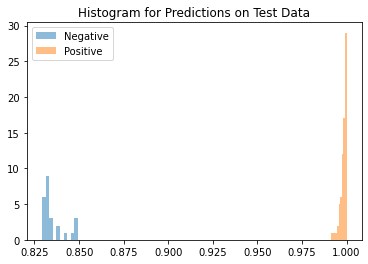

Average Difference between Positive and Negative Class: 0.16310018301010132


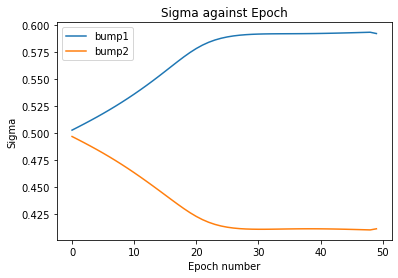

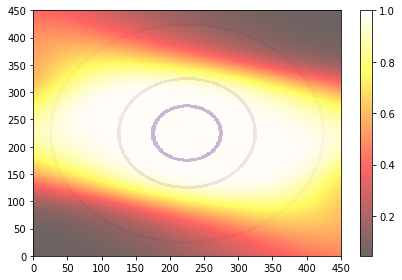

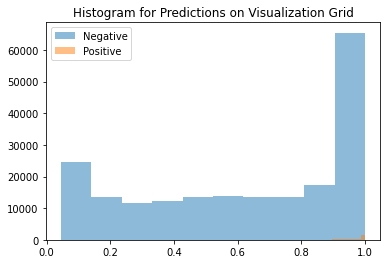

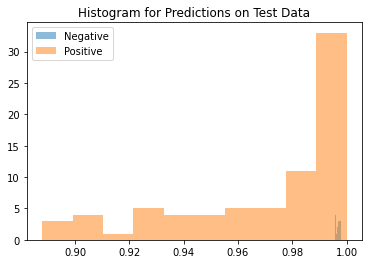

Average Difference between Positive and Negative Class: -0.02636200189590454


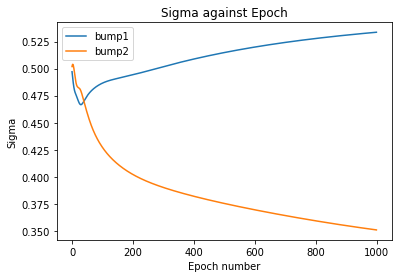

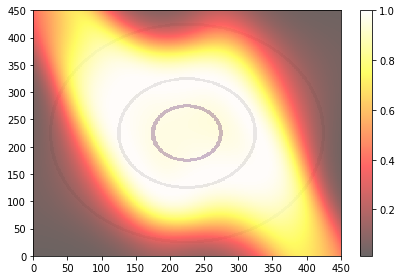

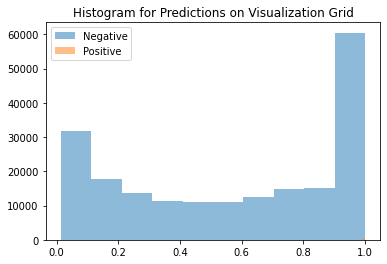

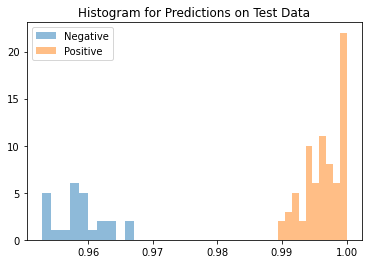

Average Difference between Positive and Negative Class: 0.037641704082489014


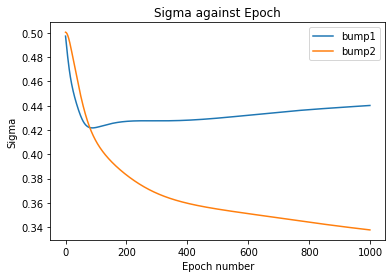

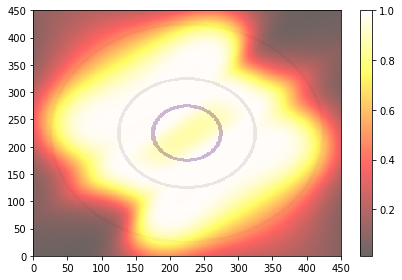

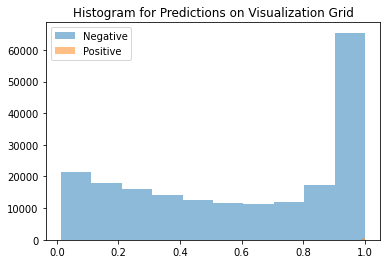

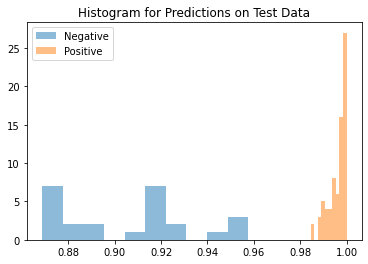

Average Difference between Positive and Negative Class: 0.09058654308319092


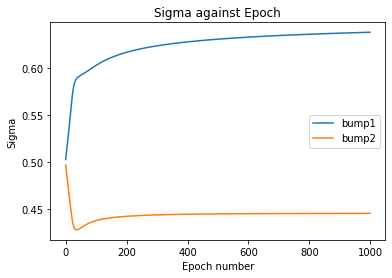

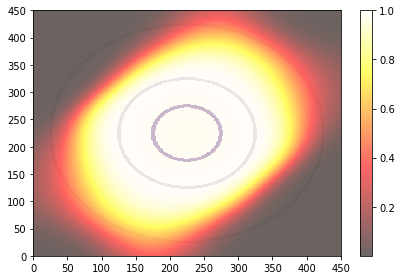

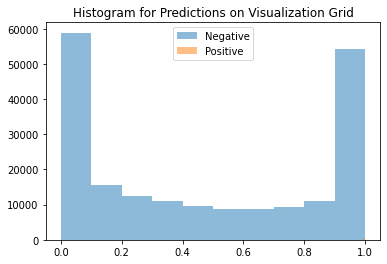

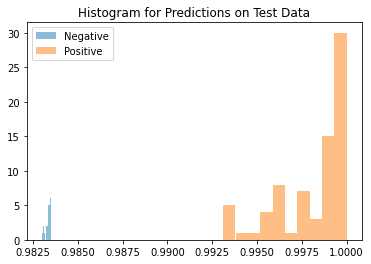

Average Difference between Positive and Negative Class: 0.014817416667938232


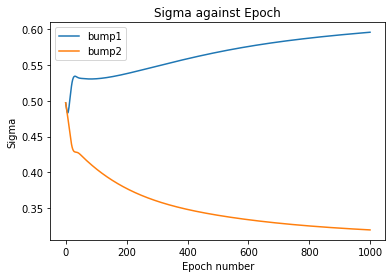

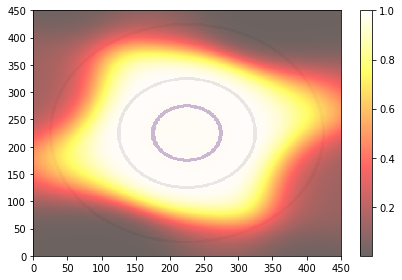

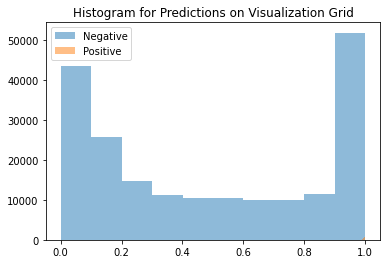

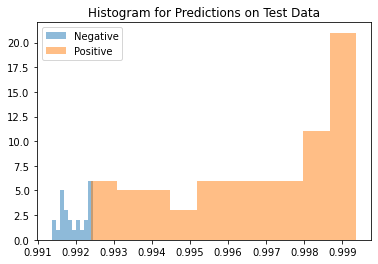

Average Difference between Positive and Negative Class: 0.004863739013671875


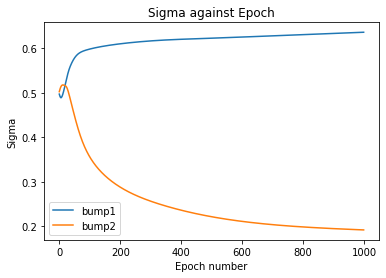

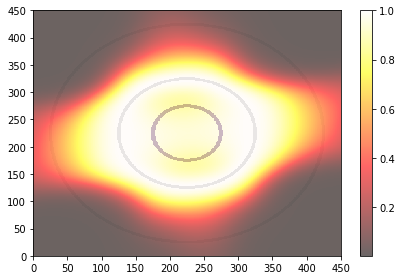

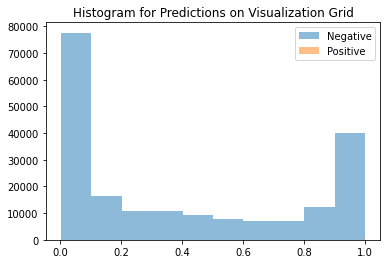

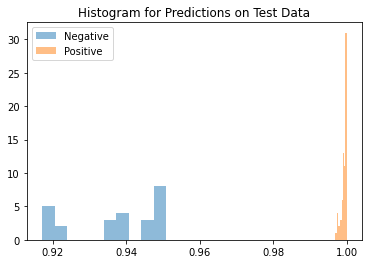

Average Difference between Positive and Negative Class: 0.06215721368789673


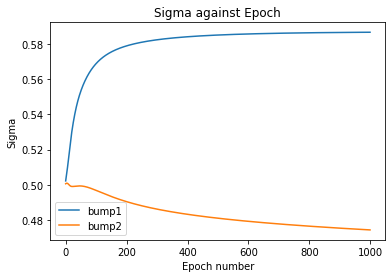

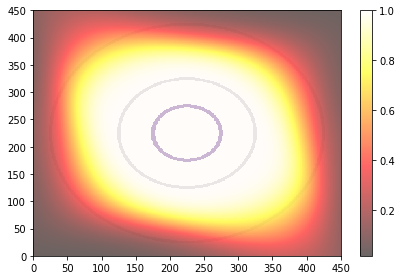

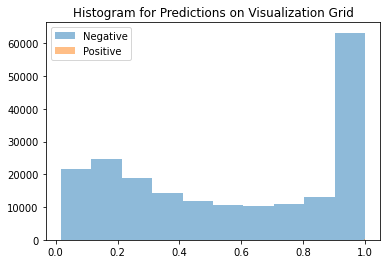

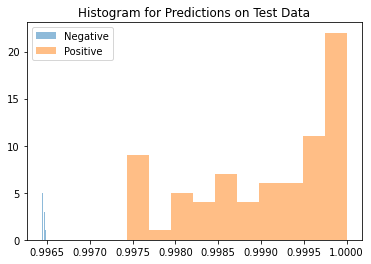

Average Difference between Positive and Negative Class: 0.0026061534881591797


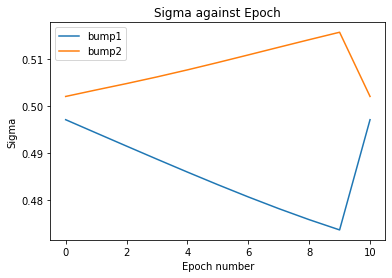

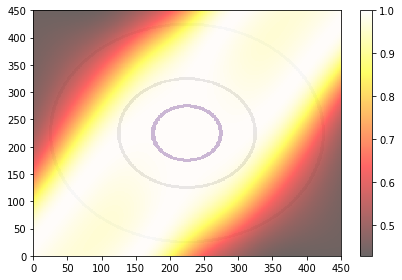

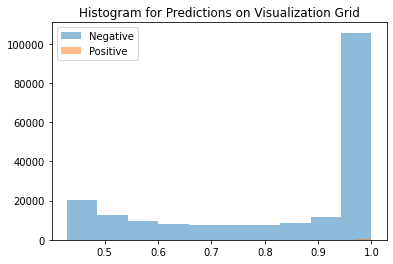

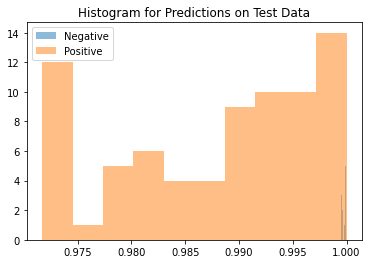

Average Difference between Positive and Negative Class: -0.011543095111846924


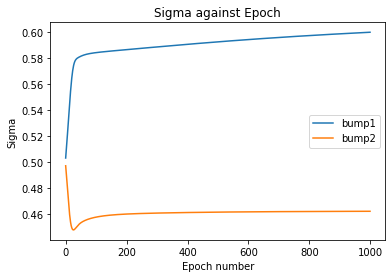

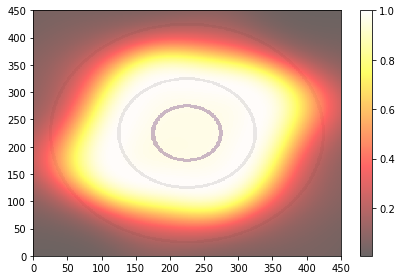

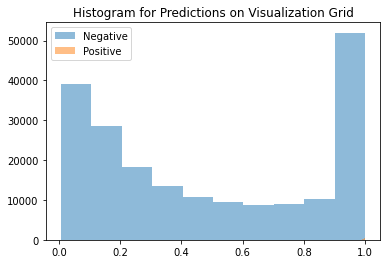

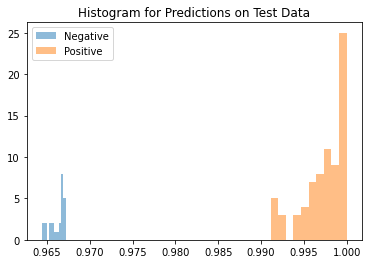

Average Difference between Positive and Negative Class: 0.0311204195022583


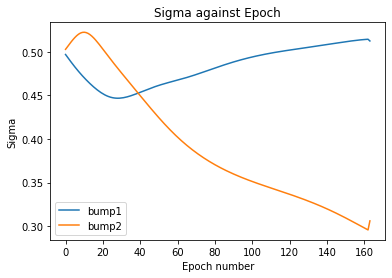

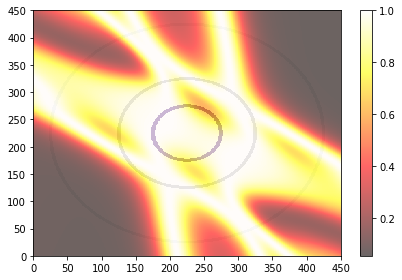

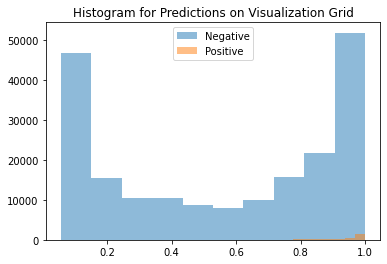

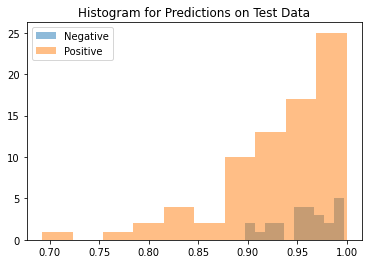

Average Difference between Positive and Negative Class: -0.022509336471557617


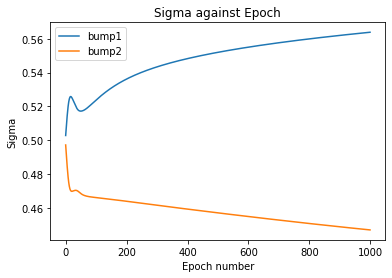

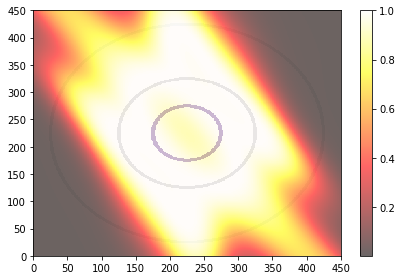

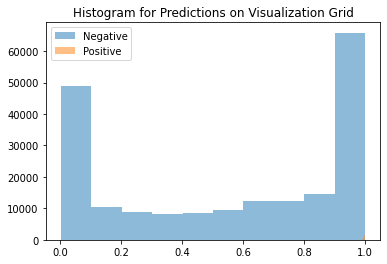

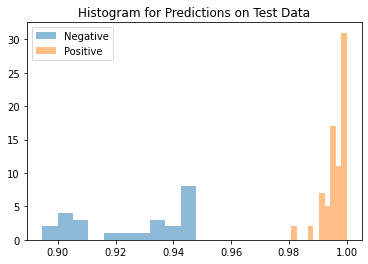

Average Difference between Positive and Negative Class: 0.0702562928199768


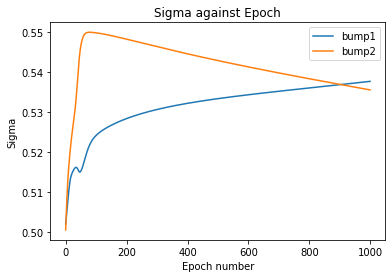

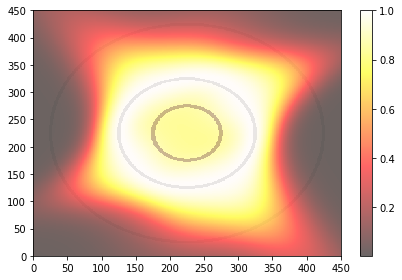

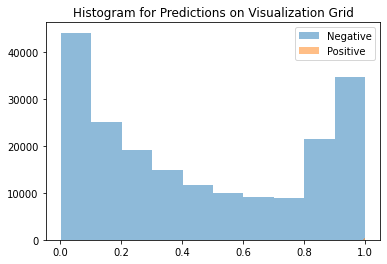

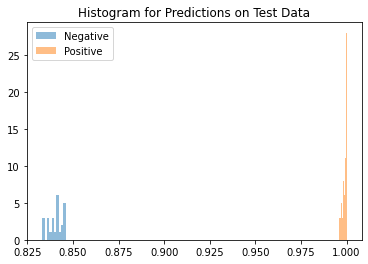

Average Difference between Positive and Negative Class: 0.1584644913673401


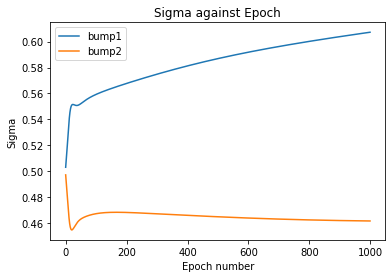

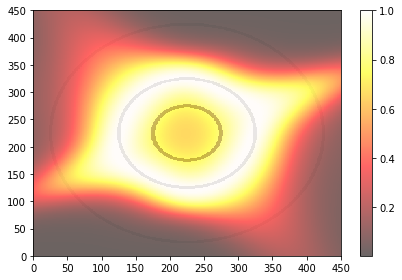

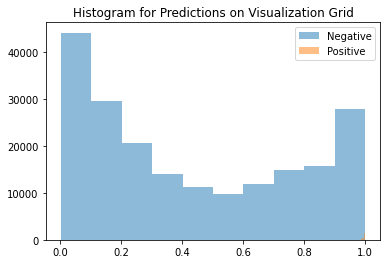

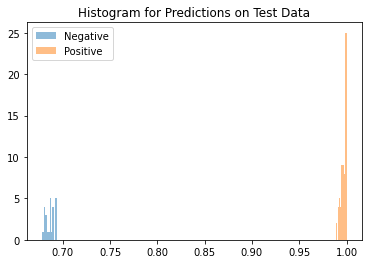

Average Difference between Positive and Negative Class: 0.31007784605026245


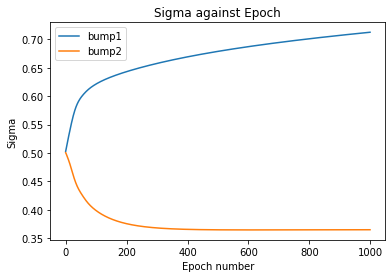

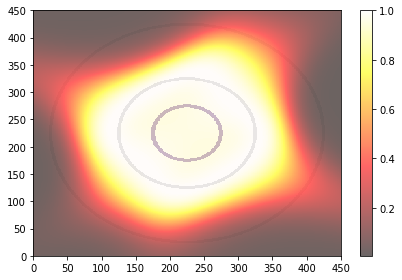

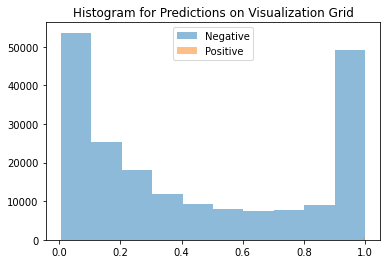

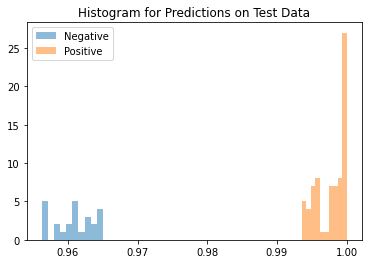

Average Difference between Positive and Negative Class: 0.036877989768981934


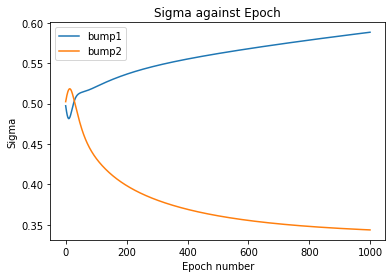

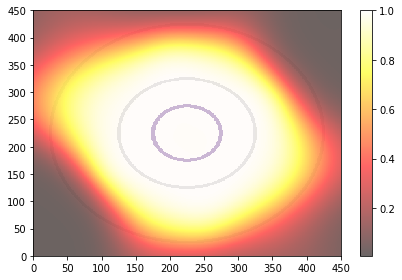

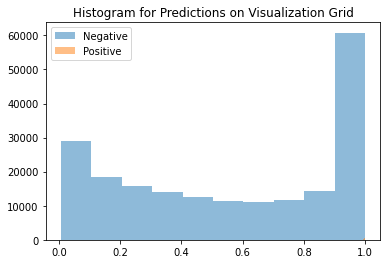

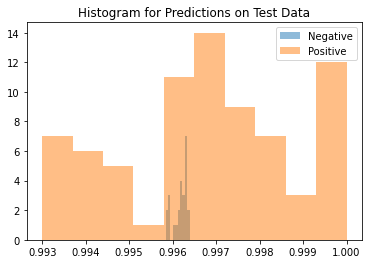

Average Difference between Positive and Negative Class: 0.0006487369537353516


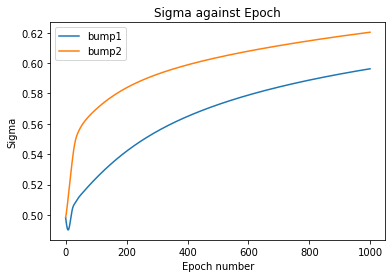

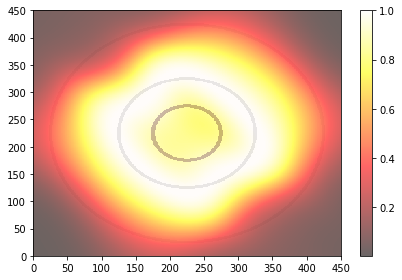

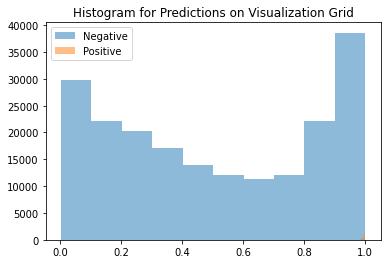

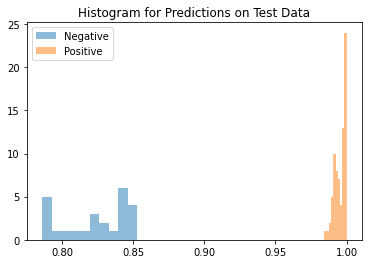

Average Difference between Positive and Negative Class: 0.17241960763931274


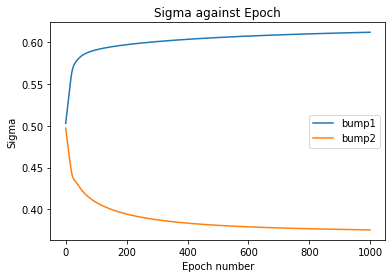

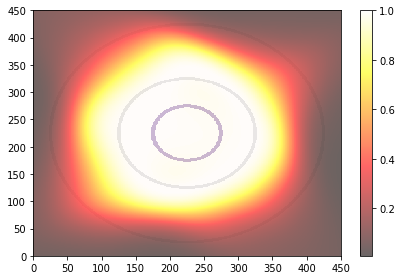

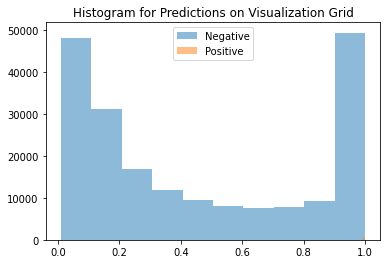

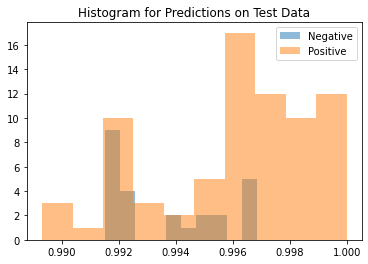

Average Difference between Positive and Negative Class: 0.0024596452713012695


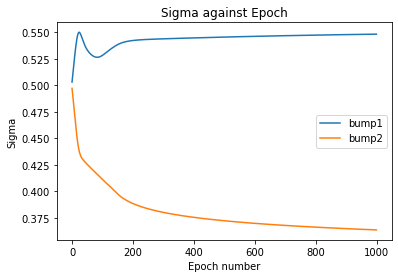

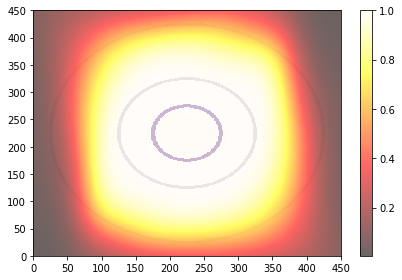

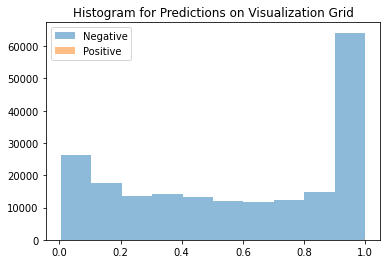

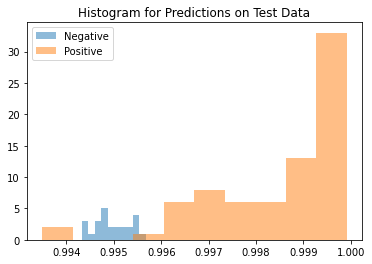

Average Difference between Positive and Negative Class: 0.003594517707824707


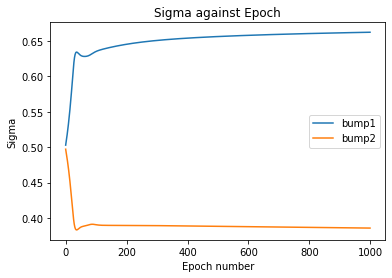

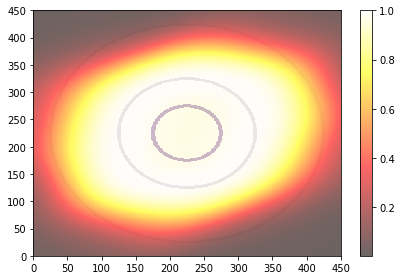

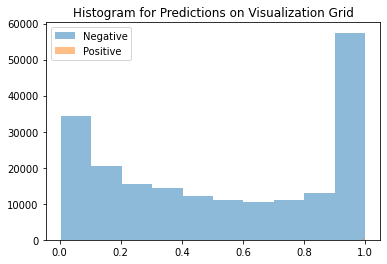

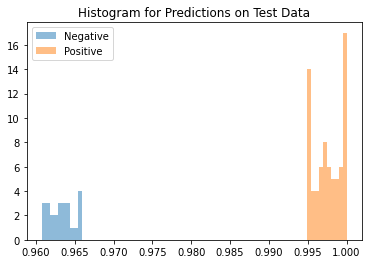

Average Difference between Positive and Negative Class: 0.034282684326171875
AUPR (Train): 0.9981173138894992+-0.008206438498080384
AUPR (Test): 0.9459791211081132+-0.1122574221051488
Average Distance between Means: 0.056778036057949066+-0.08265738934278488


([0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.962346277789985,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999],
 [0.9999999999999999,
  0.7352530953458688,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9994838494838494,
  0.9999999999999999,
  0.9999999999999999,
  0.5774095536332727,
  1.0,
  0.7814693112573528,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  0.9124077016008114,
  0.9999999999999999,
  0.9209904586861941,
  0.9925684521549183,
  0.9999999999999999],
 [0.16310018,
  -0.026362002,
  0.037641704,
  0.09058654,
  0.014817417,
  0.004863739,
  0.062157214,
  0.0026061535,
  -0.011543095,
  0.03112042,
  -0.022509336

In [17]:
# ES2b with MSE trainable sigma=0.5
separation = "ES"
bumped = "b"
sigma = 0.5
hidden_layers = 2
train = True     # train sigma. if NA, then False

verbose = 0      # can change this to 0 to suppress verbosity during training
plot = False
shuffle = False
val_split = 0.1

auprs_train = []
auprs_test = []
diff_means = []

# Train and Evaluate the Model
for i in range(20):
    
    # Create the model
    tf.keras.utils.set_random_seed(i)
    model = create_model(separation, activation=bumped, hidden_layers=hidden_layers,
                 sigma=sigma, train=train, loss='mse',
                 seed=i)
    
    # Train the model
    aupr_train, aupr_test, diff_mean = train_eval(model, X, y, x_test, y_test, 
               train=train, verbose=verbose, shuffle=shuffle, plot=plot,
               val_split=val_split, callbacks=[early_stopping], seed=i, diff=True)
    
    auprs_train.append(aupr_train)
    auprs_test.append(aupr_test)
    diff_means.append(diff_mean)
    
print(f"AUPR (Train): {np.mean(auprs_train)}+-{np.std(auprs_train)}")
print(f"AUPR (Test): {np.mean(auprs_test)}+-{np.std(auprs_test)}")
print(f"Average Distance between Means: {np.mean(diff_means)}+-{np.std(diff_means)}")
auprs_train, auprs_test, diff_means

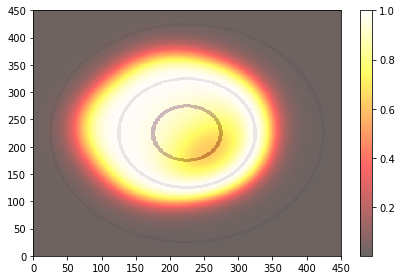

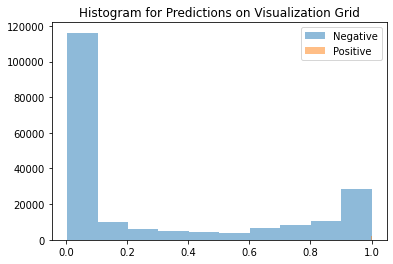

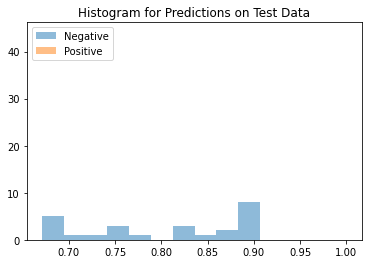

Average Difference between Positive and Negative Class: 0.19729822874069214


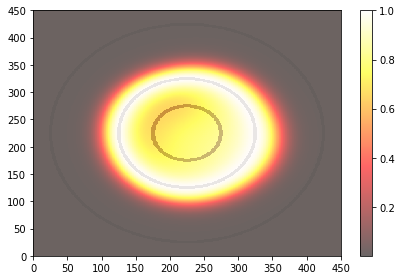

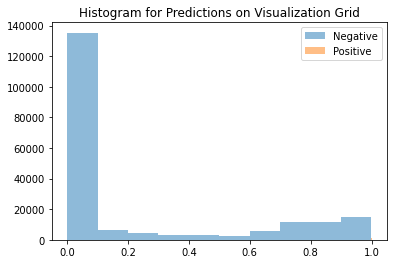

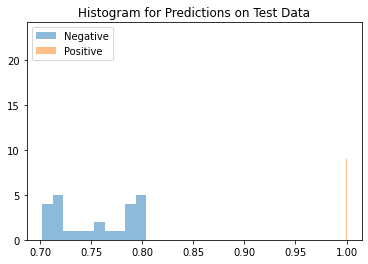

Average Difference between Positive and Negative Class: 0.24571722745895386


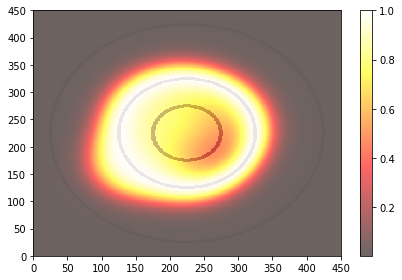

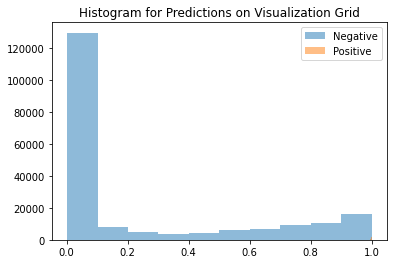

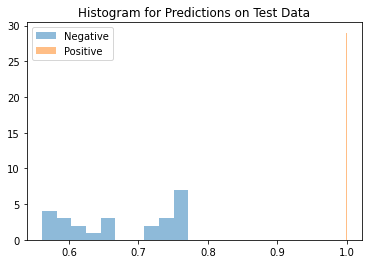

Average Difference between Positive and Negative Class: 0.32317423820495605


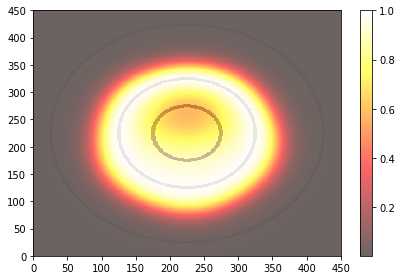

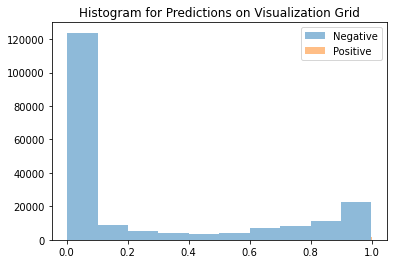

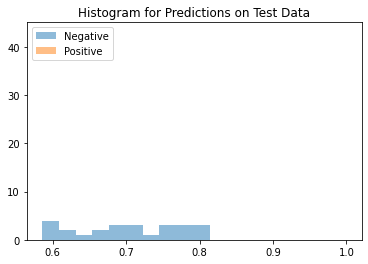

Average Difference between Positive and Negative Class: 0.2970554232597351


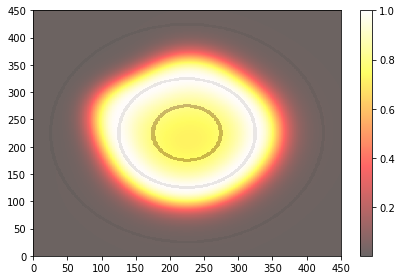

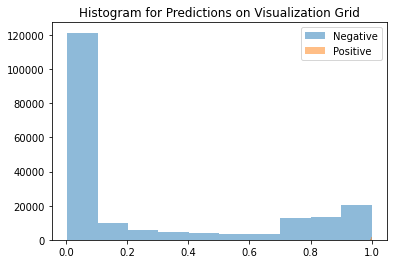

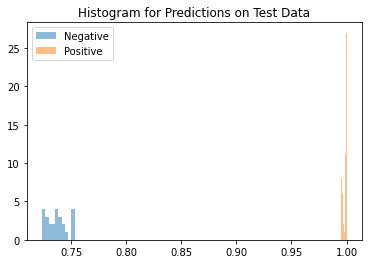

Average Difference between Positive and Negative Class: 0.2617260813713074


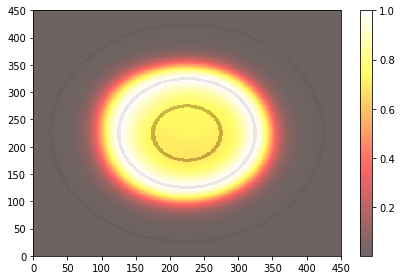

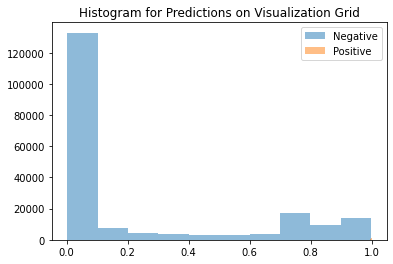

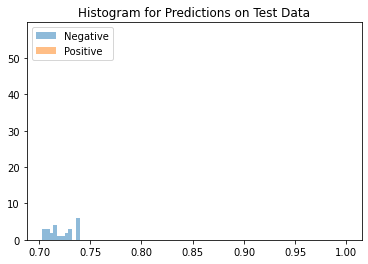

Average Difference between Positive and Negative Class: 0.27826279401779175


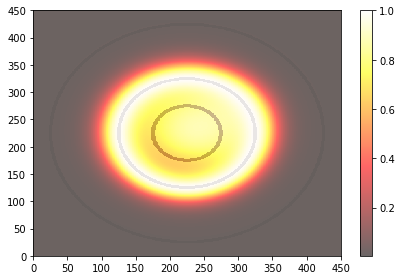

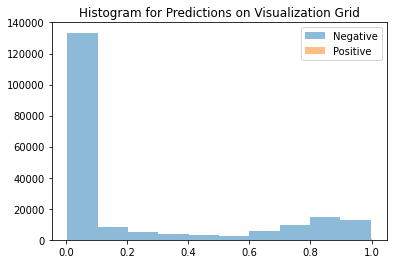

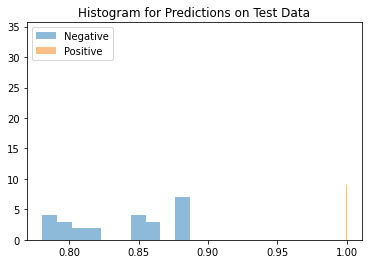

Average Difference between Positive and Negative Class: 0.16241872310638428


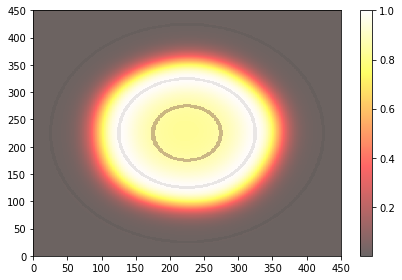

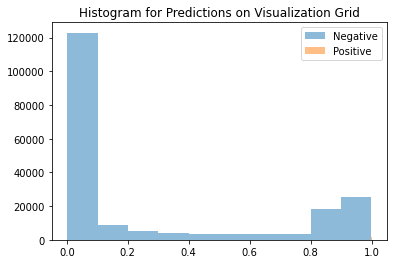

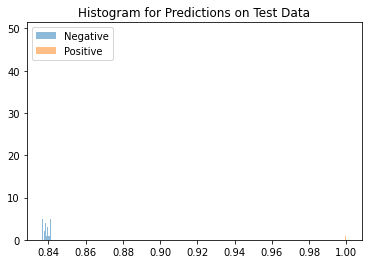

Average Difference between Positive and Negative Class: 0.160832941532135


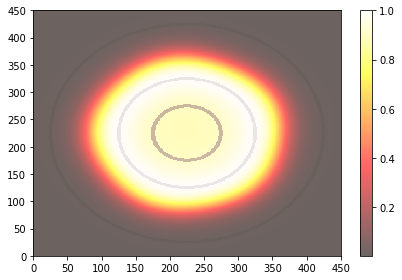

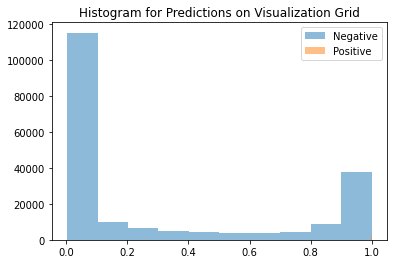

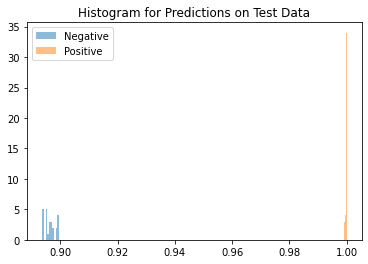

Average Difference between Positive and Negative Class: 0.1033179759979248


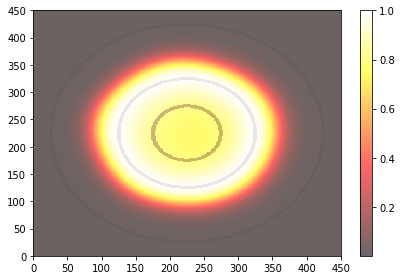

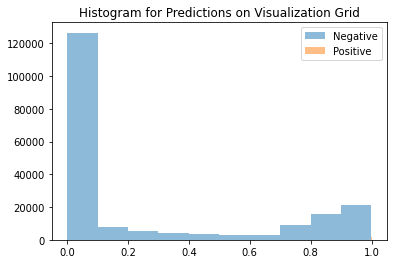

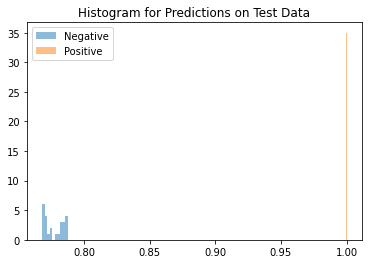

Average Difference between Positive and Negative Class: 0.22284597158432007


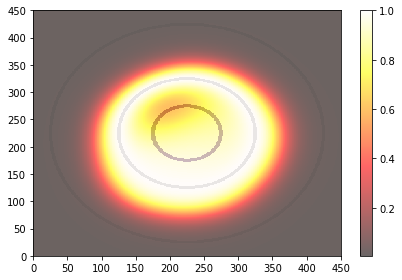

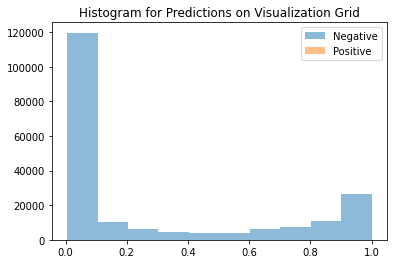

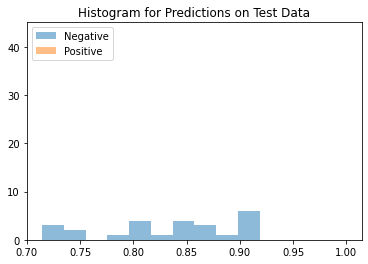

Average Difference between Positive and Negative Class: 0.16712266206741333


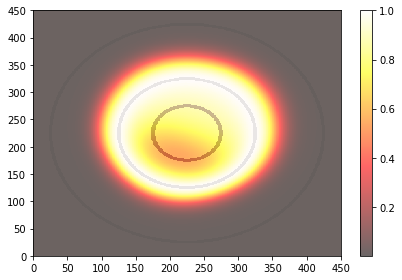

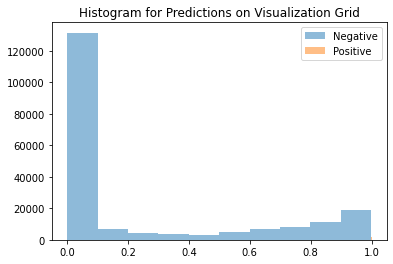

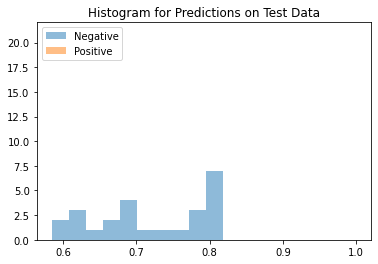

Average Difference between Positive and Negative Class: 0.278991162776947


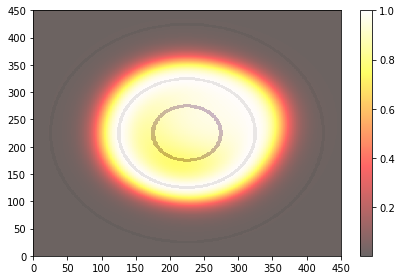

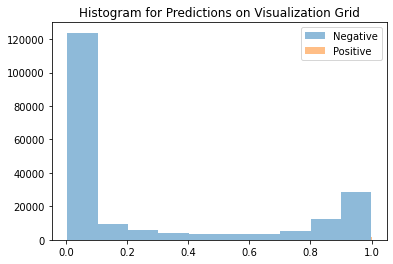

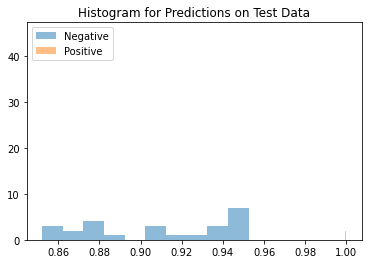

Average Difference between Positive and Negative Class: 0.09124988317489624


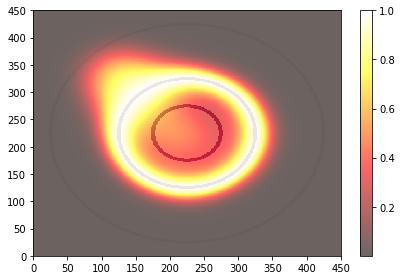

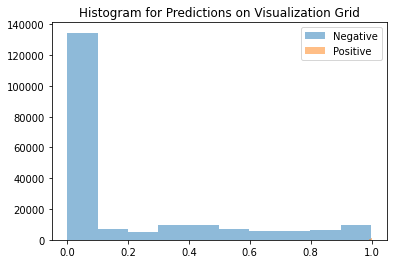

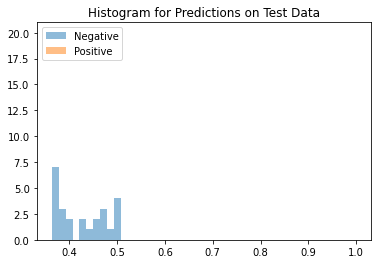

Average Difference between Positive and Negative Class: 0.5749828815460205


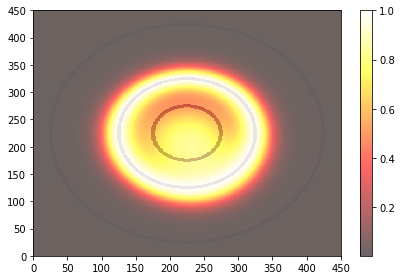

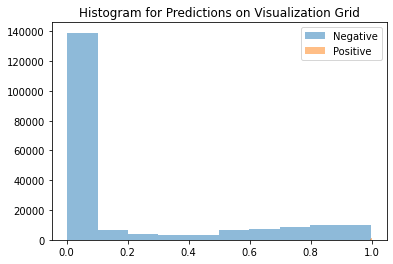

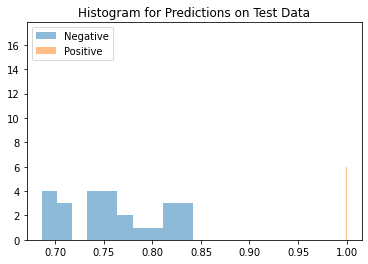

Average Difference between Positive and Negative Class: 0.24120062589645386


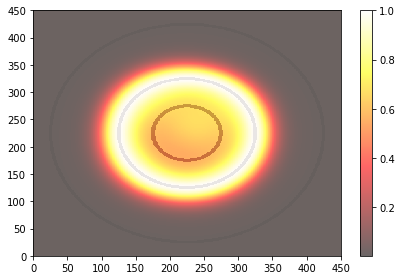

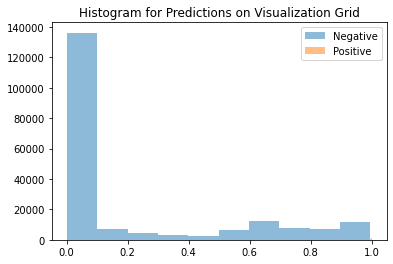

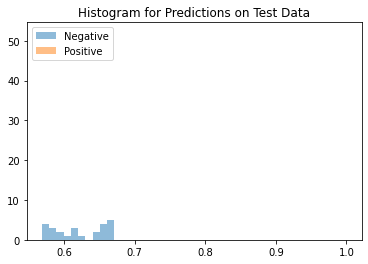

Average Difference between Positive and Negative Class: 0.3781452775001526


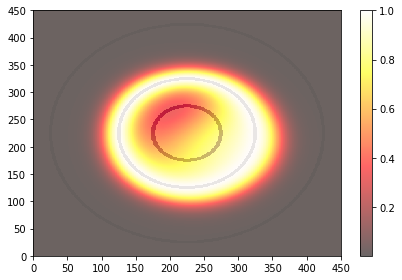

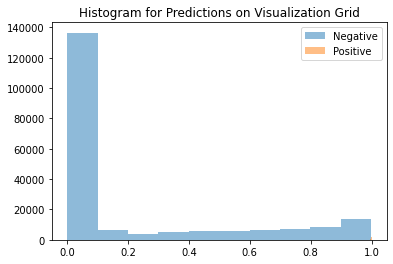

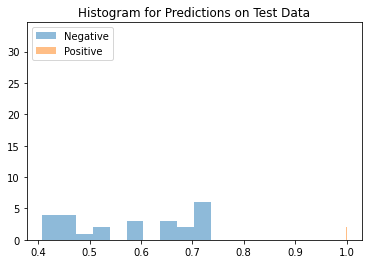

Average Difference between Positive and Negative Class: 0.4234180450439453


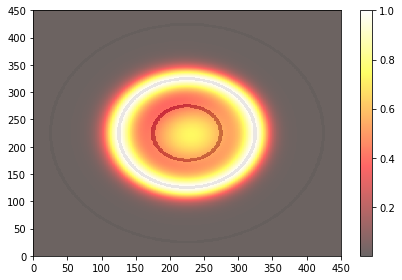

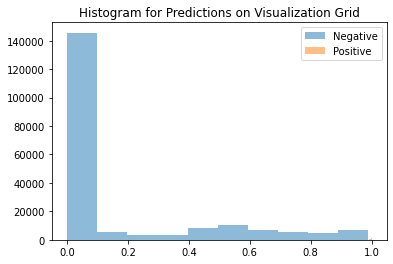

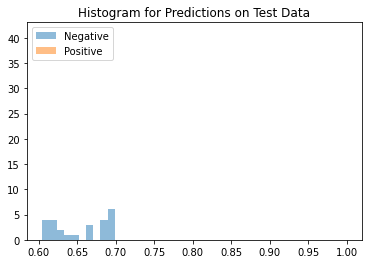

Average Difference between Positive and Negative Class: 0.3455713391304016


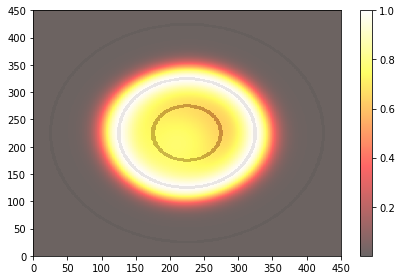

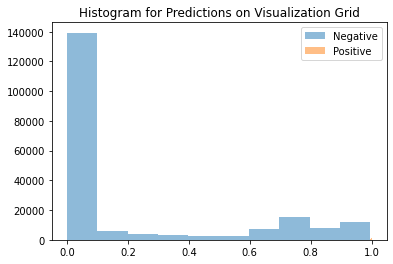

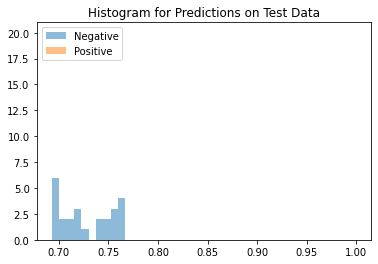

Average Difference between Positive and Negative Class: 0.2728114128112793


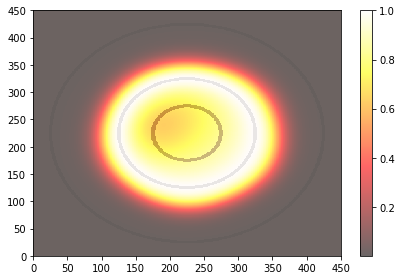

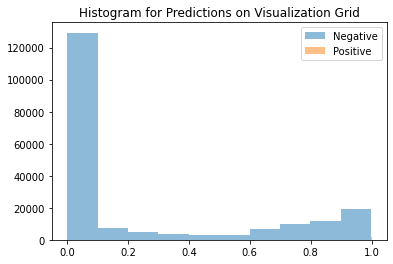

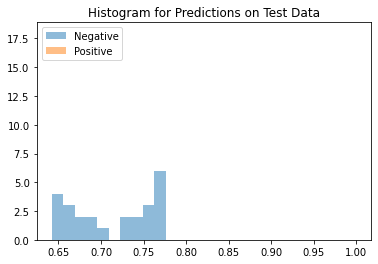

Average Difference between Positive and Negative Class: 0.2859029173851013
AUPR (Train): 1.0+-9.288792252416251e-17
AUPR (Test): 1.0+-7.850462293418876e-17
Average Distance between Means: 0.2656022906303406+-0.10962360352277756


([0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  0.9999999999999998,
  0.9999999999999999,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0],
 [1.0,
  1.0,
  0.9999999999999999,
  0.9999999999999998,
  0.9999999999999999,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  0.9999999999999999],
 [0.19729823,
  0.24571723,
  0.32317424,
  0.29705542,
  0.26172608,
  0.2782628,
  0.16241872,
  0.16083294,
  0.103317976,
  0.22284597,
  0.16712266,
  0.27899116,
  0.09124988,
  0.5749829,
  0.24120063,
  0.37814528,
  0.42341805,
  0.34557134,
  0.2728114,
  0.28590292])

In [18]:
# ES2r with BCE
separation = "ES"
bumped = "r"
sigma = 0.5
hidden_layers = 2
train = False    # train sigma. if NA, then False

verbose = 0      # can change this to 0 to suppress verbosity during training
plot = False
shuffle = False
val_split = 0.1

auprs_train = []
auprs_test = []
diff_means = []

# Train and Evaluate the Model
for i in range(20):
    
    # Create the model
    tf.keras.utils.set_random_seed(i)
    model = create_model(separation, activation=bumped, hidden_layers=hidden_layers,
                 sigma=sigma, train=train, loss='binary_crossentropy',
                 seed=i)
    
    # Train the model
    aupr_train, aupr_test, diff_mean = train_eval(model, X, y, x_test, y_test, 
               train=train, verbose=verbose, shuffle=shuffle, plot=plot,
               val_split=val_split, callbacks=[early_stopping], seed=i, diff=True)
    
    auprs_train.append(aupr_train)
    auprs_test.append(aupr_test)
    diff_means.append(diff_mean)
    
print(f"AUPR (Train): {np.mean(auprs_train)}+-{np.std(auprs_train)}")
print(f"AUPR (Test): {np.mean(auprs_test)}+-{np.std(auprs_test)}")
print(f"Average Distance between Means: {np.mean(diff_means)}+-{np.std(diff_means)}")
auprs_train, auprs_test, diff_means

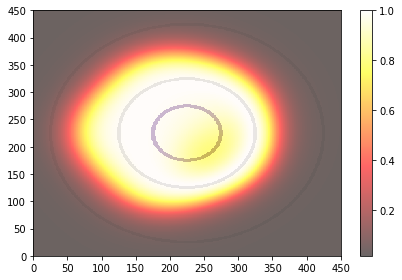

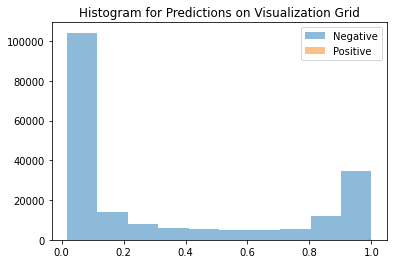

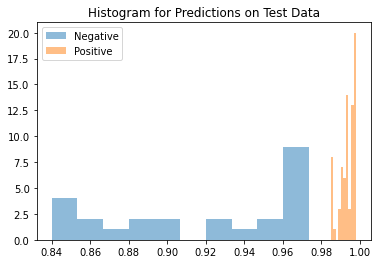

Average Difference between Positive and Negative Class: 0.0754857063293457


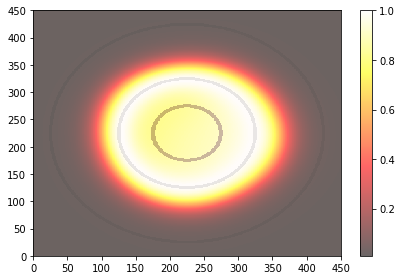

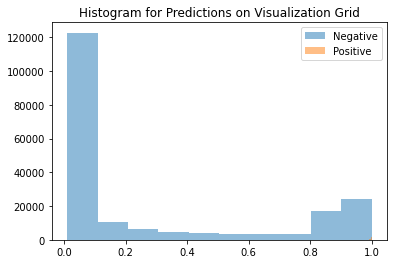

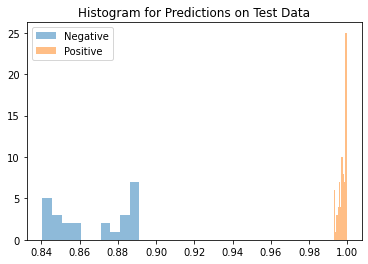

Average Difference between Positive and Negative Class: 0.1300169825553894


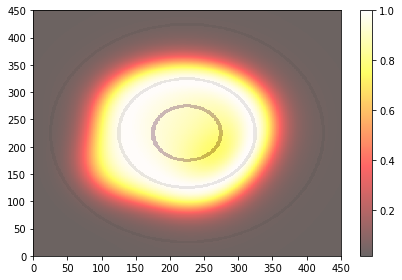

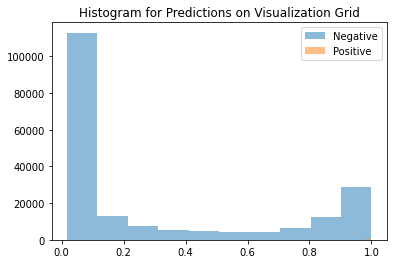

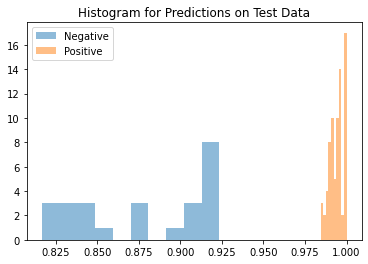

Average Difference between Positive and Negative Class: 0.11673659086227417


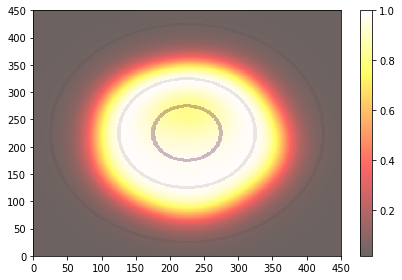

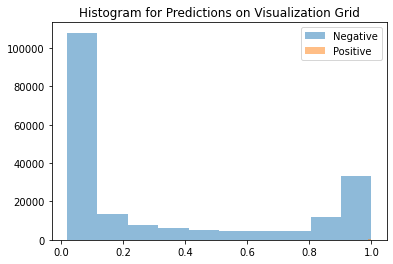

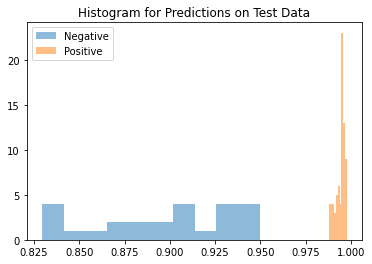

Average Difference between Positive and Negative Class: 0.09744584560394287


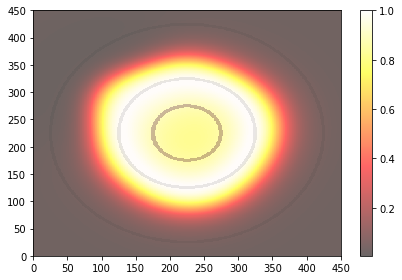

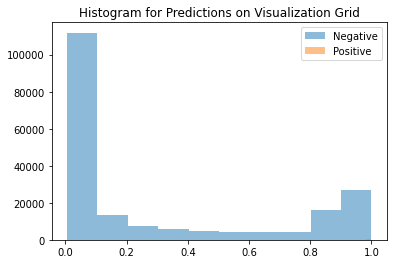

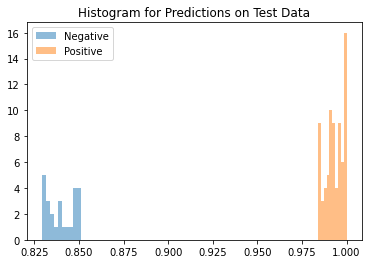

Average Difference between Positive and Negative Class: 0.15334933996200562


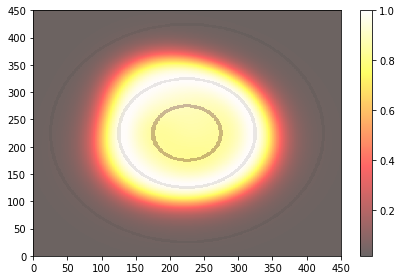

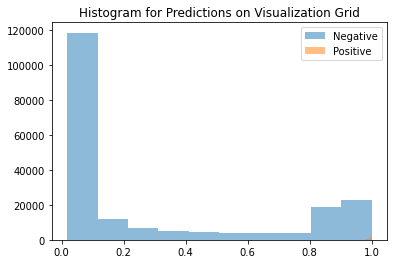

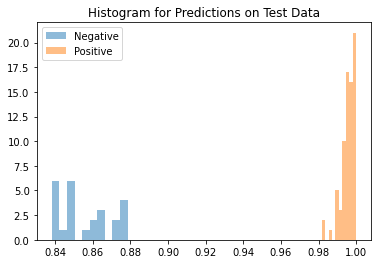

Average Difference between Positive and Negative Class: 0.13962620496749878


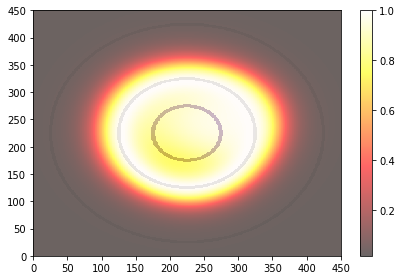

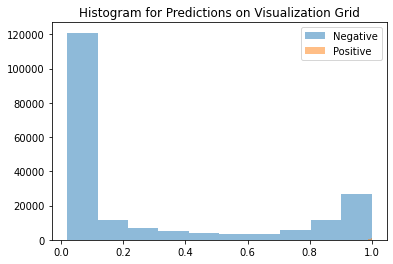

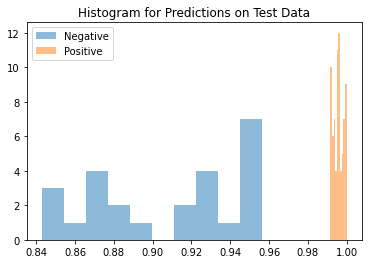

Average Difference between Positive and Negative Class: 0.08823299407958984


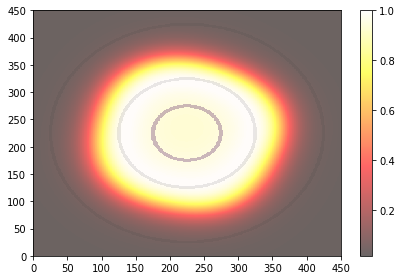

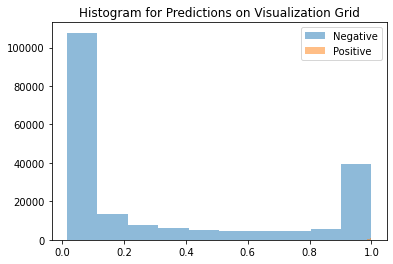

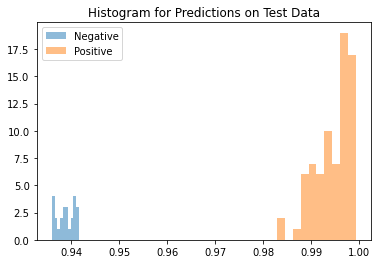

Average Difference between Positive and Negative Class: 0.055607736110687256


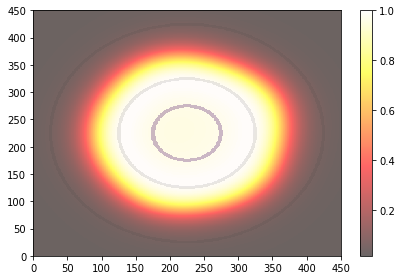

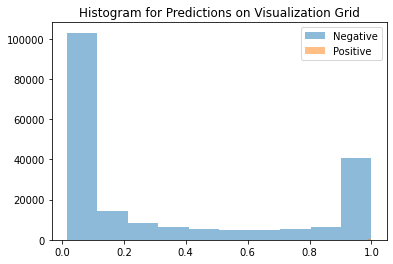

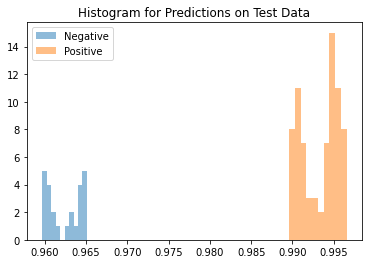

Average Difference between Positive and Negative Class: 0.030943989753723145


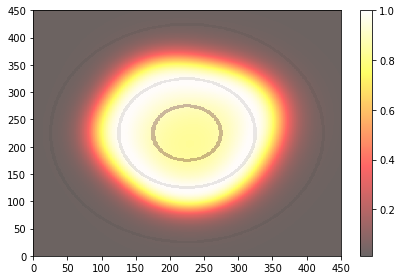

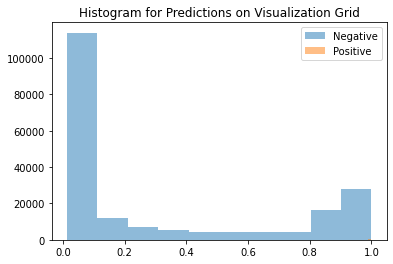

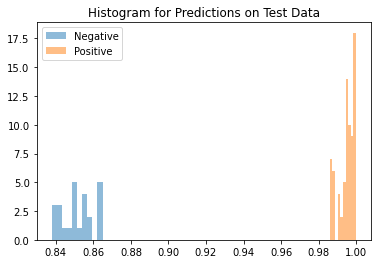

Average Difference between Positive and Negative Class: 0.14315074682235718


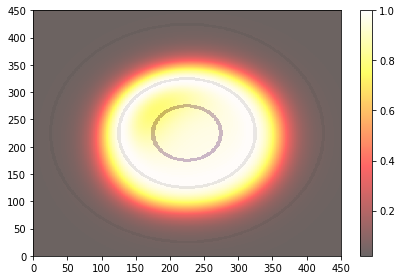

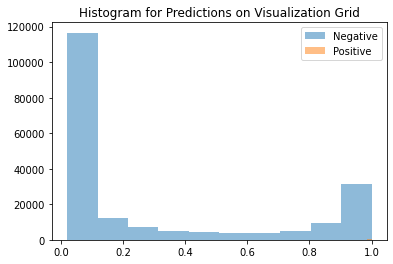

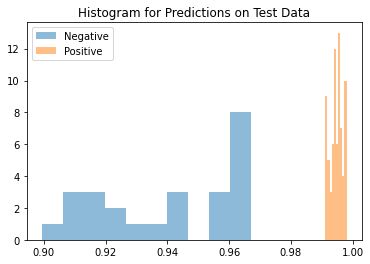

Average Difference between Positive and Negative Class: 0.05443531274795532


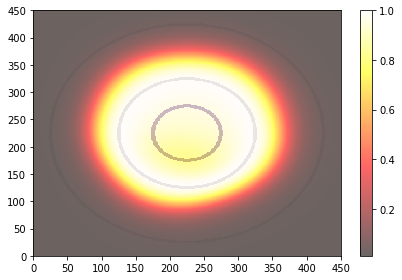

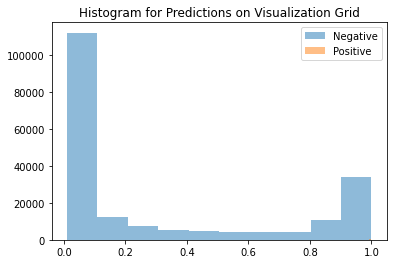

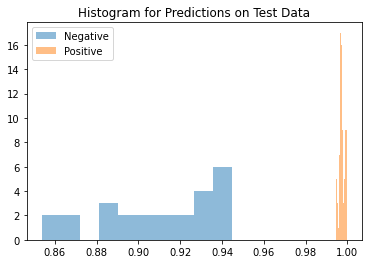

Average Difference between Positive and Negative Class: 0.08659529685974121


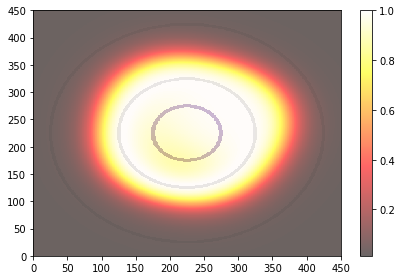

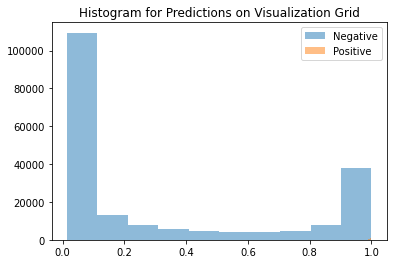

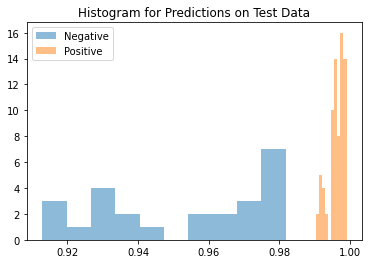

Average Difference between Positive and Negative Class: 0.04358720779418945


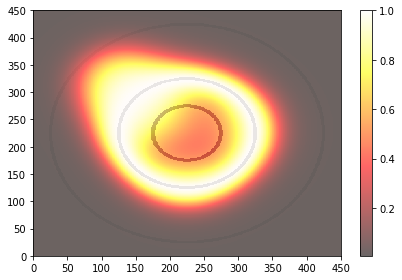

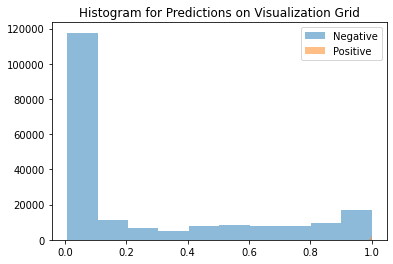

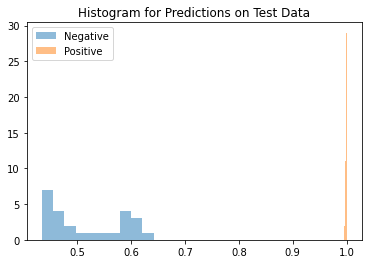

Average Difference between Positive and Negative Class: 0.4825173616409302


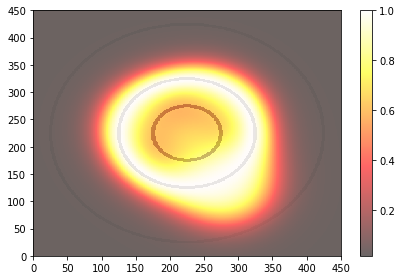

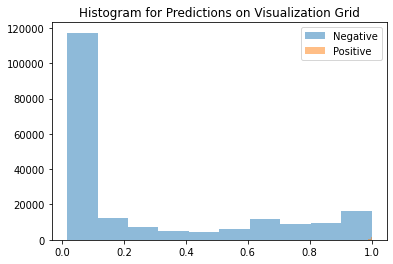

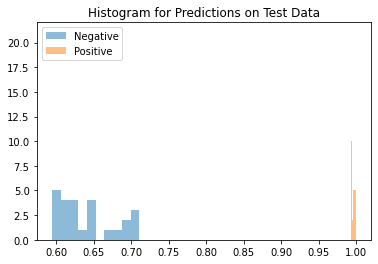

Average Difference between Positive and Negative Class: 0.3571431040763855


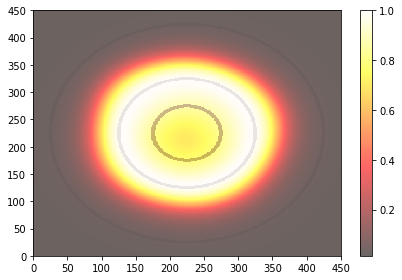

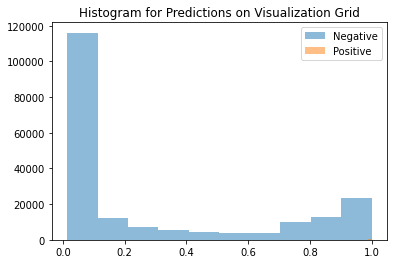

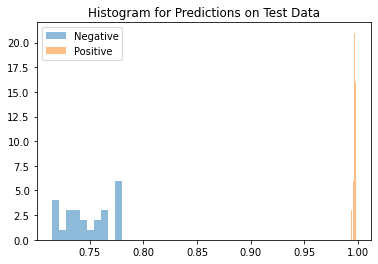

Average Difference between Positive and Negative Class: 0.24737119674682617


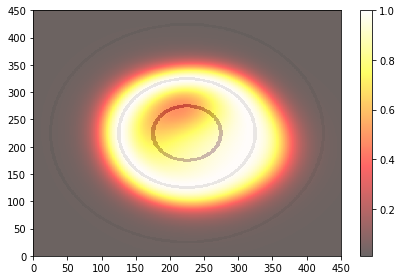

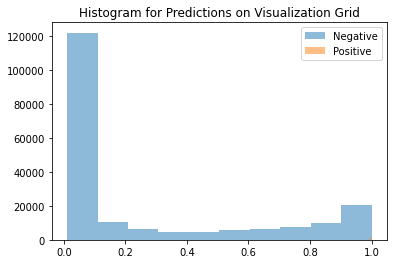

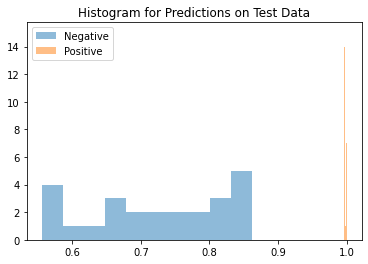

Average Difference between Positive and Negative Class: 0.2703705430030823


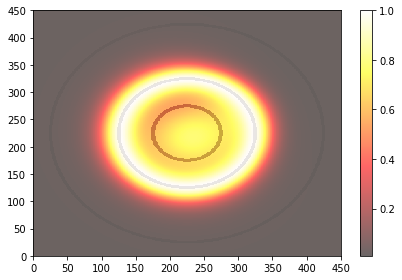

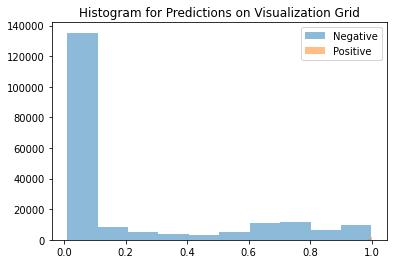

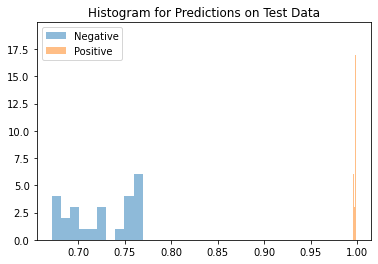

Average Difference between Positive and Negative Class: 0.27245646715164185


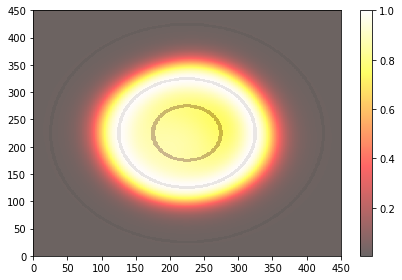

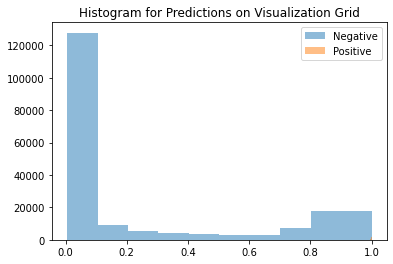

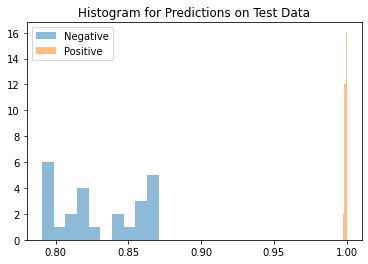

Average Difference between Positive and Negative Class: 0.16963201761245728


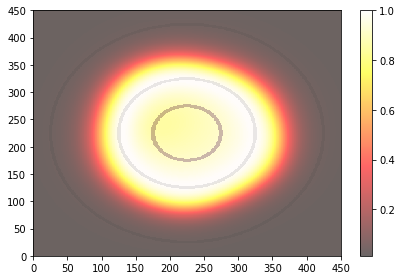

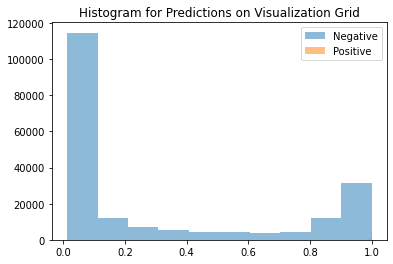

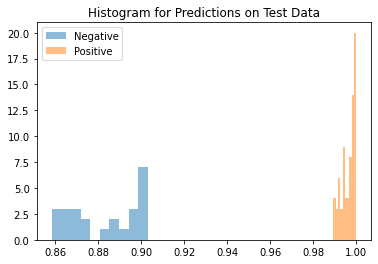

Average Difference between Positive and Negative Class: 0.11273825168609619
AUPR (Train): 1.0+-1.0532500405730103e-16
AUPR (Test): 1.0+-1.0821115497893178e-16
Average Distance between Means: 0.15637214481830597+-0.1128639280796051


([0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  0.9999999999999999],
 [0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999],
 [0.07548571,
  0.13001698,
  0.11673659,
  0.097445846,
  0.15334934,
  0.1396262,
  0.088232994,
  0.055607736,
  0.03094399,
  0.14315075,
  0.054435313,
  0.08

In [19]:
# ES2r with MSE
separation = "ES"
bumped = "r"
sigma = 0.5
hidden_layers = 2
train = False    # train sigma. if NA, then False

verbose = 0      # can change this to 0 to suppress verbosity during training
plot = False
shuffle = False
val_split = 0.1

auprs_train = []
auprs_test = []
diff_means = []

# Train and Evaluate the Model
for i in range(20):
    
    # Create the model
    tf.keras.utils.set_random_seed(i)
    model = create_model(separation, activation=bumped, hidden_layers=hidden_layers,
                 sigma=sigma, train=train, loss='mse',
                 seed=i)
    
    # Train the model
    aupr_train, aupr_test, diff_mean = train_eval(model, X, y, x_test, y_test, 
               train=train, verbose=verbose, shuffle=shuffle, plot=plot,
               val_split=val_split, callbacks=[early_stopping], seed=i, diff=True)
    
    auprs_train.append(aupr_train)
    auprs_test.append(aupr_test)
    diff_means.append(diff_mean)
    
print(f"AUPR (Train): {np.mean(auprs_train)}+-{np.std(auprs_train)}")
print(f"AUPR (Test): {np.mean(auprs_test)}+-{np.std(auprs_test)}")
print(f"Average Distance between Means: {np.mean(diff_means)}+-{np.std(diff_means)}")
auprs_train, auprs_test, diff_means

## ES2b fixed $\sigma=0.5$ Model Averaging

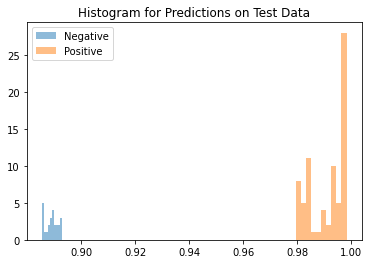

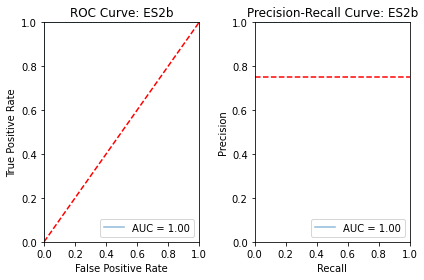

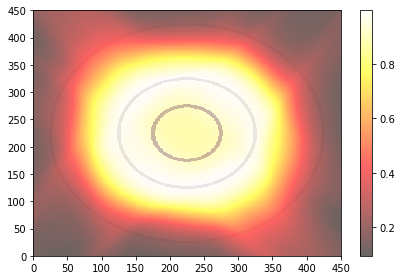

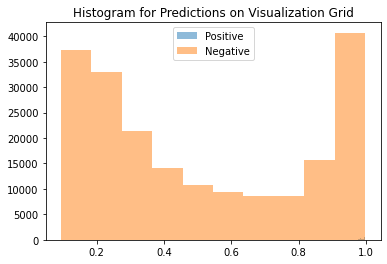

In [20]:
y_pred_list = [model(x_test) for model in models]
y_pred = tf.reduce_mean(y_pred_list, axis=0).numpy()


plt.title("Histogram for Predictions on Test Data")
y_pred_pos = y_pred[y_test == 1]
y_pred_neg = y_pred[y_test == 0]
plt.hist(y_pred_neg, bins=10, label="Negative", alpha=0.5)
plt.hist(y_pred_pos, bins=10, label="Positive", alpha=0.5)
plt.legend()
plt.show()


fpr, tpr, threshold = metrics.roc_curve(y_test, y_pred, pos_label=1)
roc_auc = metrics.auc(fpr, tpr)

precision, recall, threshold = metrics.precision_recall_curve(
    y_test, y_pred, pos_label=1)
pr_auc = metrics.auc(recall, precision)


fig, axs = plt.subplots(nrows=1, ncols=2)

axs[0].plot(fpr, tpr, alpha=0.5,
         label=f'AUC = %0.2f' % roc_auc)
axs[1].plot(recall, precision, alpha=0.5,
         label=f'AUC = %0.2f' % pr_auc)

axs[0].set_title(f'ROC Curve: {models[0].name}')
axs[0].legend(loc = 'lower right')
axs[0].plot([0, 1], [0, 1],'r--')
axs[0].set_xlim([0, 1])
axs[0].set_ylim([0, 1])
axs[0].set_ylabel('True Positive Rate')
axs[0].set_xlabel('False Positive Rate')

axs[1].set_title(f'Precision-Recall Curve: {models[0].name}')
axs[1].legend(loc = 'lower right')
axs[1].axhline(y_test.sum()/len(y_test), linestyle='--', color='r')
axs[1].set_xlim([0, 1])
axs[1].set_ylim([0, 1])
axs[1].set_ylabel('Precision')
axs[1].set_xlabel('Recall')

plt.tight_layout()
plt.show()

import csv
outcsv = open("heatmap_predictions.csv", mode="a")
writer = csv.writer(outcsv, delimiter=',', lineterminator='\n')

y_pred_list = [model(data_viz) for model in models]
y_pred = tf.reduce_mean(y_pred_list, axis=0).numpy()

transparency = 0.7
plt.pcolormesh(radius2, cmap="YlGn", alpha=transparency)
plt.tight_layout()
plt.pcolormesh(radius1, cmap="Greys", alpha=transparency)
plt.tight_layout()
plt.pcolormesh(radius05, cmap="RdPu", alpha=transparency)
plt.tight_layout()

y_im = y_pred.reshape(grid, grid)
norm = matplotlib.colors.Normalize(y_pred.min(), y_pred.max())
plt.pcolormesh(y_im, cmap="hot", norm=norm, alpha=0.6)
plt.colorbar()
plt.tight_layout()
plt.show()

plt.title("Histogram for Predictions on Visualization Grid")
y_pred_pos = y_pred[radius1.reshape(-1) == 1]
y_pred_neg = y_pred[radius1.reshape(-1) == 0]
plt.hist(y_pred_pos, bins=10, label="Positive", alpha=0.5)
plt.hist(y_pred_neg, bins=10, label="Negative", alpha=0.5)
plt.legend()
plt.show()

writer.writerow(np.hstack([[models[0].name + "_ensemble"], y_pred.squeeze()]))
outcsv.close()

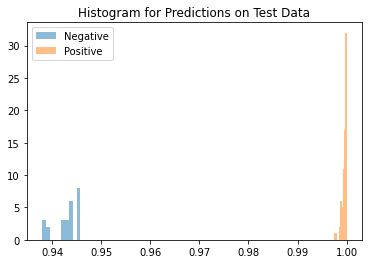

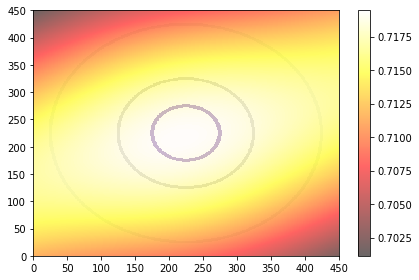

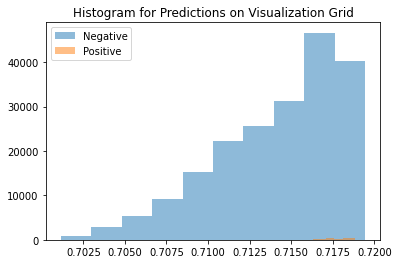

In [21]:
# Weight averaging

weights = [model.get_weights() for model in models]

new_weights = list()

for weights_list_tuple in zip(*weights):
    if type(weights_list_tuple[0]) is np.float32:
        new_weights.append(np.mean(weights_list_tuple))
    else:
        new_weights.append(
            np.array([np.array(w).mean(axis=0)\
                for w in zip(*weights_list_tuple)]))

model_ensemble = create_model(separation, activation=bumped, hidden_layers=hidden_layers,
                 sigma=sigma, train=train, loss='binary_crossentropy',
                 seed=0, name_suffix="_weight_avg")   

model_ensemble.set_weights(new_weights)

get_metrics(X, y, model_ensemble, plot=plot)
get_metrics(x_test, y_test, model_ensemble, plot=plot)

plt.title("Histogram for Predictions on Test Data")
y_pred = model(x_test).numpy()
y_pred_neg = y_pred[y_test == 0]
y_pred_pos = y_pred[y_test == 1]
plt.hist(y_pred_neg, bins=10, label="Negative", alpha=0.5)
plt.hist(y_pred_pos, bins=10, label="Positive", alpha=0.5)
plt.legend()
plt.show()

viz_boundary(data_viz, model_ensemble, grid=grid)